This Ipython notebook first loads an individual adcp in and then calculates and plots all kinds of things
- heat
- surfer plots

In [2]:
from paths import *
import scipy.io as sio
import numpy as np
import datetime
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import math as m
from functions import *
from pytides2.tide import Tide
import gsw
import matplotlib as mpl
import cmcrameri as ccm
import matplotlib.patches as mpatches



# 

# Importing both

## Upper meters (300KHz)

Number of samples:  18535
Number of bins:  36
Bin size: 2 m
Number of observations per day: 48.0
first ping:  2018-05-27 11:56:00
last ping:  2019-06-17 14:55:59
sampling interval: 29.98 minutes
Mounting depth: 55
Number of bins after removing above water surface: 36
Removing approx to 10 percent, or upper bins based on inspections: 2 bins
Final number of bins:  24
Shallowest bin:  50.8 m

 Rotating velocities
Using PCA to rotate velocities
Components [[ 0.90852161  0.41783786]
 [ 0.41783786 -0.90852161]]
Explained Variance [9336.43731984 3827.99749155]
Degrees of components 25, -65
Mean of X_pca [-29.  -11.9]
Mean of X [-31.3  -1.4]
Mean of Magnitude of X 96.54 mm/s
Mean of Magnitude of X_pca 96.54 mm/s



 Calculating tides and removing them
Along
Std of original data:  70.28
Std of prediction: 46.49
Across
Std of original data:  39.74
Std of prediction: 9.42
Variance of original data: 4942.66
Variance of prediction: 2161.27
Variance of prediction as percentage of original data: 43.7

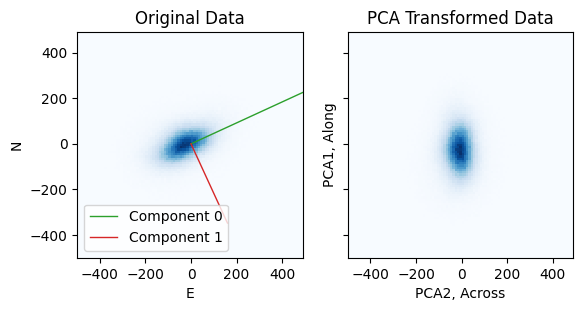

In [3]:
from velocity_preprocessing_functions import *

f300 = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Data/Moorings/20190612_ADCP_GF10/ADCP300.mat"

ds_velo_300, _, df_cons300, _, _, my_prediction_along_300, _, _, _, ds_velo_no_outlier_removal_300 = open_and_proces_mat_adcp(f300)


In [4]:
df_cons300
print("Total amplitude tide : ", df_cons300['Velocity amplitude [mm/s]'].sum().round(2))
df_cons300.head(15).round(2).style.background_gradient(cmap='Reds', subset=['%'])

Total amplitude tide :  54.54


,Velocity amplitude [mm/s],Phase [deg],%
M2,7.610000,24.430000,13
Mf,6.610000,311.740000,12
MSF,5.220000,31.230000,9
Mm,3.270000,284.500000,6
S2,3.150000,43.070000,5
MK3,2.250000,268.030000,4
T2,2.160000,36.620000,3
O1,2.030000,169.530000,3
K2,1.900000,144.250000,3
R2,1.790000,24.300000,3


Number of samples:  9266
Number of bins:  40
Bin size: 16 m
Number of observations per day: 24.0
first ping:  2018-05-27 13:00:00
last ping:  2019-06-17 13:59:59
sampling interval: 59.98 minutes
Mounting depth: 532
Number of bins after removing above water surface: 40
Removing approx to 10 percent, or upper bins based on inspections: 2 bins
Final number of bins:  30
Shallowest bin:  507.3 m

 Rotating velocities
Using PCA to rotate velocities
Components [[ 0.85241584  0.52286445]
 [ 0.52286445 -0.85241584]]
Explained Variance [3029.35308202 1267.86551065]
Degrees of components 32, -58
Mean of X_pca [ 8.  -1.7]
Mean of X [5.9 5.7]
Mean of Magnitude of X 55.42 mm/s
Mean of Magnitude of X_pca 55.42 mm/s



 Calculating tides and removing them
Along
Std of original data:  41.16
Std of prediction: 38.74
Across
Std of original data:  17.58
Std of prediction: 4.90
Variance of original data: 1694.88
Variance of prediction: 1501.02
Variance of prediction as percentage of original data: 88.56%
T

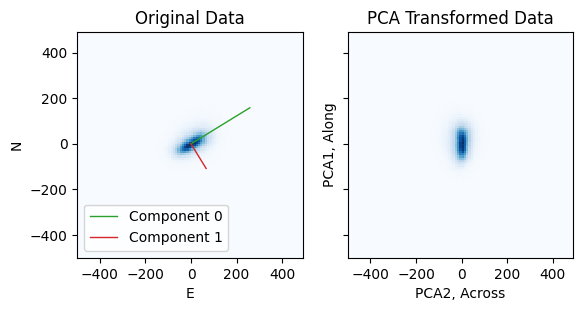

In [5]:
ds_velo_75, _, df_cons75, _, _, pred_75, _, _, _, ds_velo_no_outlier_removal_75 = open_and_proces_mat_adcp(f75)
print("Total amplitude tide : ", df_cons75['Velocity amplitude [mm/s]'].sum().round(2))


<xarray.DataArray 'Along_res' ()>
array(-69.34891114)
<xarray.DataArray 'Along_res' ()>
array(-43.61447405)


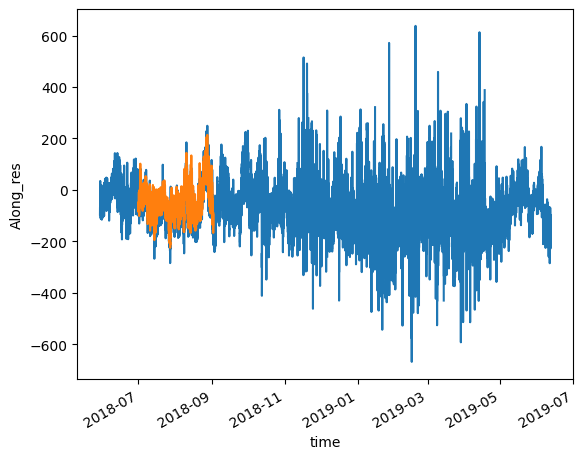

In [6]:
ds_velo_300.Along_res.sel(z=slice(20,None)).mean(dim='z').plot()
print(ds_velo_300.Along_res.sel(z=slice(20,None)).mean())


ds_velo_300.Along_res.sel(z=slice(30,None)).sel(time=slice('2018-07-01','2018-09-01')).mean(dim='z').plot()
print(ds_velo_300.Along_res.sel(z=slice(30,None)).sel(time=slice('2018-07-01','2018-09-01')).mean())

<xarray.DataArray 'Across_res' ()>
array(-9.83919861)
<xarray.DataArray 'Across_res' ()>
array(-34.16438336)
<xarray.DataArray 'Across_res' ()>
array(40.8508733)


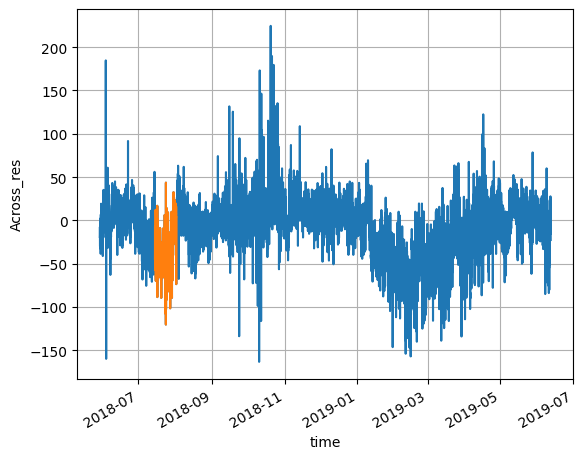

<xarray.DataArray 'Across_res' ()>
array(-34.16438336)


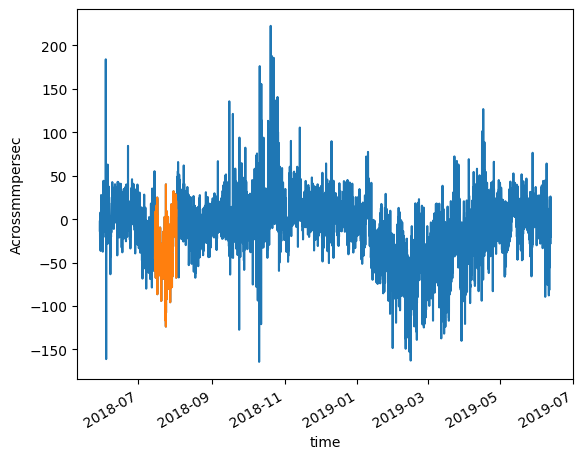

In [7]:


ds_velo_75.Across_res.sel(z=slice(200,50)).mean(dim='z').plot()
print(ds_velo_75.Across_res.sel(z=slice(200,50)).mean())

ds_velo_75.Across_res.sel(z=slice(200,50)).sel(time=slice('2018-07-15','2018-08-01')).mean(dim='z').plot()
print(ds_velo_75.Across_res.sel(z=slice(200,50)).sel(time=slice('2018-07-15','2018-08-01')).mean())
print(ds_velo_75.Across_res.sel(z=slice(200,50)).sel(time=slice('2018-07-15','2018-08-01')).std())

plt.grid()
plt.show()
ds_velo_75.Acrossmmpersec.sel(z=slice(200,50)).mean(dim='z').plot()
ds_velo_75.Acrossmmpersec.sel(z=slice(200,50)).sel(time=slice('2018-07-15','2018-08-01')).mean(dim='z').plot()
print(ds_velo_75.Across_res.sel(z=slice(200,50)).sel(time=slice('2018-07-15','2018-08-01')).mean())

# ds_velo_75.Along_res.sel(z=slice(None,350)).sel(time=slice('2018-07-01','2018-10-01')).std(dim='z').plot()
# print(ds_velo_75.Along_res.sel(z=slice(None,350)).sel(time=slice('2018-07-01','2018-10-01')).std())



# Some plotting

In [8]:
df_velo_both = xr.merge([ds_velo_300, ds_velo_75], join='outer')

df_velo_outliers = xr.merge([ds_velo_no_outlier_removal_300, ds_velo_no_outlier_removal_75], join='outer')

# df_velo_both.to_netcdf(f"intermediate/ds_velo_both_20230706.nc")

In [9]:
# make af figure width = 16, height = 6
# use cmo balance colormap
import cmocean as cmo
cmap = cmo.cm.balance

# fig, ax = plt.subplots(2,1, figsize=(16,10), sharex=True, sharey=True)
# fig.suptitle('Residual velocity in along, and across fjord direction', fontsize=16)
# df_velo_both.Along_res.resample(time='1D').mean().plot(y='z', robust=True, ax=ax[0], cmap=cmap)
# df_velo_both.Across_res.resample(time='1D').mean().plot(y='z', robust=True, ax=ax[1], cmap=cmap)

# plt.gca().invert_yaxis()


In [10]:
# # make af figure width = 16, height = 10
# fig, ax = plt.subplots(2,1, figsize=(16,6), sharex=True, sharey=True)
# fig.suptitle('Current in North and East direction, no outlier removal', fontsize=16)
# df_velo_outliers.SerEmmpersec.resample(time='1D').mean().plot(y='z', robust=True, ax=ax[0], cmap='RdBu_r')
# df_velo_outliers.SerNmmpersec.resample(time='1D').mean().plot(y='z', robust=True, ax=ax[1], cmap='RdBu_r')
# plt.gca().invert_yaxis()



In [11]:
# (xlims[1] - xlims[0])

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_70850/1820653553.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


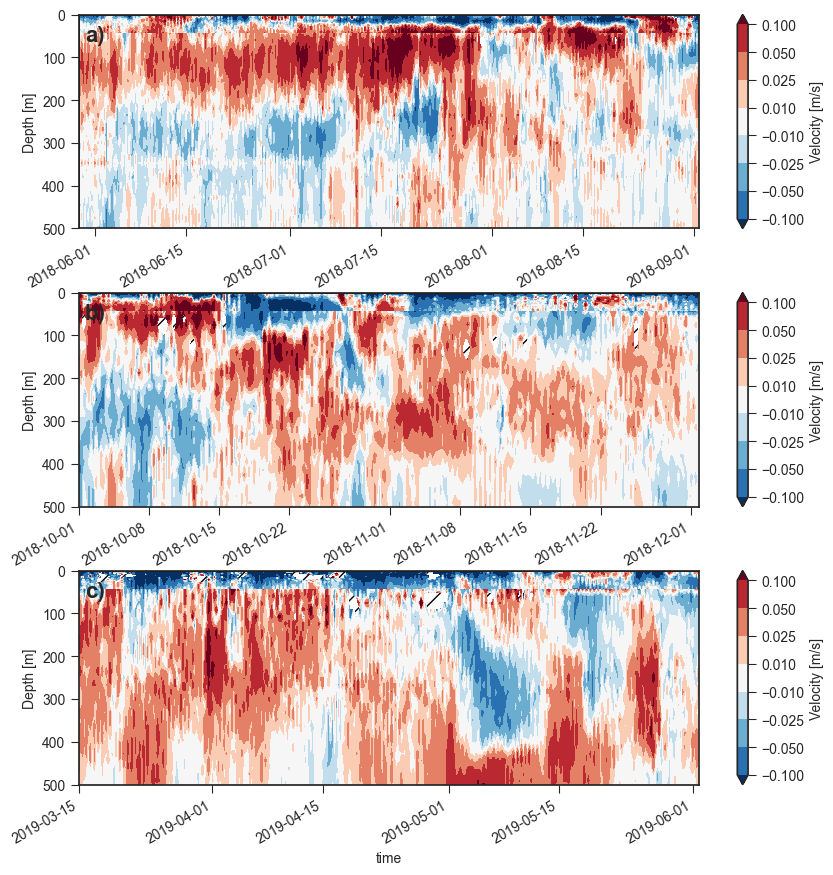

In [12]:
# stylesheet to seaborn-ticks
plt.style.use('seaborn-ticks')


levels = [-100, -50, -25, -10, 10, 25, 50, 100]
levels = np.array(levels)/1000.
cmap = 'RdBu_r'
zlim = [500, 0]
xlims =[["2018-05-25","2018-09-01"],
        ["2018-10-01","2018-12-01"],
        ["2019-03-15", "2019-06-01"],
        ]
        


fig, ax = plt.subplots(3,1, figsize=(10,10), sharex=False, sharey=True)
# if min(zlim) <60:
for i in range(len(ax)):
    ts = xlims[i] #timespan
    (ds_velo_300/1000).sel(time=slice(ts[0], ts[1])).resample(time='6H').mean().Along_res.plot.contourf(y='z', robust=True, ax=ax[i], cmap=cmap, levels=levels,  add_colorbar=False,)
    (ds_velo_75/1000).sel(time=slice(ts[0], ts[1])).resample(time='6H').mean().Along_res.plot.contourf(y='z', robust=True, ax=ax[i], cmap=cmap, levels=levels,cbar_kwargs={'label': 'Velocity [m/s]'}, extend='both')

for i in range(len(ax)): 
    # ax[i].scatter(y=34.5, color='white', linestyle='dashed') # add horizontal line
    ax[i].set_ylabel('Depth [m]')
plt.gca().invert_yaxis()
plt.ylim(zlim)
# ax[1].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
# ax[1].xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
ax[1].set_xlabel('')

# remove all ticks and labels from top plot
# ax[0].tick_params(labelbottom=False, bottom=False, top=False, labeltop=False)
ax[0].set_xlabel('')
# remove hspace
plt.subplots_adjust(hspace=0.3)

def get_background_patch(ax):
    import matplotlib.patches as patches
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    xy = (xmin,ymin)
    width = xmax - xmin
    height = ymax - ymin
    p = patches.Rectangle(xy, width, height, hatch='//', fill=None, zorder=-10)
    return p
for single_ax in ax: single_ax.add_patch(get_background_patch(single_ax))

# add a) b) c) labels
for i, label in enumerate(['a)', 'b)', 'c)']):
    ax[i].text(0.01, 0.95, label, transform=ax[i].transAxes, fontsize=16, fontweight='bold', va='top')

# plt.savefig(f'{figpath}/velocity_surfer/Along_velo_diff_times.png', dpi=600, bbox_inches='tight')

plt.show()



In [13]:
# # stylesheet to seaborn-ticks
# plt.style.use('seaborn-ticks')

# cmap = 'RdBu_r'
# # ax.set_facecolor("yellow")
# zlim = [497, 100]
# interval_hour= 1
# start_time='2019-04-01'
# end_time='2019-06-01'

# levels = np.linspace(-125, 125, 51)/1000.

# fig, ax = plt.subplots(1,1, figsize=(10,6), sharex=True, sharey=True)
# # fig.suptitle('Residual velocity in along fjord direction', fontsize=16)
# # if min(zlim) <60:
#     # (ds_velo_300/1000).isel(time=slice(1,None,interval_hour*2)).Along_res.plot.contourf(y='z', robust=True, ax=ax, cmap=cmap, levels=levels,  add_colorbar=False,)
# (ds_velo_75/1000).isel(time=slice(None,None,interval_hour)).Along_res.plot.contourf(y='z', robust=True, ax=ax, cmap=cmap, levels=levels,cbar_kwargs={'label': 'Velocity [m/s]'})


# # ax.axhline(y=division_adcps, color='white', linestyle='-')

# plt.gca().invert_yaxis()
# # plt.ylim(zlim)

# ax.set_title('')
# ax.xaxis.set_minor_locator(mdates.DayLocator(interval=1))
# ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
# ax.set_xlabel('')
# ax.set_ylabel('Depth [m]')
# ax.set_xlim([pd.to_datetime(start_time), pd.to_datetime(end_time)])



# # get data you will need to create a "background patch" to your plot
# def get_background_patch(ax):
#     import matplotlib.patches as patches
#     xmin, xmax = ax.get_xlim()
#     ymin, ymax = ax.get_ylim()
#     xy = (xmin,ymin)
#     width = xmax - xmin
#     height = ymax - ymin
#     p = patches.Rectangle(xy, width, height, hatch='//', fill=None, zorder=-10)
#     return p
# ax.add_patch(get_background_patch(ax))
# # plt.savefig(f'{figpath}/velocity_surfer/Along_velocity_every_{interval_hour}_hour_z_{min(zlim)}_{max(zlim)}_{start_time}_{end_time}.png', dpi=600, bbox_inches='tight')
# plt.show()



In [14]:
# print((ds_velo_75/1000).Along_res.resample(time='5D').mean().time[:2])
# print((ds_velo_75/1000).Along_res.resample(time='5D').mean()[:2])
# print('\n')
# print((ds_velo_75/1000).Along_res.resample(time='5D', offset = '1D').mean().time[:2])
# print((ds_velo_75/1000).Along_res.resample(time='5D', offset = '1D').mean()[:2])


In [15]:
# stylesheet to seaborn-ticks
plt.style.use('seaborn-ticks')

cmap = 'RdBu_r'
zlim = [497, 100]
interval_hour= 1
start_time='2019-04-01'
end_time='2019-06-01'


# fig, ax = plt.subplots(1,1, figsize=(10,6), sharex=True, sharey=True)
# # fig.suptitle('Residual velocity in along fjord direction', fontsize=16)
# if min(zlim) <60:
#     (ds_velo_300/1000).isel(time=slice(1,None,interval_hour*2)).Across_res.plot.contourf(y='z', robust=True, ax=ax, cmap=cmap, levels=levels,  add_colorbar=False,)
# (ds_velo_75/1000).isel(time=slice(None,None,interval_hour)).Across_res.plot.contourf(y='z', robust=True, ax=ax, cmap=cmap, levels=levels,cbar_kwargs={'label': 'Velocity [m/s]'})

# ax.axhline(y=39.5, color='white', linestyle='-')

# plt.gca().invert_yaxis()
# plt.ylim(zlim)
# ax.set_title('')
# ax.xaxis.set_minor_locator(mdates.DayLocator(interval=1))
# ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
# ax.set_xlabel('')
# ax.set_ylabel('Depth [m]')
# ax.set_xlim([pd.to_datetime(start_time), pd.to_datetime(end_time)])



# get data you will need to create a "background patch" to your plot
def get_background_patch(ax):
    import matplotlib.patches as patches
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    xy = (xmin,ymin)
    width = xmax - xmin
    height = ymax - ymin
    p = patches.Rectangle(xy, width, height, hatch='//', fill=None, zorder=-10)
    return p
# ax.add_patch(get_background_patch(ax))

# plt.show()



/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_70850/964924218.py:2: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')


In [16]:
# fig, axs = plt.subplots(2,1, figsize=(6,4), sharex=True, sharey=False, gridspec_kw={'height_ratios': [1, 4]})
# cmap = 'RdBu_r'
# zlim = [500, 0]

# levels_0 = [ -0.2, -0.05, -0.025, -0.01, 0, 0.01, 0.025, 0.05, 0.2,]
# ax = axs[1]
# interval = '12H'
# start_time, end_time = '2018-10-01', '2018-12-01'
# #spring
# start_time, end_time = '2019-04-01', '2019-06-01'
# c_v  = (ds_velo_75/1000).Along_res.resample(time=interval).mean().sel(time=slice(start_time, end_time), z=slice(zlim[0], zlim[1]-20)).plot.contourf(y='z', robust=True, levels=levels_0, title='1 day resampled',cmap=cmap, add_colorbar=False, ax=ax, zorder=2)
# if zlim[1] <50:
#     c_v  = (ds_velo_300/1000).Along_res.resample(time=interval).mean().sel(time=slice(start_time, end_time), z=slice(zlim[0], zlim[1])).plot.contourf(y='z', robust=True, levels=levels_0, title='1 day resampled',cmap=cmap, add_colorbar=False, ax=ax, zorder=1)


# (ds_velo_75/1000).Tidal_along.sel(time=slice(start_time, end_time)).sel( z=500, method='nearest').plot(ax= axs[0],)

# # set ylabel='Tidal velocity [m/s]', xlabel='' for ax[1]
# axs[0].set_ylabel("Tidal velocity"+'\n'+r"[ms$^{-1}$]")
# axs[0].set_xlabel('')
# axs[0].set_title('')

# # plt.gca().invert_yaxis()    
# ax.set_ylim(zlim)
# ax.set_title('')
# ax.xaxis.set_minor_locator(mdates.DayLocator(interval=1))
# ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
# ax.set_xlabel('')
# ax.set_ylabel('Depth [m]')
# ax.set_xlim([pd.to_datetime(start_time), pd.to_datetime(end_time)])
# #hspace = 0.1
# fig.subplots_adjust(hspace=0.05)

# # make a cbar ax
# cbar_ax = fig.add_axes([0.92, 0.12, 0.02, 0.5])
# # plot the colorbar
# fig.colorbar(c_v, cax=cbar_ax, label='Velocity [m/s]')

# # select from ds_velo_75 the time period betweeen start_time and end_time

# fig.savefig(f'{figpath}/Event/Along_velocity_every_{interval}_hour_z_{min(zlim)}_{max(zlim)}_{start_time}_{end_time}_with_tides_SPRING.png', dpi=600, bbox_inches='tight')
# # 

## Combined plots

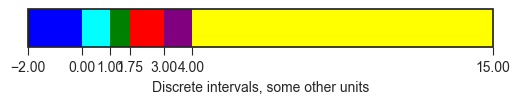

In [17]:
import matplotlib as mpl
fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)
var = 'temp'
if var == 'temp':
    cmap = (mpl.colors.ListedColormap(['blue', 'cyan', 'green', 'red', 'purple', 'yellow'])
            .with_extremes(over='0.25', under='0.75'))

    bounds = [-2, 0, 1, 1.75, 3, 4, 15] 
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
    fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=ax,
        extend=None, 
        ticks=bounds,
        spacing='proportional',
        orientation='horizontal',
        label='Discrete intervals, some other units',
    )

## plotting functions

In [18]:

def format_surfer(variable, levels_f, fig, ax2, contourf, contourl):
    if  contourl: 
        ax2.clabel(contourl, fmt = '%2.1f', fontsize=8)
    ax2.invert_yaxis()
    ax2.set_ylabel("Pressure [dbar]")
    plt.ylim([540,0])
    ax2.xaxis.set_major_formatter(
    mdates.ConciseDateFormatter(ax2.xaxis.get_major_locator()))

def datetime_to_decimal_days(date, start_date= '2017-01-01'):
    # date in decimal days since 2017 for df_ctd_moor
    days = df_ctd_moor.date - pd.to_datetime(start_date)
    # convert days to decimal days
    return days / timedelta(days=1)

def decimal_day_to_datetime(days):
    # convert decimal days to datetime
    return pd.to_datetime(days, unit='D', origin='2017-01-01')


def set_cbar(variable):
    if variable == "Salinity [PSU]":
        levels_f = np.concatenate(([10,15,20,25,30,31],np.arange(32,33.5,.2),np.arange(33.5,33.6,0.05)))
        levels_l = levels_f[::2]
        cmap = cmocean.cm.haline
        var = 'sal'
        short_label = "S"

    elif variable == 'Potential temperature [°C]':
        # levels_f = np.concatenate((np.arange(-1.5, 0.5, 0.5), np.arange(0.5,2.5,.25), np.arange(2.5,5.5,0.5)))
        levels_f = np.concatenate([[-1.5],np.arange(0, 3.3, 0.3), [9]])
        levels_f =[-1.8, 0, 1, 2, 3,4, 10] 
        levels_l = [ 1.2, 2.1, 3]
        cmap = cmocean.cm.thermal
        var = 'temp'
        short_label = r"$\theta$ (°C)"
    
    else:
        levels_f = np.concatenate((np.arange(1005,1025,1.5),np.arange(1025,1030,0.5)))
        levels_l = levels_f[::2]
        cmap = cmocean.cm.dense
        var = 'dens'
        short_label = r"$\rho}$ [kg/m$^3$]"

    norm = matplotlib.colors.BoundaryNorm(levels_f, cmap.N)
    return levels_f,cmap,var,levels_l,norm, short_label

In [19]:
mean_pres = [  538.8,331.2,155.8,59.6, 5]

## velocity profile

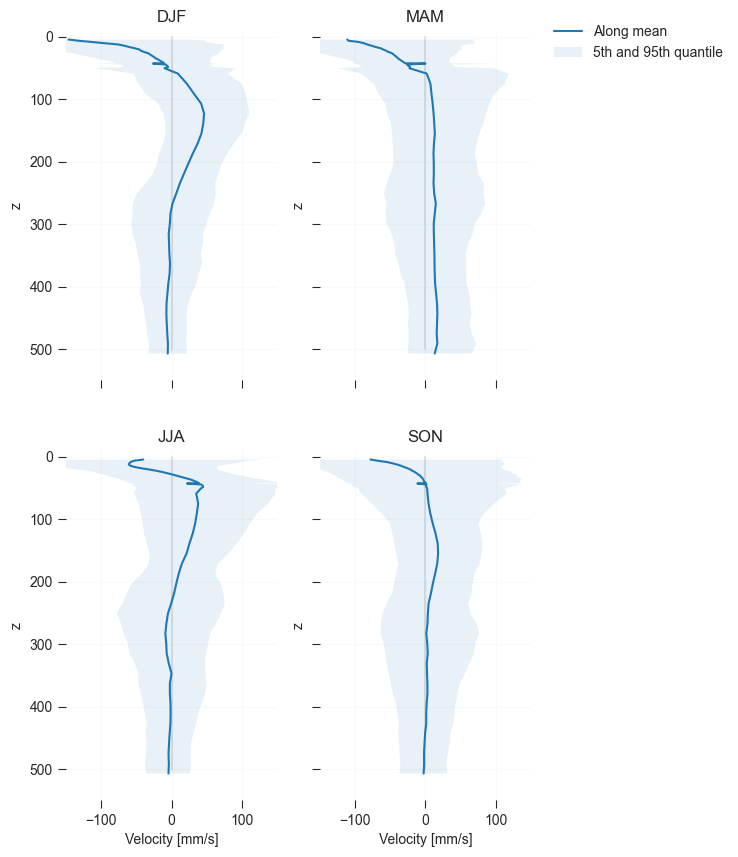

In [20]:
ds_velo_both_season = df_velo_both.groupby('time.season')



fig, axes = plt.subplots(2,2, sharey=True, sharex=True, figsize=(6, 10))

axs = axes.flatten()
for i, season in enumerate(['DJF', 'MAM', 'JJA', 'SON']):
    # plot the mean  Alongmmpersec and Along_res
    ds_velo_both_season.mean().sel(season=season).Alongmmpersec.plot(ax=axs[i], label='Along mean', y='z')
    # ds_velo_both_season.mean().sel(season=season).Acrossmmpersec.plot(ax=axs[i], label='Across mean', y='z')
    remove_spines(axs[i])
    # set grid with alpha 0.1
    axs[i].grid(alpha=0.1)

    # fill between 5th and 95th quantile
    axs[i].fill_betweenx(ds_velo_both_season.quantile([0.05]).sel(season=season).z, ds_velo_both_season.quantile([0.05]).sel(season=season).Along_res.squeeze().values, ds_velo_both_season.quantile([0.95]).sel(season=season).Along_res.squeeze().values,  alpha=0.1, label='5th and 95th quantile')
    axs[i].title.set_text(season)
    axs[i].set_xlabel('Velocity [mm/s]')
    # set xlim to -150 to 150
    axs[i].set_xlim([-150,150])
    # add vertical line of alpha 0.2 at 0
    axs[i].plot([0,0], [0, 500], alpha=0.1, color='k',zorder=0)

axs[0].set_ylim([550,-10])
axs[1].legend(loc='upper left', bbox_to_anchor=(1.05, 1.05))

# remove xlabel from all but bottom plots
for ax in axs[:-2]:
    ax.set_xlabel('')
# save figure
# plt.savefig(f'{figpath}/velocity_along_res_season.png', bbox_inches='tight', dpi=300)



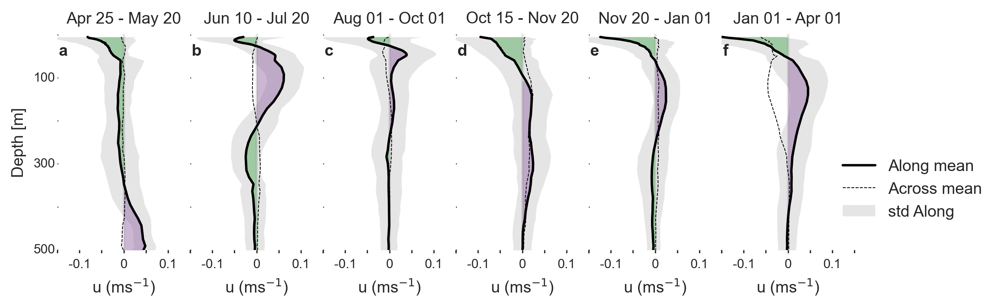

In [21]:
import warnings
warnings.filterwarnings('ignore')

# figsize in mm
width_mm = 190
height_mm = 70

# set fontsize 10
plt.rcParams.update({'font.size': 10})

fig = plt.figure( figsize=(width_mm/25.4, height_mm/25.4), dpi=300)

nrplots = 6

colorVpos = plt.get_cmap('PRGn_r')(0.8)
colorVneg = plt.get_cmap('PRGn')(0.8)

def velocity_profile_subplot(ax, time_start, time_end, fill_between="std"):
    line_color = 'black'
    ds_velo_select_phase = xr.merge([ds_velo_300.isel(z=slice(1,None)), ds_velo_75.isel(z=slice(None,-1))], join='outer').sel(time=slice(time_start, time_end))/1000
    ds_velo_select_phase.mean('time').Alongmmpersec.plot(ax=ax, label='Along mean', y='z', color=line_color)
    ds_velo_select_phase.mean('time').Acrossmmpersec.plot(ax=ax, label='Across mean', y='z', linestyle='--' , color = line_color, linewidth=0.5)
    if fill_between =="5-95":
        ax.fill_betweenx(ds_velo_select_phase.z, ds_velo_select_phase.quantile([0.05], dim='time').Along_res.squeeze().values,ds_velo_select_phase.quantile([0.95], dim='time').Along_res.squeeze().values,  alpha=0.1, label='5th and 95th quantile', color = line_color, linewidth=0,)
    if fill_between == 'std':
        ax.fill_betweenx(ds_velo_select_phase.z, ds_velo_select_phase.mean('time').Along_res.squeeze().values-ds_velo_select_phase.std('time').Along_res.squeeze().values, ds_velo_select_phase.mean('time').Along_res.squeeze().values+ds_velo_select_phase.std('time').Along_res.squeeze().values,  alpha=0.1, label='std Along', color = line_color, linewidth=0,)
    ax.set_title(f'{pd.to_datetime(time_start).strftime("%b %d")} - {pd.to_datetime(time_end).strftime("%b %d")}', fontsize=10)
    
    ax.fill_betweenx(ds_velo_select_phase.z, ds_velo_select_phase.mean('time').Along_res.squeeze().where(ds_velo_select_phase.mean('time').Alongmmpersec>0).values, 0,  alpha=0.5, color = colorVpos , linewidth=0)
    ax.fill_betweenx(ds_velo_select_phase.z, ds_velo_select_phase.mean('time').Along_res.squeeze().where(ds_velo_select_phase.mean('time').Alongmmpersec<0).values, 0,  alpha=0.5,  color = colorVneg , linewidth=0)   

    return ds_velo_select_phase

ax0 = fig.add_subplot(1, nrplots, 6)
ds_velo_winter_circ = velocity_profile_subplot(ax0, time_start='2019-01-01', time_end='2019-04-01')
ax0.set_xlim([-0.15,0.15])


ax0.set_ylim([500,-5])
ax0.set_yticks(np.arange(0, 550, 100), labels = np.arange(0, 550, 100))
ax0.set_label('Depth [m]')

ax=ax0
ax2 = fig.add_subplot(1, nrplots,1, sharex=ax0, sharey=ax0)
velocity_profile_subplot(ax2, time_start='2019-04-25', time_end='2019-05-20')
ax3 = fig.add_subplot(1, nrplots,2, sharex=ax0, sharey=ax0)
velocity_profile_subplot(ax3, time_start='2018-06-10', time_end='2018-07-20')
ax4 = fig.add_subplot(1, nrplots,3, sharex=ax, sharey=ax)
velocity_profile_subplot(ax4, time_start='2018-08-01', time_end='2018-10-01')
ax5 = fig.add_subplot(1, nrplots,4, sharex=ax, sharey=ax)
velocity_profile_subplot(ax5, time_start='2018-10-15', time_end='2018-11-20')
ax6 = fig.add_subplot(1, nrplots,5, sharex=ax, sharey=ax)
velocity_profile_subplot(ax6, time_start='2018-11-20', time_end='2019-01-01')

import warnings


phase_nr = ["VI", "I", "II", "III", "IV", "V"]

for ax in fig.axes:
    ax.set_ylabel('')
    ax.set_yticklabels([])
    ax.set_xlabel(r'u (ms$^{-1}$)')
    remove_spines(ax)
    ax.plot([0,0], [0, 500], alpha=0.1, color='k',zorder=0)
    ax.tick_params(axis='y', which='major', labelsize=8, length=0.5, direction='in')
    ax.tick_params(axis='x', which='major', labelsize=8, length=2, )
    ax.set_xticks([-0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15])
    ax.set_xticklabels(["", -0.1, "", 0, "", 0.1, ""])
5
#
for ztick in [100, 300, 500]:
    ax2.text(-0.155, ztick, str(ztick), rotation=0, fontsize=8, ha='right', va='center')
ax2.text(-0.22, 250, 'Depth [m]', rotation=90, fontsize=10, ha='right', va='center')
ax0.tick_params(axis='y', which='major', labelsize=8, length=0.0, direction='in')

handles, labels = ax.get_legend_handles_labels()
fig.legend(handles[:3], labels[:3], loc='lower left', bbox_to_anchor=(0.95, 0.25), ncol=1)
plt.tight_layout()

# add text to subplots 
alphabet = ['f', 'a', 'b', 'c', 'd', 'e', 'f']
for i, ax in enumerate(fig.axes):
    ax.text(0.01, 0.95, f'{alphabet[i]}', transform=ax.transAxes, fontsize=10, fontweight='bold', va='top')

fig.subplots_adjust(wspace=-0.0)
# change tick length on y axis to 1
# save figure
# transparent background
# plt.savefig(f'{figpath}/Velocity profile/velocity_along_phases_for_ppt.png', bbox_inches='tight', dpi=600, transparent=True)
# plt.savefig(f'{figpath}/Velocity profile/velocity_along_phases_draft.jpg', bbox_inches='tight', dpi=150)


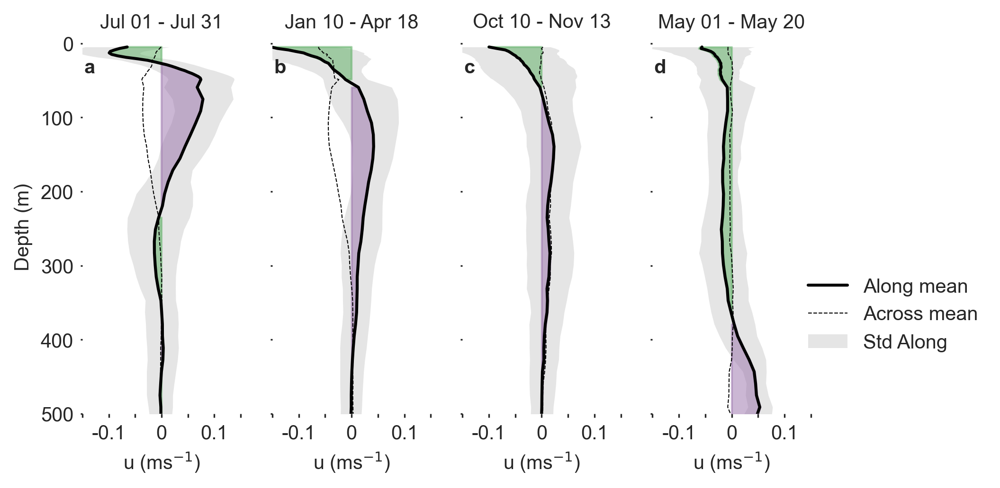

In [59]:
import warnings
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import pandas as pd

# Ignore warnings
warnings.filterwarnings('ignore')

# Set plot configurations
width_mm = 150  # Adjusted for 4 subplots
height_mm = 90
nrplots = 4
plt.rcParams.update({'font.size': 10})

fig = plt.figure(figsize=(width_mm / 25.4, height_mm / 25.4), dpi=300)

color_positive = plt.get_cmap('PRGn_r')(0.8)
color_negative = plt.get_cmap('PRGn')(0.8)

def plot_velocity_profile(ax, time_start, time_end, fill_between="std"):
    """
    Plots velocity profile for the specified time range.
    """
    line_color = 'black'

    # Merge datasets and select time range
    ds_velo_select_phase = xr.merge([
        ds_velo_300.isel(z=slice(1, None)),
        ds_velo_75.isel(z=slice(None, -1))
    ], join='outer').sel(time=slice(time_start, time_end)) / 1000

    # Plot mean profiles
    ds_velo_select_phase.mean('time').Alongmmpersec.plot(ax=ax, label='Along mean', y='z', color=line_color)
    ds_velo_select_phase.mean('time').Acrossmmpersec.plot(ax=ax, label='Across mean', y='z', linestyle='--', color=line_color, linewidth=0.5)

    # Fill between for uncertainty
    if fill_between == "5-95":
        ax.fill_betweenx(
            ds_velo_select_phase.z,
            ds_velo_select_phase.quantile(0.05, dim='time').Along_res.squeeze().values,
            ds_velo_select_phase.quantile(0.95, dim='time').Along_res.squeeze().values,
            alpha=0.1, label='5th-95th quantile', color=line_color
        )
    elif fill_between == 'std':
        ax.fill_betweenx(
            ds_velo_select_phase.z,
            ds_velo_select_phase.mean('time').Along_res.squeeze().values - ds_velo_select_phase.std('time').Along_res.squeeze().values,
            ds_velo_select_phase.mean('time').Along_res.squeeze().values + ds_velo_select_phase.std('time').Along_res.squeeze().values,
            alpha=0.1, label='Std Along', color=line_color, linewidth=0
        )

    # Highlight positive and negative velocities
    ax.fill_betweenx(
        ds_velo_select_phase.z,
        ds_velo_select_phase.mean('time').Along_res.squeeze().where(ds_velo_select_phase.mean('time').Alongmmpersec > 0).values,
        0, alpha=0.5, color=color_positive
    )
    ax.fill_betweenx(
        ds_velo_select_phase.z,
        ds_velo_select_phase.mean('time').Along_res.squeeze().where(ds_velo_select_phase.mean('time').Alongmmpersec < 0).values,
        0, alpha=0.5, color=color_negative
    )

    ax.set_title(f'{pd.to_datetime(time_start).strftime("%b %d")} - {pd.to_datetime(time_end).strftime("%b %d")}', fontsize=10)
    return ds_velo_select_phase

# Plot subplots with updated layout
subplot_times = [
    ('2018-07-01', '2018-07-31'),
    ('2019-01-10', '2019-04-18'),
    ('2018-10-10', '2018-11-13'),
    ('2019-05-01', '2019-05-20')
]

axes = []
for i, (start_time, end_time) in enumerate(subplot_times):
    ax = fig.add_subplot(1, nrplots, i + 1)
    plot_velocity_profile(ax, time_start=start_time, time_end=end_time)
    ax.set_xlim([-0.15, 0.15])
    ax.set_xticks([-0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15])
    ax.set_xticklabels(["", -0.1, "", 0, "", 0.1, ""])
    ax.tick_params(axis='x', which='major', length=2, )
    ax.set_ylim([500, -5])
    ax.set_xlabel(r'u (ms$^{-1}$)')
    if i == 0:
        ax.set_ylabel('Depth (m)')
    else:
        ax.set_yticklabels([])
        ax.set_ylabel('')
    ax.tick_params(axis='y', length=1)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    axes.append(ax)

# Add subplot labels
alphabet = ['a', 'b', 'c', 'd']
for i, ax in enumerate(axes):
    ax.text(0.01, 0.95, f'{alphabet[i]}', transform=ax.transAxes, fontsize=10, fontweight='bold', va='top')

# Legend configuration
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles[:3], labels[:3], loc='lower left', bbox_to_anchor=(0.95, 0.25), ncol=1)

plt.tight_layout()
fig.subplots_adjust(wspace=0.2)

# Save figures with transparent background
# plt.savefig(f'{figpath}/Velocity_profile/velocity_along_phases_for_ppt.png', bbox_inches='tight', dpi=600, transparent=True)
# plt.savefig(f'{figpath}/Velocity_profile/velocity_along_phases_draft.jpg', bbox_inches='tight', dpi=150)

plt.show()


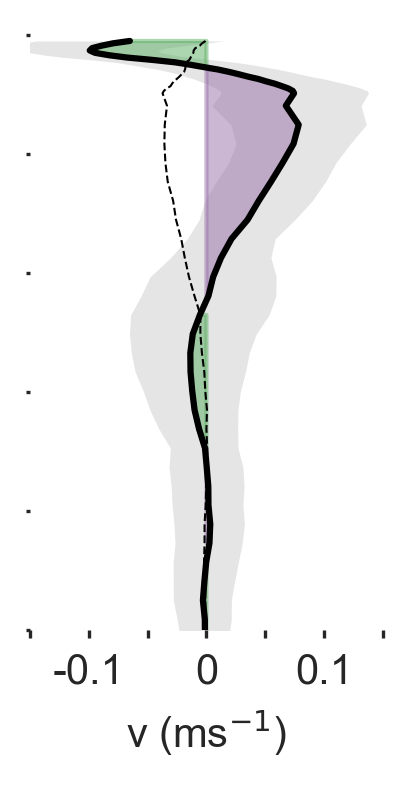

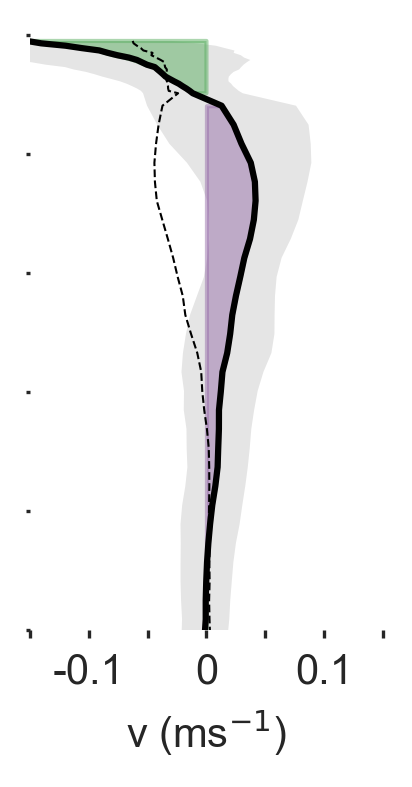

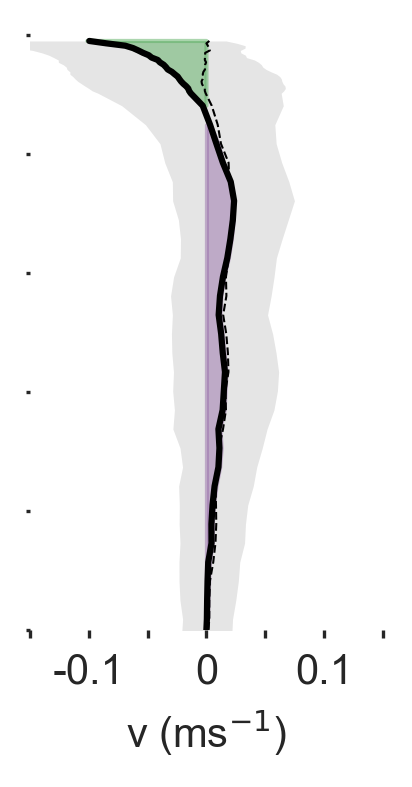

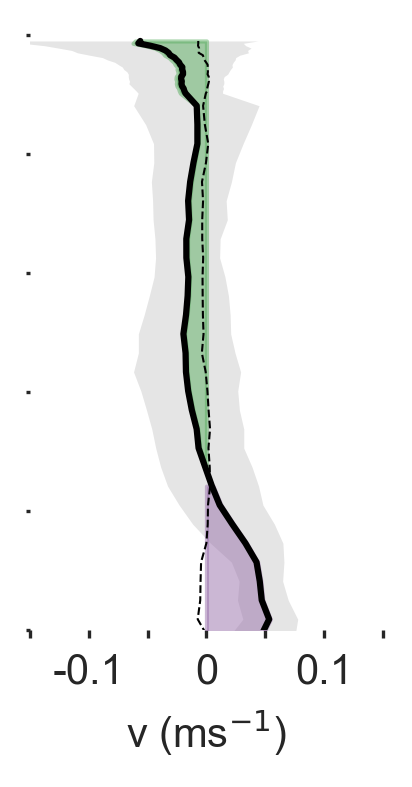

In [83]:


# Plot subplots with updated layout
subplot_times = [
    ('2018-07-01', '2018-07-31'),
    ('2019-01-10', '2019-04-18'),
    ('2018-10-10', '2018-11-13'),
    ('2019-05-01', '2019-05-20')
]
# Add subplot labels
alphabet = ['a', 'b', 'c', 'd']
for i, (start_time, end_time) in enumerate(subplot_times):
    fig = plt.figure(figsize=(width_mm / 25.4/4, height_mm /1.3/25.4), dpi=300)
    ax = fig.add_subplot(1, 1, 1)
    plot_velocity_profile(ax, time_start=start_time, time_end=end_time)
    ax.set_xlim([-0.15, 0.15])
    ax.set_xticks([-0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15])
    ax.set_xticklabels(["", -0.1, "", 0, "", 0.1, ""])
    ax.tick_params(axis='x', which='major', length=2, )
    ax.set_ylim([500, -5])
    ax.set_xlabel(r'v (ms$^{-1}$)')
    ax.set_title('')
    ax.set_yticklabels([])
    ax.set_ylabel('')
    ax.tick_params(axis='y', length=1)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)


    # ax.text(0.01, 0.95, f'{alphabet[i]}', transform=ax.transAxes, fontsize=10, fontweight='bold', va='top')
# plt.savefig(f'{figpath}/Velocity_profile/velocity_along_phases_draft.jpg', bbox_inches='tight', dpi=150)
    plt.tight_layout()
    plt.savefig(f'{figpath}/Velocity profile/velocity_along_diagram_{alphabet[i]}_{start_time}_{end_time}.png', bbox_inches='tight', dpi=600, transparent=True)

    fig.show()

# Save figures with transparent background


plt.show()

In [22]:
dz = df_velo_both.z.values[1:] - df_velo_both.z.values[:-1]
dz= np.mean([np.concatenate([dz, [dz[-1]]]), np.concatenate([[dz[0]], dz])], axis=0)

In [23]:
weights_dz = xr.DataArray(dz/dz.sum(), dims='z', coords={'z':df_velo_both.z.values})

In [24]:
ds_velo_monthly_mean =  (abs(df_velo_both[['Alongmmpersec', 'Acrossmmpersec']]).sel(z=slice(50,200)).resample(time='MS').mean().weighted(weights_dz)).mean('z')
ds_velo_monthly_mean['ratio'] = ds_velo_monthly_mean.Alongmmpersec/ds_velo_monthly_mean.Acrossmmpersec
ds_velo_monthly_mean.to_dataframe().round(2).sort_values('ratio', ascending=True)


,Alongmmpersec,Acrossmmpersec,ratio
time,,,
2019-02-01,64.68,65.12,0.99
2019-03-01,57.50,52.31,1.10
2019-01-01,50.82,36.31,1.40
2018-10-01,56.11,37.07,1.51
2019-04-01,52.90,35.09,1.51
2018-08-01,43.45,26.58,1.63
2018-07-01,66.84,39.01,1.71
2019-06-01,51.72,28.43,1.82
2018-11-01,43.23,23.49,1.84


In [25]:
from tqdm import tqdm 
from PIL import Image as PilImage
import imageio


def make_gif_velo_profile():
    start='2018-06-01'
    end='2019-06-16'

# loop over every week 

# Generate dates for each week in the year
    dates = pd.date_range(start='2018-05-29', end='2019-07-01', freq='W')

    images = []
    filenames = []

    for i in tqdm(range(len(dates) - 1)):
        start = dates[i]
        end = dates[i + 1]

    # Select data over the whole year and calculate the mean
        ds_velo_year_circ = xr.merge([ds_velo_300.isel(z=slice(1,None)), ds_velo_75.isel(z=slice(None,-1))], join='outer').sel(time = slice(start,end))/1000
        mean_along = ds_velo_year_circ.mean('time').Alongmmpersec
        mean_across = ds_velo_year_circ.mean('time').Acrossmmpersec

        fig = plt.figure(figsize=(width_mm/25.4/4, height_mm/25.4))
        ax = fig.add_subplot(1, 1, 1)
        mean_along.plot(ax=ax, label='Along mean', y='z', color='black')
        mean_across.plot(ax=ax, label='Across mean', y='z', linestyle='--' , color = 'black', linewidth=0.5)
        ax.fill_betweenx(mean_along['z'], mean_along, where=mean_along>0, color='red', alpha=0.3)
        ax.fill_betweenx(mean_along['z'], mean_along, where=mean_along<0, color='blue', alpha=0.3)

        ax.set_title(f'{start.strftime("%Y-%m-%d")} ')
        ax.tick_params(axis='y', which='major', labelsize=8, length=2, direction='in')
        ax.tick_params(axis='x', which='major', labelsize=8, length=2, )
        ax.set_xticks([-0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15])
        ax.set_xticklabels(["", -0.1, "", 0, "", 0.1, ""])
        ax.set_xlim([-0.15,0.15])
        ax.set_ylim([500,-5])
        ax.set_xlabel('v (ms$^{-1}$)')
        ax.set_ylabel('Depth [m]')
        remove_spines(ax)

        figname = f'{figpath}/Velocity profile/gif/velocity_along_{start.strftime("%Y-%m-%d")}.jpg'
        fig.savefig(figname, bbox_inches='tight', dpi=300)
        filenames.append(figname)

    duration = 0.66 #s
    writer = imageio.get_writer(f'{figpath}/Velocity profile/gif/velocity_along_.mp4', fps=1/duration)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
# Close the writer
    writer.close()



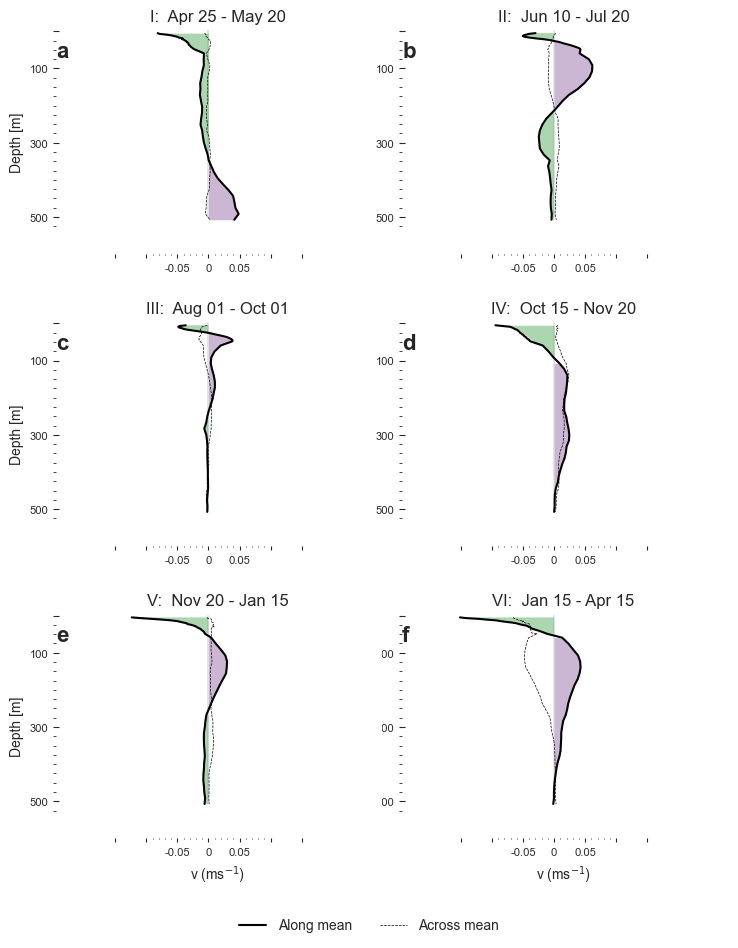

In [26]:
import warnings
warnings.filterwarnings('ignore')

# figsize in mm
width_mm = 190
height_mm = 110/300*190



fig = plt.figure()# figsize=(width_mm/25.4, height_mm/25.4), dpi=300)
# set pixel size of figure
fig.set_size_inches(190/25.4, 230/25.4)

nrplots = 6


ax0 = fig.add_subplot(nrplots//2, 2, 6)
ds_velo_winter_circ = velocity_profile_subplot(ax0, time_start='2019-01-15', time_end='2019-04-15', fill_between=True)
# set xlim to -150 to 150
ax0.set_xlim([-0.25,0.28])
# # print text with mean between 50 and 400 m
# ax.text(0.05, 0.05, f'Mean 50 - 350 m: {ds_velo_winter_circ.mean("time").Along_res.sel(z=slice(50,350)).mean().values/10:.1f} cm/s +- {ds_velo_winter_circ.mean("time").Along_res.sel(z=slice(50,350)).std().values/10:.1f}', transform=ax.transAxes, fontsize=10,)
# # mean between 60 and 300
# ax.text(0.05, 0.15, f'Mean 60 - 300 m: {ds_velo_winter_circ.mean("time").Along_res.sel(z=slice(60,300)).mean().values/10:.1f} cm/s +- {ds_velo_winter_circ.mean("time").Along_res.sel(z=slice(60,300)).std().values/10:.1f}', transform=ax.transAxes, fontsize=10,)

# # add vertical line of alpha 0.2 at 0
# ax.plot([0,0], [0, 500], alpha=0.1, color='k',zorder=0)

ax0.set_ylim([600,-5])
ax0.set_yticks(np.arange(0, 550, 100), labels = np.arange(0, 550, 100))
ax0.set_label('Depth [m]')

# ax.legend()
# ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.05))
# 

ax=ax0
# add subplot to figure
ax2 = fig.add_subplot(nrplots//2, 2,1, sharex=ax0, sharey=ax0)
velocity_profile_subplot(ax2, time_start='2019-04-25', time_end='2019-05-20', fill_between=True)
# do this for june 1 - august 1 2018
ax3 = fig.add_subplot(nrplots//2, 2,2, sharex=ax0, sharey=ax0)
velocity_profile_subplot(ax3, time_start='2018-06-10', time_end='2018-07-20', fill_between=True)
# aust 1 - oct 1 2018
ax4 = fig.add_subplot(nrplots//2, 2,3, sharex=ax, sharey=ax)
velocity_profile_subplot(ax4, time_start='2018-08-01', time_end='2018-10-01', fill_between=True)
# oct 1  - nove 20
ax5 = fig.add_subplot(nrplots//2, 2,4, sharex=ax, sharey=ax)
velocity_profile_subplot(ax5, time_start='2018-10-15', time_end='2018-11-20', fill_between=True)
# nov 20 - jan 15
ax6 = fig.add_subplot(nrplots//2, 2,5, sharex=ax, sharey=ax)
velocity_profile_subplot(ax6, time_start='2018-11-20', time_end='2019-01-15', fill_between=True)



# add text to every ax 
phase_nr = ["VI", "I", "II", "III", "IV", "V"]
figure_label = ["f", "a", "b", "c", "d", "e", "f"]
# remove xlabel from all but bottom plots
for ax in fig.axes:
    ax.set_ylabel('')
    ax.set_yticklabels([])
    ax.set_xlabel("")
    remove_spines(ax)
    # set grid with alpha 0.1
    # ax.grid(alpha=0.1)
    # add vertical line of alpha 0.2 at 0
    ax.plot([0,0], [0, 500], alpha=0.1, color='k',zorder=0)
    #  make y ticks small and not on the outside
    ax.tick_params(axis='y', which='major', labelsize=8, length=4, direction='in')
    ax.tick_params(axis='y', which='minor', length=2, direction='in')
    ax.tick_params(axis='x', which='major', labelsize=8, length=3, )
    ax.tick_params(axis='x', which='minor', length=1, )
    


    # add title with time_start and time_end in format April 20 - May 20
    # ax.text(0.05, 0.05, f'{phase_nr[fig.axes.index(ax)]}', transform=ax.transAxes, fontsize=20, fontweight='bold')
    # set figure label
    ax.text(0.01, 0.95, figure_label[fig.axes.index(ax)], transform=ax.transAxes, fontsize=16, fontweight='bold', va='top')
    ax.set_xticks([-0.15, -0.1, -0.05, 0, 0.05, 0.1, 0.15])
    # ax.set_xticklabels(["", -0.1, "", 0, "", 0.1, ""])
    # set xticklabels for -0.05 and 0.05
    ax.set_xticklabels(["","",  -0.05, 0, 0.05, "", ""])
    # ax.xaxis.set_major_formatter(format_colorbar_tick)
    # set minor xticks
    ax.set_xticks(np.arange(-0.10, 0.11, 0.01), minor=True)
    ax.set_yticks(np.arange(0, 550, 25), minor=True)
    title = ax.get_title()
    new_title = f"{phase_nr[fig.axes.index(ax)]}:  {title}"
    ax.set_title(new_title)

ax6.set_xlabel(r'v (ms$^{-1}$)')
ax0.set_xlabel(r'v (ms$^{-1}$)')


for axx in [ax2, ax4, ax6]:

    axx.set_ylabel('Depth [m]')
    axx.set_yticks([0, 100, 300, 500])
    axx.set_yticklabels(["", 100, 300, 500])

# set length of yticks to 0
# ax0.tick_params(axis='y', which='major', labelsize=8, length=0.0, direction='in')

# add legendb below figure
# only keep the first 3 legend entries
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles[:3], labels[:3], loc='lower center', bbox_to_anchor=(0.5, -0.05), ncol=3)
plt.tight_layout()

fig.subplots_adjust(wspace=0.05,hspace=0.3)
# transparent background
plt.savefig(f'{figpath}/velocity_along_phases_raster_more_ticks.png', bbox_inches='tight', dpi=600, transparent=True)
# change tick length on y axis to 1
# save figure
# transparent backgroundb
# plt.savefig(f'{figpath}/velocity_along_phases_for_ppt.png', bbox_inches='tight', dpi=600, transparent=True)
# plt.savefig(f'{figpath}/velocity_along_phases_draft.jpg', bbox_inches='tight', dpi=150)


# import ctd monthly

In [27]:
# # %% SURFER PLOT
# # SURFER PLOT

# path_intermediate_files = Path.cwd().parent.joinpath("intermediate_files")

# variable = 'Salinity [PSU]'
variable = 'Potential temperature [°C]'
# variable = 'Density [kg/m3]'
mean_pres = [  538.8,331.2,155.8,59.6, 5]


# levels_f, cmap, var, levels_l, norm, short_label = set_cbar(variable)
var = 'temp'

# fig, (ax2,ax,ax3) = plt.subplots(3,1, figsize=[11,10], sharex =True, sharey=True, )


df_monthly = pd.read_csv(f"{path_parent}/Processing/intermediate_files/monthly_18_19_gf10.csv", index_col=0, parse_dates=["date"])
df_monthly["datedate"] = df_monthly.date.copy()
df_monthly['datetime'] = pd.to_timedelta(df_monthly.time-1, unit='D') + pd.to_datetime(pd.to_datetime(df_monthly.datedate).dt.year, format='%Y')
df_monthly.date = df_monthly.datetime.copy()

df_gf10 = df_monthly[(df_monthly['St.']=="GF10")]#&(df_monthly['Type']=='CTD')]
file_mooring = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Processing/intermediate_files/mooring_gf10.csv"
df_mooring = pd.read_csv(file_mooring, index_col=0, parse_dates=True)

# df10piv = df_gf10.drop_duplicates(['date', 'Pressure [dbar]']).pivot('date', 'Pressure [dbar]', var)
# X =df10piv.index.values
# Y = df10piv.columns.values
# Xpiv, Ypiv = np.meshgrid(df10piv.index.values, df10piv.columns.values)
# Z=df10piv.values.T

# contourf = ax2.contourf(X,Y,Z,levels=levels_f, norm=norm, cmap=cmap)
# contourl = ax2.contour(X,Y,Z,colors= 'k', levels=levels_l, linewidths= 0.5)
# # ax2.scatter(Xpiv.flatten(),Ypiv.flatten(), s=0.1, c='white')
# ax2.scatter(X, np.zeros(len(X)), color='red')

# format_surfer(variable, levels_f, fig, ax2, contourf, contourl)



from scipy.interpolate import griddata
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
df_ctd_moor = pd.concat([
    df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
    df_mooring.set_index(['Pressure [dbar]', 'date'])[var]])
df_ctd_moor = df_ctd_moor.reset_index().dropna()
df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)

# xi = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 1)
# yi = np.arange(df_ctd_moor['Pressure [dbar]'].min(), df_ctd_moor['Pressure [dbar]'].max()+1, 1)

# # convert xi to datetime
# xi_date = decimal_day_to_datetime(xi)

# # Filter out NaN values from var column
# valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
# points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices])
# values = df_ctd_moor[var].to_numpy()[valid_indices]

# # Perform interpolation using 'linear' method
# zi = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')

# # Plot the results
# contourf = ax.contourf(xi_date, yi, zi, levels=levels_f, norm=norm, cmap=cmap)
# contourl = ax.contour(xi_date, yi, zi, colors= 'k', levels=levels_l, linewidths= 0.5)
# ax.scatter(np.repeat(pd.to_datetime('2018-05-29'),5), mean_pres, color='red')
# ax.scatter(X, np.zeros(len(X)), color='red')

# format_surfer(variable, levels_f, fig, ax, contourf, contourl)

# # set xlim based on ('2018-05-29)','2019-06-12' 
# ax.set_xlim([pd.to_datetime('2018-05-29'), pd.to_datetime('2019-06-12')])


# #==================================================================================================
# # Only mooring data
# #==================================================================================================
# df_mooring.date=df_mooring.date.astype('datetime64[ns]').round('10min')
# dfmoorpiv = df_mooring.drop_duplicates(['date', 'depth']).pivot('date', 'depth', var)['2018-05-29':'2019-06-12']
# X =dfmoorpiv.index.values
# Y = dfmoorpiv.columns.values
# Xpiv, Ypiv = np.meshgrid(dfmoorpiv.index.values, dfmoorpiv.columns.values)
# Z=dfmoorpiv.values.T

# contourf = ax3.contourf(X,Y,Z,levels=levels_f, norm=norm, cmap=cmap)
# contourl = ax3.contour(X,Y,Z,colors= 'k', levels=levels_l, linewidths= 0.5)
# ax3.scatter(np.repeat(pd.to_datetime('2018-05-29'),5), mean_pres, color='red')



# format_surfer(variable, levels_f, fig, ax3, contourf, contourl=False)
# ax3.set_ylim([550,0])

# # set ax titles
# ax2.set_title('CTD')
# ax.set_title('CTD + Mooring')
# ax3.set_title('Mooring')


# # fig.savefig(f"{figpath}/Surfer plot/surfer_{var}_compare.png", dpi=300, bbox_inches='tight')

In [28]:


days = datetime_to_decimal_days(df_ctd_moor.date)
dates = decimal_day_to_datetime(days)

In [29]:
sample_size = 10000 # half of the sample size



In [30]:
def get_background_patch(ax):
    import matplotlib.patches as patches
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    xy = (xmin,ymin)
    width = xmax - xmin
    height = ymax - ymin
    p = patches.Rectangle(xy, width, height, hatch='//', fill=None, zorder=-10)
    return p

In [31]:
df_moor_daily = pd.DataFrame()
df_mooring.date = pd.to_datetime(df_mooring.date)
for d in df_mooring.depth.unique():
    df= df_mooring[df_mooring.depth==d].set_index('date')
    means = df.groupby(df.index.floor('D')).mean()
    df_moor_daily = pd.concat([df_moor_daily, means])
df_moor_daily = df_moor_daily.reset_index()


In [32]:
def add_arrows_for_sampling_loc(mean_pres, ax,  datelim, zlim, arrowhead=-(zlim[0]/550*10), arrowtail=-(zlim[0]/550*10),color_mooring='b', color_ctd='r'):
    '''
    Arrows for CTD on top
    Arrows for mooring on the side
    mean_pres = list of mean pressure values of mooring
    ax = axes object
    takes datelim as list of 2 datetime objects
    zlim = list of 2 depth values
    '''
    # select all dates in the xlim

    selected_dates = df_monthly[(df_monthly.date >= datelim[0]) & (df_monthly.date <= datelim[1])].date.unique()
    for date in selected_dates:
        ax.annotate('', xy=(date, arrowhead), xycoords='data', xytext=(date, arrowtail), 
            arrowprops=dict(arrowstyle="->", color='black'), annotation_clip=False)
    for i,depth in enumerate(mean_pres):
        if depth > zlim[0]: continue  
        if depth < zlim[1]: continue
        ax.annotate('', xy=(datetime(2018, 5,29), depth), xycoords='data', xytext=(datetime(2018, 5,20), depth), 
            arrowprops=dict(arrowstyle="->", color=color_mooring[i]), annotation_clip=False)
    # make shaft length smaller


Salinity is typically higher in the ctd then in the mooring, so more fresh water in the mooring. Also, temperature is higher, and sometimes lower. This indicates there is more fresh water at the mooring location, which is in the north.

## with colorbar John

In [33]:
levels_f = np.concatenate([np.arange(-2, 0.5, 0.5), np.arange(0.5, 2.0, 0.25), np.arange(2.0, 5.8, 0.5), [15]])

In [34]:
mm = 1/25.4
from matplotlib.transforms import blended_transform_factory

def fmt_label(x):
    s = f"{x:.1f}"
    if s.endswith(".0"):
        s = f"{x:.0f}"
    elif (float(s)*10).is_integer():
        s = f"{x:.1f}"
    elif (float(s)*100).is_integer():
       s = f"{x:.2f}"
    return rf"{s}" if plt.rcParams["text.usetex"] else f"{s}"

# fig, ax = plt.subplots(4,1, figsize=(190*mm, 230*mm), sharex=True, sharey=False)
# resample_time = '1D'
# (ds_velo_75/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=ax[3], cmap=cmap, levels=levels,  add_colorbar=False, extend='both')
# contour = (ds_velo_300/1000).resample(time=resample_time).mean().Along_res.plot.contour(y='z', robust=True, ax=ax[0], cmap=cmap, levels=levels,  add_colorbar=False, extend='both')
# clabels = ax[0].clabel(contour, inline=1, fontsize=10, fmt=fmt_label)
# xloc = pd.to_datetime('2019-01-01')
# yloc = [0.1, 0.9]

# cax = ax[0].inset_axes( [1.04, 0.05, 0.01, 0.9] )    
# # change label to ms-1
# clabel = r'V$_{along}$ (ms$^{-1}$)'
# cbar = fig.colorbar(contour_velo, orientation='vertical', label=clabel, ticks=levels, ax =ax[0], cax=cax)

# Define a custom tick label formatting function
def format_colorbar_tick(value, pos):
    if value.is_integer():
        return f'{int(value)}'
    elif (value*10).is_integer():
        return f'{value:.1f}'
    elif (value*100).is_integer():
        return f'{value:.2f}'
    else:
        return value

# cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))


def draw_vertical_line_across_subplots(fig, ax, xloc, yloc, color, linewidth):
    '''
    draws vertical line across subplots
    ax = axes object where to start drawing
    xloc = x location of line, in data coordinates
    yloc = list of 2 values, in figure coordinates
    '''
    xline = [xloc, xloc]
    trans = blended_transform_factory(ax.transData,fig.transFigure)
    ax.plot(xline, yloc, transform=trans, clip_on=False, zorder=0, color=color, linewidth=linewidth)


# add text in blended_transform_factory
def add_text_to_ax(ax, xloc, text, fontsize=10):
    ax.text(xloc, 1.05, text, transform=blended_transform_factory(ax.transData,ax.transAxes), fontsize=fontsize, fontweight='bold', ha='center', font="Palatino")



                
# yloc = [0.1, 0.9]
# xlocs = ['May 28, 2018', 'August 1, 2018', 'October 1, 2018', 'November 20, 2018', 'January 15, 2019', 'April 20, 2019', 'July 1, 2019']
# phases = ['II', 'III', 'IV', 'V', '0', 'I']
# xlocs = pd.to_datetime(xlocs)


# for i in range(len(xlocs)-1):
#     xloc_text = xlocs[i] + (xlocs[i+1]-xlocs[i])/2
#     draw_vertical_line_across_subplots(fig, ax[0], xlocs[i], yloc=yloc, color='lightgrey',linewidth=2)
#     add_text_to_ax(ax[0], xloc_text, f'{phases[i]}')


In [35]:
# Define a custom tick label formatting function
def format_colorbar_tick(value, pos):
    if value.is_integer():
        return f'{int(value)}'  # Format integers without decimal places
    elif (value*10).is_integer():
        return f'{value:.1f}'
    elif (value*100).is_integer():
        return f'{value:.2f}'
    elif (value*1000).is_integer():
        return f'{value:.3f}'
    else:
        return f'{value}'  #b Format floating-point numbers with one decimal place


In [36]:
gridded_temp_sal = {}

for variable, i in zip(['Potential temperature [°C]', 'Salinity [PSU]'], [2,3]):
    ticks= None
    levels_f, cmap, var, levels_l, norm, short_label= set_cbar(variable)
    # if var == 'temp':
    #     levels_f = np.arange(0,3.1, 0.3)
    df_ctd_moor = pd.concat([
        df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
        df_moor_daily[df_moor_daily.depth>5].set_index(['Pressure [dbar]', 'date'])[var]])
    df_ctd_moor = df_ctd_moor.reset_index().dropna()
    df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)
    df_ctd_moor['depth'] = gsw.z_from_p(df_ctd_moor['Pressure [dbar]'], 64) *-1

    xi = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 3)
    yi = np.arange(df_ctd_moor['depth'].min(), df_ctd_moor['depth'].max()+1, 3)
    xi_date = decimal_day_to_datetime(xi)
    valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
    points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['depth'].to_numpy()[valid_indices])
    values = df_ctd_moor[var].to_numpy()[valid_indices]
    # Perform interpolation using 'linear' method
    zi = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')

    gridded_product = {}
    gridded_product['xi'] = xi
    gridded_product['yi'] = yi
    gridded_product['xi_date'] = xi_date
    gridded_product['zi'] = zi
    gridded_temp_sal[variable] = gridded_product

gridded_temp_sal


var = "sigma-dens"
df_ctd_moor = pd.concat([
    df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
    df_moor_daily.set_index(['Pressure [dbar]', 'date'])[var]])
df_ctd_moor = df_ctd_moor.reset_index().dropna()
df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)
levels_sigmadens_new = np.sort(np.concatenate([[24,26.5], np.arange(26.6,27.1,0.1)]))

xi_dens = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 2)
yi_dens = np.arange( df_ctd_moor['Pressure [dbar]'].min()-1,df_ctd_moor['Pressure [dbar]'].max()+1, 10)
xi_date_dens = decimal_day_to_datetime(xi_dens)
valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices])
values = df_ctd_moor[var].to_numpy()[valid_indices]
z_dens = griddata(points, values, (xi_dens[None, :], yi_dens[:, None]), method='linear') 
   

In [37]:
yi_dens

array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.,
       110., 120., 130., 140., 150., 160., 170., 180., 190., 200., 210.,
       220., 230., 240., 250., 260., 270., 280., 290., 300., 310., 320.,
       330., 340., 350., 360., 370., 380., 390., 400., 410., 420., 430.,
       440., 450., 460., 470., 480., 490., 500., 510., 520., 530., 540.,
       550., 560., 570.])

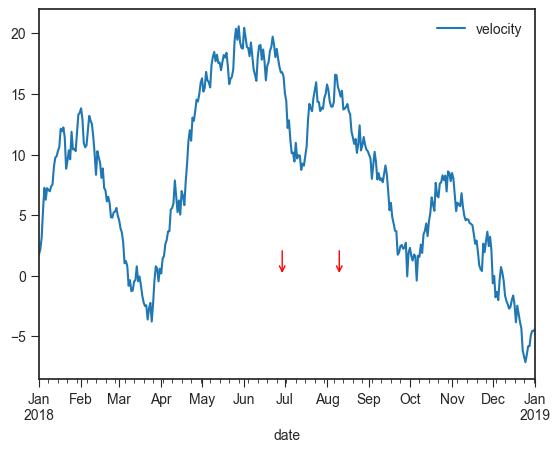

In [38]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Create a dummy DataFrame
np.random.seed(0)
dates = pd.date_range(start='1/1/2018', end='1/01/2019')
df = pd.DataFrame({
    'date': dates, 
    'velocity': np.random.randn(len(dates)).cumsum()
})

# Convert the dates to the format used in your data
date1 = pd.to_datetime('2018-06-29')
date2 = pd.to_datetime('2018-08-10')

# Find the y-values corresponding to these dates
y1 = df.loc[df['date'] == date1, 'velocity'].values[0]
y2 = df.loc[df['date'] == date2, 'velocity'].values[0]

y1, y2 = 0, 20
# Create a plot
fig, ax = plt.subplots()

# Plot the 'velocity' column
df.plot(x='date', y='velocity', ax=ax)
def add_arrows(date1, y1, date2, y2, ax):
    ax.annotate('', xy=(date1, y1), xytext=(0, y2), textcoords='offset points',
                arrowprops=dict(edgecolor='red',arrowstyle="->"), clip_on=False)
    ax.annotate('', xy=(date2, y1), xytext=(0, y2), textcoords='offset points',
                arrowprops=dict(edgecolor='red', arrowstyle="->",), clip_on=False)


# Use the function
add_arrows(date1, y1, date2, y2, ax)
plt.show()

# SURFER PLOT WITH PHASES

In [39]:
for i, date in enumerate(dates):
    print(i, date)
    print(date.month)

0 2018-01-01 00:00:00
1
1 2018-01-02 00:00:00
1
2 2018-01-03 00:00:00
1
3 2018-01-04 00:00:00
1
4 2018-01-05 00:00:00
1
5 2018-01-06 00:00:00
1
6 2018-01-07 00:00:00
1
7 2018-01-08 00:00:00
1
8 2018-01-09 00:00:00
1
9 2018-01-10 00:00:00
1
10 2018-01-11 00:00:00
1
11 2018-01-12 00:00:00
1
12 2018-01-13 00:00:00
1
13 2018-01-14 00:00:00
1
14 2018-01-15 00:00:00
1
15 2018-01-16 00:00:00
1
16 2018-01-17 00:00:00
1
17 2018-01-18 00:00:00
1
18 2018-01-19 00:00:00
1
19 2018-01-20 00:00:00
1
20 2018-01-21 00:00:00
1
21 2018-01-22 00:00:00
1
22 2018-01-23 00:00:00
1
23 2018-01-24 00:00:00
1
24 2018-01-25 00:00:00
1
25 2018-01-26 00:00:00
1
26 2018-01-27 00:00:00
1
27 2018-01-28 00:00:00
1
28 2018-01-29 00:00:00
1
29 2018-01-30 00:00:00
1
30 2018-01-31 00:00:00
1
31 2018-02-01 00:00:00
2
32 2018-02-02 00:00:00
2
33 2018-02-03 00:00:00
2
34 2018-02-04 00:00:00
2
35 2018-02-05 00:00:00
2
36 2018-02-06 00:00:00
2
37 2018-02-07 00:00:00
2
38 2018-02-08 00:00:00
2
39 2018-02-09 00:00:00
2
40 2018-02

In [40]:
# dates = pd.date_range(start=datelim[0], end=datelim[1], freq='MS').to_pydatetime().tolist()
# [date.strftime('%b\n%Y') if date.month == 1 else date.strftime('%b') for i, date in enumerate(dates)]


NameError: name 'datelim' is not defined

# Figure 2

We set ticklabels for temp
We set ticklabels for temp
Adding phases
Adding inflow boxes
Format axes
Saving figure
Showing figure


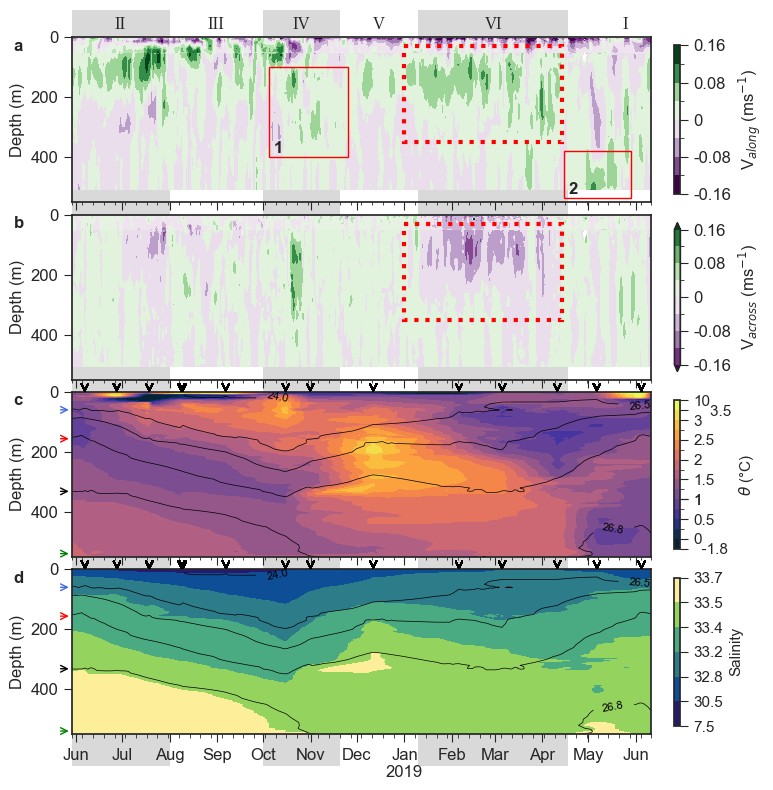

In [42]:
import cmocean as cmo
from datetime import datetime, timedelta
import matplotlib.patches as mpatches
# NOTE THAT UPPER CTD IS NOT TAKING INTO ACCOUNT CURRENTLY

plt.style.use('seaborn-ticks')
plt.rcParams.update({'font.size': 12})
John=False




fontsize_ticks = 12
fontsize_alpha = 12
fontsize_clabel = 8
fontsize_cbar = 11

levels = [-185, -100, -50, -25, -10, 0,10, 25, 50, 100, 185]
levels = np.array(levels)/1000.
max_cbar = 0.16
levels = np.arange(-max_cbar, max_cbar*1.001, 0.04).round(3)

cmap_velo = 'PRGn'
cmap = cmap_velo
if John:
    levels = [-0.3, -0.12, -0.08, -0.04, 0,  0.04, 0.08, 0.12, 0.3 ]
    cmap =  mpl.colors.ListedColormap(['red', 'orange', 'yellow', 'lawngreen', 'cyan','cornflowerblue', 'darkblue', 'violet'][::-1])
zlim = [550, 0]
datelim = [datetime(2018, 5,29), datetime(2019, 6, 11)]

cdepth =['cyan','royalblue',  'red','black', 'green'][::-1]


cm = 1/2.54  # centimeters in inches
mm = cm/10.  # millimeters in inches
if zlim[0] >200: 
    fig, ax = plt.subplots(4,1, figsize=(190*mm, 230*mm), sharex=True, sharey=True)
else: 
    fig, ax = plt.subplots(5,1, figsize=(190*mm, 230*mm), sharex=False, sharey=False)


resample_time = '25h'

# if min(zlim) <60:
#==================================================================================================
# Surfer plot Velocity
#==================================================================================================

def remove_outliers(ds, outlier_lim):
    return ds.where((ds >= -outlier_lim) & (ds <= outlier_lim))
ds_300 =  (ds_velo_300/1000).resample(time=resample_time).mean()
ds_75 = (ds_velo_75/1000).sel(z=slice(zlim[0]+5,None)).resample(time=resample_time).mean()

contour_velo = ds_75.Along_res.plot.contourf(y='z', robust=True, ax=ax[0], cmap=cmap, levels=levels, extend=None, add_colorbar=False)
ds_300.Along_res.plot.contourf(y='z', robust=True, ax=ax[0], cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
ds_75.Across_res.plot.contourf(y='z', robust=True, ax=ax[1], cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = ds_300.Across_res.plot.contourf(y='z', robust=True, ax=ax[1], cmap=cmap, levels=levels,  add_colorbar=False,extend=None)
cax = ax[0].inset_axes( [1.04, 0.05, 0.01, 0.9] )    
cax2 = ax[1].inset_axes( [1.04, 0.05, 0.01, 0.9] )
# colorbar ticks = levels

cbar0 = fig.colorbar(contour_velo, orientation='vertical', label=r'V$_{along}$ (ms$^{-1}$)', ticks=levels[::2], ax =ax[0], cax=cax)
cbar1 = fig.colorbar(cvelo_cross, orientation='vertical', label=r'V$_{across}$ (ms$^{-1}$)', ticks=levels[::2], ax =ax[1], cax=cax2)
for cbar in [cbar0, cbar1]: cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))


# for i in range(1): 
#     # ax[i].axhline(y=34.5, color='white', linestyle='dashed') # add horizontal line
#     ax[i].set_ylabel('Depth [m]')
# plt.gca().invert_yaxis()
# plt.ylim(zlim)
# ax[0].set_title('Along fjord')
# ax[1].set_title('Across fjord')
# ax[1].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
# ax[1].xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
# ax[1].set_xlabel('')

# remove all ticks and labels from top plot
# ax[0].tick_params(labelbottom=False, bottom=False, top=False, labeltop=False)
# ax[0].set_xlabel('')
# remove hspace
plt.subplots_adjust(hspace=0.15)
# for axpatch in ax: axpatch.add_patch(get_background_patch(axpatch))

# density
cmap_dens = cmocean.cm.dense
short_label = r'$\sigma$ (kg m$^{-3}$)'
#==================================================================================================
# Surfer plot Temperature and salinity
#==================================================================================================
for variable, i in zip(['Potential temperature [°C]', 'Salinity [PSU]'], [2,3]):
    ticks= None
    levels_f, cmap, var, levels_l, norm, short_label= set_cbar(variable)
    # if var == 'temp':
    #     levels_f = np.arange(0,3.1, 0.3)
    cax = ax[i].inset_axes( [1.04, 0.05, 0.01, 0.9] )
    cmap = mpl.colors.ListedColormap(['blue', 'cyan', 'forestgreen', 'red', 'purple', 'yellow'])
    contour_colors= 'black'
    if var == 'temp':
        if not John: cmap = mpl.colors.ListedColormap(cmo.cm.thermal(np.linspace(0, 1, 15)))
        # bounds = [-1.8, 0, 0.75, 1.5, 2.25,  3, 4, 10] 
        # norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        # levels_l = np.concatenate([np.arange(-1.8, 0.5, 0.5), np.arange(0.5, 2.0, 0.25), np.arange(2.0, 5.8, 0.5), [10]])
        bounds =[-1.8, 0,0.25, 0.5, 0.75, 1, 1.25, 1.5, 1.75, 2,2.25, 2.5,2.75,3, 3.5 , 10] 
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        levels_l = [-1.8, 0, 1,  2,  3, 3.5, 10] 
        # contourcolors = where levels_l is zero or lower, white, else black
        contourcolors = ['white' if x <= 0 else 'black' for x in levels_l]
        ticks = [-1.8, 0, 0.5,  1,  1.5, 1, 2, 2.5,3, 3.5 , 10] 
        ticklabels = ["  -1.8", 0, 0.5,  1,  1.5, 1, 2, 2.5,3, "    3.5" , 10] 
    elif var == 'sal':
        if not John: cmap = mpl.colors.ListedColormap(cmo.cm.haline(np.linspace(0, 1, 6)))
        bounds = [7.5, 30.5, 32.8, 33.2, 33.4,  33.5, 33.7]
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        levels_l = np.sort(np.concatenate([np.arange(30, 33, 1), np.arange(33,33.55, 0.1), [33.45,33.55], np.arange(33.6, 35.1, 0.4)]))
        short_label = 'Salinity'
        # contourcolors = where levels_l is 33.2 or lower, white, else black

        contourcolors = ['white' if x <= 33 else 'black' for x in levels_l]

        
    cbar = fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ax = ax[i],
        extend=None, 
        ticks=bounds,
        spacing='uniform',
        orientation='vertical',
    )
    if ticks is not None:
        cbar.set_ticks(ticks)
        cbar.set_ticklabels(ticklabels)
        print(f"We set ticklabels for {var}")
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))
    cbar.set_label(     label=short_label,size=fontsize_cbar)
    cbar.ax.tick_params(labelsize=fontsize_cbar)
    if ticks is not None:
        cbar.set_ticks(ticks)
        cbar.set_ticklabels(ticklabels)
        print(f"We set ticklabels for {var}")
    # set cbar title 
    xi, yi, xi_date, zi = gridded_temp_sal[variable]['xi'], gridded_temp_sal[variable]['yi'], gridded_temp_sal[variable]['xi_date'], gridded_temp_sal[variable]['zi']

    contourf = ax[i].contourf(xi_date, yi, zi, levels=bounds, norm=norm, cmap=cmap, extend=None)
    # contourl = ax[i].contour(xi_date, yi, zi, levels=levels_l, linewidths= 0.5, colors=contourcolors)
    # ax[i].clabel(contourl, inline=1, fontsize=fontsize_clabel, levels=levels_l, fmt=fmt_label)
    contourl = ax[i].contour(xi_date_dens, yi_dens, z_dens, levels=levels_sigmadens_new, linewidths= 0.5, colors ='black')
    ax[i].clabel(contourl, inline=True, fontsize=fontsize_clabel, rightside_up=True, inline_spacing=1, )


    add_arrows_for_sampling_loc(mean_pres, ax[i], arrowhead=0, arrowtail=-5, zlim=[zlim[0], 6], datelim=datelim, color_mooring=cdepth)
    format_surfer(short_label, levels_f, fig, ax[i], contourf, None)

axS = ax[3]
# contourl = axS.contour(xi_date, yi, zi, levels=[33.5, 33.55], linewidths= 0.5, colors='black')
# axS.clabel(contourl, inline=1, fontsize=8,levels=[33.5, 33.55])
axS.set_ylim(zlim)



ylabels = np.repeat(['Depth (m)'],4)
for i in range(4):
    ax[i].set_ylabel(ylabels[i])
    ax[i].tick_params(axis='x', length=3, which='minor')
    ax[i].tick_params(axis='x', length=6, which='major')


yloc = [0.075, 0.91]
xlocs = ['May 29, 2018', 'August 1, 2018', 'October 1, 2018', 'November 20, 2018', 'January 10, 2019', 'April 18, 2019', 'July 1, 2019']
phases = ['II', 'III', 'IV', 'V', 'VI', 'I']
xlocs = pd.to_datetime(xlocs)
print(f"Adding phases")
for i in range(len(xlocs)-1):
    xloc_text = xlocs[i] + (xlocs[i+1]-xlocs[i])/2
    # draw_vertical_line_across_subplots(fig, ax[0], xlocs[i], yloc=yloc, color='lightgrey',linewidth=2)
    add_text_to_ax(ax[0], xloc_text, f'{phases[i]}', fontsize=fontsize_alpha)
    if i%2 ==0:
        width =  xlocs[i+1]-xlocs[i]
        height = yloc[1]-yloc[0]

        rectangle = mpatches.Rectangle((xlocs[i], yloc[0]), width, height, linewidth=0, edgecolor=None, facecolor='black', clip_on=False, alpha=0.15,  transform=blended_transform_factory(ax[0].transData,fig.transFigure), zorder=0)
        ax[0].add_patch(rectangle)
        # rectangle_edge = mpatches.Rectangle((xlocs[i], yloc[0]), width, height, linewidth=2, edgecolor='white', clip_on=False,  transform=blended_transform_factory(ax[0].transData,fig.transFigure), zorder=10, facecolor='white')
        # ax[-1].add_patch(rectangle_edge)

        # # add white line
        # if i>0:
        #     xline = [xlocs[i], xlocs[i], xlocs[i+1], xlocs[i+1], xlocs[i]]
        #     yline = [yloc[0], yloc[1], yloc[1], yloc[0], yloc[0]]
        #     ax[-1].plot(xline, yline, transform= blended_transform_factory(ax[-1].transData, fig.transFigure), clip_on=False, zorder=10, color='white', linewidth=2)


# ===== add reversal triangles ====
if zlim[0] <=200:
    start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23), ]
    end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3), ]
    top = -5
    bottom = 80
    rect_subglacial = mpatches.Rectangle((datetime(2018, 6, 20), top), datetime(2018, 10, 10)-datetime(2018, 6, 20), 45, linewidth=1, edgecolor='white', facecolor='none', alpha=1, clip_on=False)
    ax[2].add_patch(rect_subglacial)
    # Adding reversal triangles and boxes
    colors_rev = ['red', 'red', 'red', 'red', 'red']
    for i in range(len(start)):
        rect = mpatches.Rectangle((start[i], top), end[i]-start[i], bottom-top, linewidth=2, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False)
        ax[0].add_patch(rect)
        # ax[4].add_patch( mpatches.Rectangle((start[i], -13), end[i]-start[i], 26, linewidth=1, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False))

    print("Adding wind")
    
    ds_nia_select = xr.open_dataset('intermediate/nia_select2.nc')
    ds_nia_select = ds_nia_select.sel(time=slice(datelim[0], datelim[1]))
    # 24 hour rolling mean
    wind_rolling = ds_nia_select['V_200cm_rotated'].dropna(dim='time').rolling(time=6*48,center=True).mean().to_dataframe()
    wind_rolling.plot(ax=ax[4], color='black', linewidth=1, label="")
    ax[4].set_xlim(datelim)

    axU = ax[4]
    axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']>=0, color='green', interpolate=True, alpha=0.5)
    axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']<0, color='purple', interpolate=True, alpha=0.5)
    ds_nia_select['V_200cm_rotated'].dropna(dim='time').to_dataframe().plot(ax=axU, color='black', alpha=0.2, label="")
    # # add prssure
    axU.set_ylabel(r"Wind along (ms$^{-1}$)")
    axU.text(0.1, 0.9, "in", transform=axU.transAxes, fontsize=fontsize_alpha, fontweight='bold', va='center', ha='center', color='green')
    axU.text(0.1, 0.1, "out", transform=axU.transAxes, fontsize=fontsize_alpha, fontweight='bold', va='center', ha='center', color='purple')
    axU.set_ylim([-15,15])
    if axU.get_legend() is not None:
        axU.get_legend().remove()
    axU.set_xlabel("")

    add_arrows(date1 = pd.to_datetime('2018-06-29'), y1=0, date2 = pd.to_datetime('2018-08-10'), y2=10, ax=ax[0])
    # also add arrows for 2018-05-16 and 2018-05-23
    add_arrows(date1 = pd.to_datetime('2019-05-16'), y1=0, date2 = pd.to_datetime('2019-05-27'), y2=10, ax=ax[0])

else:
    print("Adding inflow boxes")
    start =['October 5, 2018', 'April 15, 19']
    end =[ 'Nov 25, 18',  'May 29, 19']
    bottom = [400, 535]
    top = [100, 380]
    text_rectangles = ["1", "2"]

    start = [pd.to_datetime(x) for x in start]
    end = [pd.to_datetime(x) for x in end]

    for axx in ax:
        axx.patch.set_facecolor('none')

    for i in range(len(start)):
        rect = mpatches.Rectangle((start[i], top[i]), end[i]-start[i], bottom[i]-top[i], linewidth=1, edgecolor='red', facecolor='none', alpha=1, clip_on=False)
        ax[0].add_patch(rect)
        # add text to rectangles in bottom left corner
        ax[0].text((start[i]+pd.Timedelta(days=3)), bottom[i]-3,   text_rectangles[i], fontsize=fontsize_alpha, fontweight='bold', va='bottom')

    start_win = 'Jan 1, 2019'
    end_win = 'April 14, 2019'
    top_win = 30
    bottom_win = 350

    for i in range(2):
        rect = mpatches.Rectangle((pd.to_datetime(start_win), top_win), pd.to_datetime(end_win)-pd.to_datetime(start_win), bottom_win-top_win, linewidth=3, edgecolor='red', facecolor='none', alpha=1, clip_on=False, linestyle = ":")
        ax[i].add_patch(rect)

print("Format axes")
for i in range(len(ax)-1):
    ax[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    ax[i].xaxis.set_minor_locator(mdates.WeekdayLocator())
    ax[i].xaxis.set_tick_params(which='minor', length=2, labelsize=fontsize_ticks)
    ax[i].set_ylim(zlim)
    ax[i].set_xlim(datelim)
    ax[i].set_xticklabels([])

# Use mdates to generate dates at monthly intervals
dates = pd.date_range(start=datelim[0], end=datelim[1], freq='MS').to_pydatetime().tolist()
ax[-1].set_xticklabels([date.strftime('%b\n%Y') if date.month == 1 else date.strftime('%b') for i, date in enumerate(dates)])

print("Saving figure")
if zlim[0] >200:
    fig.subplots_adjust(hspace=0.075)
else:
    fig.subplots_adjust(hspace=0.1)
# add a), b), c) etc. to subplots
alphabet = ['a', 'b', 'c', 'd', 'e', 'f']
for i in range(len(ax)):
    ax[i].text(-0.10, 0.9, alphabet[i], transform=ax[i].transAxes, fontsize=fontsize_alpha, fontweight='bold', va='bottom')
# if John: fig.savefig(f"{figpathjohn}/Surfer_plot_temp_sal_{zlim[0]:.0f}.png", dpi=300, bbox_inches='tight')
fig.savefig(f"{figpath}/Surfer T S Combined/Figure2_TS_timeseries_less_colors_phase_{zlim[0]}_{cmap_velo}_box.jpg", dpi=300, bbox_inches='tight')
fig.savefig(f"{figpath}/Surfer T S Combined/Figure2_TS_timeseries_less_colors_phase_draft_{zlim[0]}_{cmap_velo}_box.jpg", dpi=150, bbox_inches='tight')
print("Showing figure")
fig.show()


# Figure 3

We set ticklabels for temp
Adding phases
Adding wind
Format axes
Saving figure
Showing figure


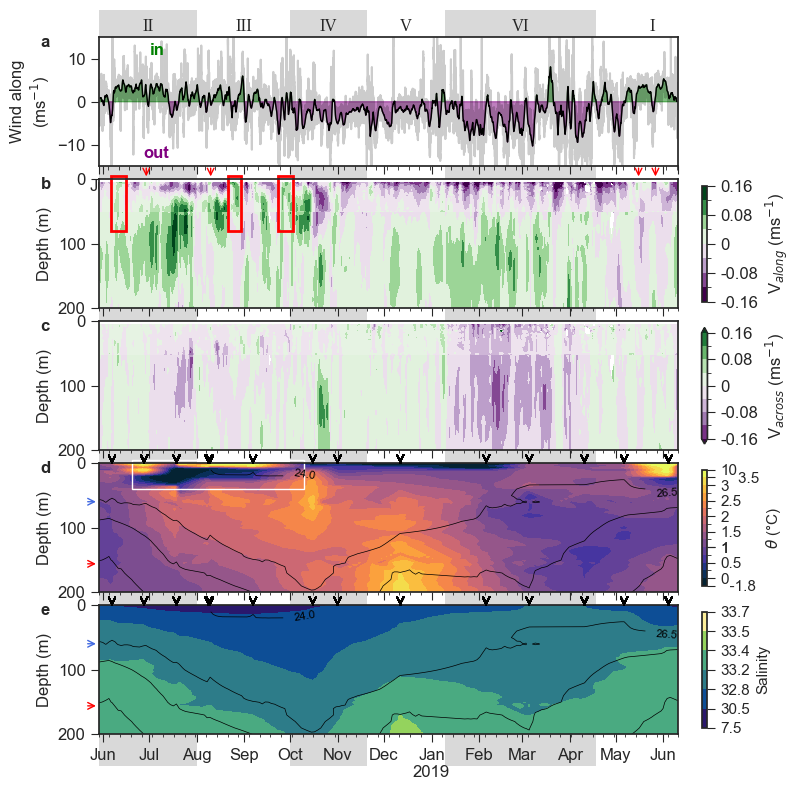

In [43]:
import cmocean as cmo
from datetime import datetime, timedelta
import matplotlib.patches as mpatches
# NOTE THAT UPPER CTD IS NOT TAKING INTO ACCOUNT CURRENTLY

plt.style.use('seaborn-ticks')
plt.rcParams.update({'font.size': 12})
John=False


pd.options.plotting.backend = "matplotlib"

fontsize_ticks = 12
fontsize_alpha = 12
fontsize_clabel = 8
fontsize_cbar = 11

levels = [-185, -100, -50, -25, -10, 0,10, 25, 50, 100, 185]
levels = np.array(levels)/1000.
max_cbar = 0.16
levels = np.arange(-max_cbar, max_cbar*1.001, 0.04).round(3)

cmap_velo = 'PRGn'
cmap = cmap_velo
if John:
    levels = [-0.3, -0.12, -0.08, -0.04, 0,  0.04, 0.08, 0.12, 0.3 ]
    cmap =  mpl.colors.ListedColormap(['red', 'orange', 'yellow', 'lawngreen', 'cyan','cornflowerblue', 'darkblue', 'violet'][::-1])
zlim = [200, 0]
datelim = [datetime(2018, 5,29), datetime(2019, 6, 11)]

cdepth =['cyan','royalblue',  'red','black', 'green'][::-1]


cm = 1/2.54  # centimeters in inches
mm = cm/10.  # millimeters in inches

fig, ax = plt.subplots(5,1, figsize=(190*mm, 230*mm), sharex=False, sharey=False)


resample_time = '25h'

# if min(zlim) <60:
#==================================================================================================
# Surfer plot Velocity
#==================================================================================================

def remove_outliers(ds, outlier_lim):
    return ds.where((ds >= -outlier_lim) & (ds <= outlier_lim))
ds_300 =  (ds_velo_300/1000).resample(time=resample_time).mean()
ds_75 = (ds_velo_75/1000).sel(z=slice(zlim[0]+5,None)).resample(time=resample_time).mean()

axALONG = ax[1]
axACROSS = ax[2]
axT = ax[3]
axS = ax[4]
axU = ax[0]

TSplots = [3,4]
VELOplots = [1,2]
HYDROplots = [1,2,3,4]

contour_velo = ds_75.Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels, extend=None, add_colorbar=False)
ds_300.Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
ds_75.Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = ds_300.Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels,  add_colorbar=False,extend=None)
cax = axALONG.inset_axes( [1.04, 0.05, 0.01, 0.9] )    
cax2 = axACROSS.inset_axes( [1.04, 0.05, 0.01, 0.9] )
# colorbar ticks = levels

cbar0 = fig.colorbar(contour_velo, orientation='vertical', label=r'V$_{along}$ (ms$^{-1}$)', ticks=levels[::2], ax =axALONG, cax=cax)
cbar1 = fig.colorbar(cvelo_cross, orientation='vertical', label=r'V$_{across}$ (ms$^{-1}$)', ticks=levels[::2], ax =axACROSS, cax=cax2)
for cbar in [cbar0, cbar1]: cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))


# for i in range(1): 
#     # ax[i].axhline(y=34.5, color='white', linestyle='dashed') # add horizontal line
#     ax[i].set_ylabel('Depth [m]')
# plt.gca().invert_yaxis()
# plt.ylim(zlim)
# axALONG.set_title('Along fjord')
# axACROSS.set_title('Across fjord')
# axACROSS.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
# axACROSS.xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
# axACROSS.set_xlabel('')

# remove all ticks and labels from top plot
# axALONG.tick_params(labelbottom=False, bottom=False, top=False, labeltop=False)
# axALONG.set_xlabel('')
# remove hspace
plt.subplots_adjust(hspace=0.15)
# for axpatch in ax: axpatch.add_patch(get_background_patch(axpatch))

# density
cmap_dens = cmocean.cm.dense
short_label = r'$\sigma$ (kg m$^{-3}$)'
#==================================================================================================
# Surfer plot Temperature and salinity
#==================================================================================================
for variable, i in zip(['Potential temperature [°C]', 'Salinity [PSU]'], TSplots):
    ticks= None
    levels_f, cmap, var, levels_l, norm, short_label= set_cbar(variable)
    # if var == 'temp':
    #     levels_f = np.arange(0,3.1, 0.3)
    cax = ax[i].inset_axes( [1.04, 0.05, 0.01, 0.9] )
    cmap = mpl.colors.ListedColormap(['blue', 'cyan', 'forestgreen', 'red', 'purple', 'yellow'])
    contour_colors= 'black'
    if var == 'temp':
        if not John: cmap = mpl.colors.ListedColormap(cmo.cm.thermal(np.linspace(0, 1, 15)))
        # bounds = [-1.8, 0, 0.75, 1.5, 2.25,  3, 4, 10] 
        # norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        # levels_l = np.concatenate([np.arange(-1.8, 0.5, 0.5), np.arange(0.5, 2.0, 0.25), np.arange(2.0, 5.8, 0.5), [10]])
        bounds =[-1.8, 0,0.25, 0.5, 0.75, 1, 1.25, 1.5, 1.75, 2,2.25, 2.5,2.75,3, 3.5 , 10] 
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        levels_l = [-1.8, 0, 1,  2,  3, 3.5, 10] 
        # contourcolors = where levels_l is zero or lower, white, else black
        contourcolors = ['white' if x <= 0 else 'black' for x in levels_l]
        ticks = [-1.8, 0, 0.5,  1,  1.5, 1, 2, 2.5,3, 3.5 , 10] 
        ticklabels = ["  -1.8", 0, 0.5,  1,  1.5, 1, 2, 2.5,3, "    3.5" , 10] 
    elif var == 'sal':
        if not John: cmap = mpl.colors.ListedColormap(cmo.cm.haline(np.linspace(0, 1, 6)))
        bounds = [7.5, 30.5, 32.8, 33.2, 33.4,  33.5, 33.7]
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
        levels_l = np.sort(np.concatenate([np.arange(30, 33, 1), np.arange(33,33.55, 0.1), [33.45,33.55], np.arange(33.6, 35.1, 0.4)]))
        short_label = 'Salinity'
        # contourcolors = where levels_l is 33.2 or lower, white, else black

        contourcolors = ['white' if x <= 33 else 'black' for x in levels_l]

        
    cbar = fig.colorbar(
        mpl.cm.ScalarMappable(cmap=cmap, norm=norm),
        cax=cax,
        ax = ax[i],
        extend=None, 
        ticks=bounds,
        spacing='uniform',
        orientation='vertical',
    )

    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))
    cbar.set_label(     label=short_label,size=fontsize_cbar)
    cbar.ax.tick_params(labelsize=fontsize_cbar)
    if ticks is not None:
        cbar.set_ticks(ticks)
        cbar.set_ticklabels(ticklabels)
        print(f"We set ticklabels for {var}")
    # set cbar title 
    xi, yi, xi_date, zi = gridded_temp_sal[variable]['xi'], gridded_temp_sal[variable]['yi'], gridded_temp_sal[variable]['xi_date'], gridded_temp_sal[variable]['zi']

    contourf = ax[i].contourf(xi_date, yi, zi, levels=bounds, norm=norm, cmap=cmap, extend=None)
    # contourl = ax[i].contour(xi_date, yi, zi, levels=levels_l, linewidths= 0.5, colors=contourcolors)
    # ax[i].clabel(contourl, inline=1, fontsize=fontsize_clabel, levels=levels_l, fmt=fmt_label)
    contourl = ax[i].contour(xi_date_dens, yi_dens, z_dens, levels=levels_sigmadens_new, linewidths= 0.5, colors ='black')
    ax[i].clabel(contourl, inline=True, fontsize=fontsize_clabel, rightside_up=True, inline_spacing=1, )


    add_arrows_for_sampling_loc(mean_pres, ax[i], arrowhead=0, arrowtail=-5, zlim=[zlim[0], 6], datelim=datelim, color_mooring=cdepth)
    format_surfer(short_label, levels_f, fig, ax[i], contourf, None)

# contourl = axS.contour(xi_date, yi, zi, levels=[33.5, 33.55], linewidths= 0.5, colors='black')
# axS.clabel(contourl, inline=1, fontsize=8,levels=[33.5, 33.55])

ylabels = np.repeat(['Depth (m)'],5)
for i in HYDROplots:
    ax[i].set_ylabel(ylabels[i])
    ax[i].tick_params(axis='x', length=3, which='minor')
    ax[i].tick_params(axis='x', length=6, which='major')


yloc = [0.075, 0.91]
xlocs = ['May 29, 2018', 'August 1, 2018', 'October 1, 2018', 'November 20, 2018', 'January 10, 2019', 'April 18, 2019', 'July 1, 2019']
phases = ['II', 'III', 'IV', 'V', 'VI', 'I']
xlocs = pd.to_datetime(xlocs)
print(f"Adding phases")
for i in range(len(xlocs)-1):
    xloc_text = xlocs[i] + (xlocs[i+1]-xlocs[i])/2
    # draw_vertical_line_across_subplots(fig, ax[0], xlocs[i], yloc=yloc, color='lightgrey',linewidth=2)
    add_text_to_ax(ax[0], xloc_text, f'{phases[i]}', fontsize=fontsize_alpha)
    if i%2 ==0:
        width =  xlocs[i+1]-xlocs[i]
        height = yloc[1]-yloc[0]

        rectangle = mpatches.Rectangle((xlocs[i], yloc[0]), width, height, linewidth=0, edgecolor=None, facecolor='black', clip_on=False, alpha=0.15,  transform=blended_transform_factory(ax[0].transData,fig.transFigure), zorder=0)
        ax[0].add_patch(rectangle)
        # rectangle_edge = mpatches.Rectangle((xlocs[i], yloc[0]), width, height, linewidth=2, edgecolor='white', clip_on=False,  transform=blended_transform_factory(ax[0].transData,fig.transFigure), zorder=10, facecolor='white')
        # ax[-1].add_patch(rectangle_edge)

        # # add white line
        # if i>0:
        #     xline = [xlocs[i], xlocs[i], xlocs[i+1], xlocs[i+1], xlocs[i]]
        #     yline = [yloc[0], yloc[1], yloc[1], yloc[0], yloc[0]]
        #     ax[-1].plot(xline, yline, transform= blended_transform_factory(ax[-1].transData, fig.transFigure), clip_on=False, zorder=10, color='white', linewidth=2)


# ===== add reversal triangles ====
if zlim[0] <=200:
    start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23), ]
    end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3), ]
    top = -5
    bottom = 80
    rect_subglacial = mpatches.Rectangle((datetime(2018, 6, 20), top), datetime(2018, 10, 10)-datetime(2018, 6, 20), 45, linewidth=1, edgecolor='white', facecolor='none', alpha=1, clip_on=False)
    axT.add_patch(rect_subglacial)
    # Adding reversal triangles and boxes
    colors_rev = ['red', 'red', 'red', 'red', 'red']
    for i in range(len(start)):
        rect = mpatches.Rectangle((start[i], top), end[i]-start[i], bottom-top, linewidth=2, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False)
        axALONG.add_patch(rect)
        # ax[4].add_patch( mpatches.Rectangle((start[i], -13), end[i]-start[i], 26, linewidth=1, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False))

    print("Adding wind")

    rectangle = mpatches.Rectangle((0,0), 1, 1, linewidth=0, edgecolor=None, facecolor='white', clip_on=True, alpha=1, transform=ax[0].transAxes, zorder=1)
    ax[0].add_patch(rectangle)
    
    ds_nia_select = xr.open_dataset('intermediate/nia_select2.nc')
    ds_nia_select = ds_nia_select.sel(time=slice(datelim[0], datelim[1]))
    # 24 hour rolling mean
    wind_rolling = ds_nia_select['V_200cm_rotated'].dropna(dim='time').rolling(time=6*48,center=True).mean().to_dataframe()
    wind_rolling.plot(ax=axU, color='black', linewidth=1, label="")
    axU.set_xlim(datelim)

    axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']>=0, color='green', interpolate=True, alpha=0.5)
    axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']<0, color='purple', interpolate=True, alpha=0.5)
    ds_nia_select['V_200cm_rotated'].dropna(dim='time').to_dataframe().plot(ax=axU, color='black', alpha=0.2, label="")
    # # add prssure
    axU.set_ylabel("Wind along\n"+"(ms$^{-1}$)")
    axU.text(0.1, 0.9, "in", transform=axU.transAxes, fontsize=fontsize_alpha, fontweight='bold', va='center', ha='center', color='green')
    axU.text(0.1, 0.1, "out", transform=axU.transAxes, fontsize=fontsize_alpha, fontweight='bold', va='center', ha='center', color='purple')
    axU.set_ylim([-15,15])
    # axP = axU.twinx()
    dfP = ds_nia_select['QFE'].dropna('time').to_dataframe().rolling(window=12*3, center=True).mean() # original data is 5 min
    # (dfP).plot(ax=axP, color='red', linewidth=1)
    # axP.set_ylabel('Pressure (hPa)')
    # axP.set_ylim([int(dfP.mean())-30, int(dfP.mean())+30])
    axU.set_facecolor('white')

    if axU.get_legend() is not None:
        axU.get_legend().remove()
    axU.set_xlabel("")

    add_arrows(date1 = pd.to_datetime('2018-06-29'), y1=0, date2 = pd.to_datetime('2018-08-10'), y2=10, ax=axALONG)
    # also add arrows for 2018-05-16 and 2018-05-23
    add_arrows(date1 = pd.to_datetime('2019-05-16'), y1=0, date2 = pd.to_datetime('2019-05-27'), y2=10, ax=axALONG)

else:
    print("Adding inflow boxes")
    start =['October 5, 2018', 'April 15, 19']
    end =[ 'Nov 25, 18',  'May 29, 19']
    bottom = [400, 535]
    top = [100, 380]
    text_rectangles = ["1", "2"]

    start = [pd.to_datetime(x) for x in start]
    end = [pd.to_datetime(x) for x in end]

    for axx in ax:
        axx.patch.set_facecolor('none')

    for i in range(len(start)):
        rect = mpatches.Rectangle((start[i], top[i]), end[i]-start[i], bottom[i]-top[i], linewidth=1, edgecolor='red', facecolor='none', alpha=1, clip_on=False)
        axALONG.add_patch(rect)
        # add text to rectangles in bottom left corner
        axALONG.text((start[i]+pd.Timedelta(days=3)), bottom[i]-3,   text_rectangles[i], fontsize=fontsize_alpha, fontweight='bold', va='bottom')

    start_win = 'Jan 1, 2019'
    end_win = 'April 14, 2019'
    top_win = 30
    bottom_win = 350

    for i in VELOplots:
        rect = mpatches.Rectangle((pd.to_datetime(start_win), top_win), pd.to_datetime(end_win)-pd.to_datetime(start_win), bottom_win-top_win, linewidth=3, edgecolor='red', facecolor='none', alpha=1, clip_on=False, linestyle = ":")
        ax[i].add_patch(rect)

print("Format axes")
for i in HYDROplots:
    ax[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    ax[i].xaxis.set_minor_locator(mdates.WeekdayLocator())
    ax[i].xaxis.set_tick_params(which='minor', length=2, labelsize=fontsize_ticks)
    ax[i].set_ylim(zlim)
    ax[i].set_xlim(datelim)
    if i < len(ax)-1:   
        ax[i].set_xticklabels([])

# # set xticklabels for ax[-1]
# ax[4].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
# ax[4].xaxis.set_minor_locator(mdates.WeekdayLocator())
# ax[4].xaxis.set_ticklabels(
print("Saving figure")
if zlim[0]>200:
    fig.subplots_adjust(hspace=0.075)
else:
    fig.subplots_adjust(hspace=0.1)
dates = pd.date_range(start=datelim[0], end=datelim[1], freq='MS').to_pydatetime().tolist()
ax[-1].set_xticklabels([date.strftime('%b\n%Y') if date.month == 1 else date.strftime('%b') for i, date in enumerate(dates)])

# add a), b), c) etc. to subplots
alphabet = ['a', 'b', 'c', 'd', 'e', 'f']
for i in range(len(ax)):
    ax[i].text(-0.10, 0.9, alphabet[i], transform=ax[i].transAxes, fontsize=fontsize_alpha, fontweight='bold', va='bottom')
# if John: fig.savefig(f"{figpathjohn}/Surfer_plot_temp_sal_{zlim[0]:.0f}.png", dpi=300, bbox_inches='tight')
fig.savefig(f"{figpath}/Surfer T S Combined/Figure3_TS_timeseries_less_colors_phase_{zlim[0]}_{cmap_velo}_box.jpg", dpi=300, bbox_inches='tight')
fig.savefig(f"{figpath}/Surfer T S Combined/Figure3_TS_timeseries_less_colors_phase_draft_{zlim[0]}_{cmap_velo}_box.jpg", dpi=150, bbox_inches='tight')
print("Showing figure")
fig.show()


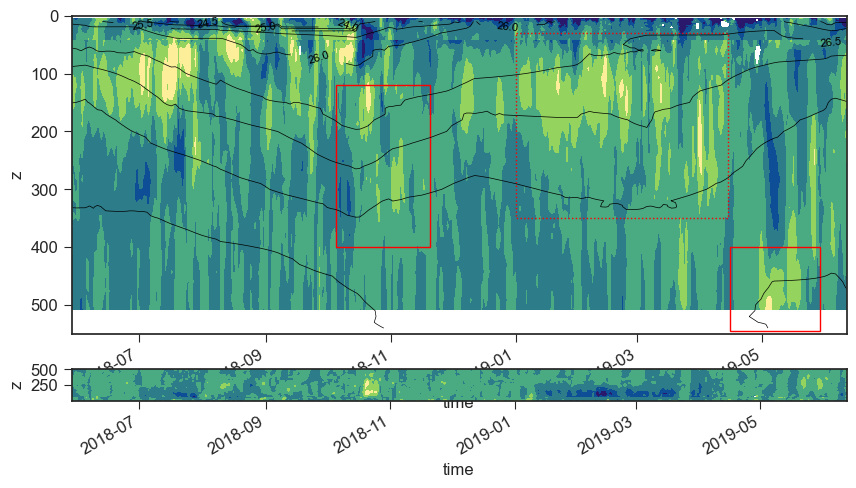

In [44]:
fig, ax = plt.subplots(2,1, figsize=(10,5), gridspec_kw={'height_ratios': [10, 1]})


zlim=[550,0]
# density



(ds_velo_300/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=ax[0], cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
contour_velo = (ds_velo_75/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=ax[0], cmap=cmap, levels=levels, extend=None, add_colorbar=False)
(ds_velo_75/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=ax[1], cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = (ds_velo_300/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=ax[1], cmap=cmap, levels=levels,  add_colorbar=False,extend=None)



cmap_dens = cmocean.cm.dense
short_label = r'$\sigma$ (kg m$^{-3}$)'
var = "sigma-dens"
df_ctd_moor = pd.concat([
    df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
    df_moor_daily.set_index(['Pressure [dbar]', 'date'])[var]])
df_ctd_moor = df_ctd_moor.reset_index().dropna()
df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)
levels_sigmadens = df_ctd_moor.quantile(np.arange(0,1.05,0.05))[var].round(2).to_numpy()
# keep the same color

levels_sigmadens_new = np.sort(np.concatenate([np.arange(24,26.6,0.5), np.arange(26.6,27,0.1)]))

xi_dens = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 2)
yi_dens = np.arange(zlim[1], zlim[0], 10)
xi_date_dens = decimal_day_to_datetime(xi_dens)
valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices])
values = df_ctd_moor[var].to_numpy()[valid_indices]
z_dens = griddata(points, values, (xi_dens[None, :], yi_dens[:, None]), method='linear') 

contourl = ax[0].contour(xi_date_dens, yi_dens, z_dens, levels=levels_sigmadens_new, linewidths= 0.5, colors ='black')
ax[0].clabel(contourl, levels=levels_sigmadens_new, fontsize=fontsize_clabel, inline=1)#, rightside_up=True, inline_spacing=0)

ax[0].set_xlim(datelim)
ax[0].set_ylim(zlim)


yloc = [0.08, 0.9]
start =['October 5, 2018', 'April 15, 19']
end =[ 'Nov 20, 18',  'May 29, 19']
bottom = [400, 545]
top = [120, 400]

start = [pd.to_datetime(x) for x in start]
end = [pd.to_datetime(x) for x in end]

for axx in ax:
    axx.patch.set_facecolor('none')

for i in range(len(start)):
    rect = mpatches.Rectangle((start[i], top[i]), end[i]-start[i], bottom[i]-top[i], linewidth=1, edgecolor='red', facecolor='none', alpha=1, clip_on=False)
    ax[0].add_patch(rect)

start_win = 'Jan 1, 2019'
end_win = 'April 14, 2019'
top_win = 30
bottom_win = 350

rect = mpatches.Rectangle((pd.to_datetime(start_win), top_win), pd.to_datetime(end_win)-pd.to_datetime(start_win), bottom_win-top_win, linewidth=1, edgecolor='red', facecolor='none', alpha=1, clip_on=False, linestyle = ":")
ax[0].add_patch(rect)


In [45]:
from scipy.interpolate import RBFInterpolator
import numpy as np

# Define the coordinates and values
x = df_ctd_moor['days_decimal'].to_numpy()[valid_indices]
y = df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices]
values = df_ctd_moor[var].to_numpy()[valid_indices]

# Combine the coordinates into a 2D array
coordinates = np.vstack((x, y))

# Create a RBFInterpolator
rbfi = RBFInterpolator(coordinates.T, values)

# Define the grid coordinates
xi_date = np.linspace(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), num=100)
yi = np.linspace(zlim[1], zlim[0], num=100)

# Create a grid of coordinates
xi, yi = np.meshgrid(xi_date, yi)

# Grid the data
z_dens = rbfi(np.vstack((xi.ravel(), yi.ravel())).T)

# Reshape the gridded data to match the grid shape
z_dens = z_dens.reshape(xi.shape)

# ... rest of your code ...

In [46]:
(ds_velo_300/1000).resample(time=resample_time).mean().Along_res.sel(time=slice(datelim[0], datelim[1]))

<xarray.DataArray 'Along_res' (time: 363, z: 24)>
array([[-0.03104779, -0.01397703, -0.00690678, ..., -0.0493643 ,
        -0.0553236 , -0.05395561],
       [-0.00992934, -0.00689193, -0.00821585, ..., -0.06179801,
        -0.08208051, -0.08753264],
       [-0.00248302, -0.00471353, -0.00472779, ..., -0.07770142,
        -0.0964121 , -0.10660087],
       ...,
       [ 0.00266466, -0.0074687 , -0.00876227, ..., -0.13270291,
        -0.13693788, -0.13672902],
       [-0.00542583, -0.01209703, -0.01645032, ..., -0.13951408,
        -0.13018188, -0.12783521],
       [ 0.01064462,  0.01221221,  0.00963732, ..., -0.195644  ,
        -0.19648609, -0.1794083 ]])
Coordinates:
  * z        (z) float64 50.79 48.79 46.79 44.79 42.79 ... 10.79 8.79 6.79 4.79
  * time     (time) datetime64[ns] 2018-05-29 ... 2019-06-10T02:00:00

Text(-0.06, 0.9, 'd')

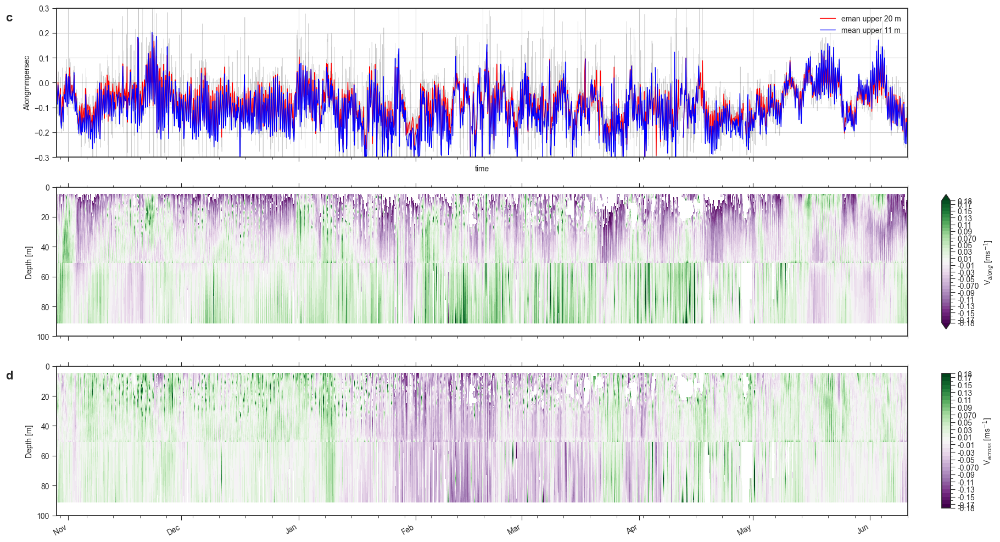

In [157]:
import cmocean as cmo
from datetime import datetime, timedelta

plt.style.use('seaborn-ticks')
plt.rcParams.update({'font.size': 10})
John=False

cmap = 'PRGn'
if John:
    levels = [-0.3, -0.12, -0.08, -0.04, 0,  0.04, 0.08, 0.12, 0.3 ]
    cmap =  mpl.colors.ListedColormap(['red', 'orange', 'yellow', 'lawngreen', 'cyan','cornflowerblue', 'darkblue', 'violet'][::-1])
zlim = [100, 0]
datelim = [datetime(2018, 5,29), datetime(2018, 11, 11)]
datelim = [datetime(2018, 5,29), datetime(2019, 6, 11)]
datelim = [datetime(2018, 10,29), datetime(2019, 6, 11)]

max_cbar = 0.18
levels = np.arange(-max_cbar, max_cbar*1.001, 0.01).round(3)
ticks = np.concatenate([[levels[0]], levels[1::2], [levels[-1]]])

cdepth =['cyan','royalblue',  'red','black', 'green'][::-1]

cm = 1/2.54  # centimeters in inches
mm = cm/10.  # millimeters in inches
fig, ax = plt.subplots(3,1,  figsize = (20, 12), sharex=True, sharey=False)

resample_time = '3h'

ax20 = ax[0]
axALONG = ax[1]
axACROSS = ax[2]

upper20m =  (ds_velo_300.Alongmmpersec.sel(z=slice(20,None)).mean(dim='z')/1000)
upper20m.plot(ax=ax20, color='black', linewidth=0.5, alpha=0.2)
upper20m_res = upper20m.resample(time=resample_time).mean()
upper20m_res.plot(ax=ax20, color='red', linewidth=1, label="eman upper 20 m")
ax20.fill_between(upper20m_res.time.values, upper20m_res.where(upper20m_res > 0), color='red', alpha=0.3)
upper11m_res = (ds_velo_300.Alongmmpersec.sel(z=slice(11,None)).mean(dim='z')/1000).resample(time=resample_time).mean()
upper11m_res.plot(ax=ax20, color='blue', linewidth=1, label="mean upper 11 m")
ax20.fill_between(upper11m_res.time.values, upper11m_res.where(upper11m_res > 0), color='blue', alpha=0.3)
ax20.legend()

ds_300 = remove_outliers( (ds_velo_300/1000).resample(time=resample_time).mean(), max_cbar)
ds_75 = ((ds_velo_75/1000).sel(z=slice(zlim[0]+5,None)).resample(time=resample_time).mean())
contour_velo = ds_75.Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels, extend=None, add_colorbar=False)
ds_300.Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
ds_75.Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = ds_300.Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels,  add_colorbar=False,extend=None)
cax = axALONG.inset_axes( [1.04, 0.05, 0.01, 0.9] )    
cax2 = axACROSS.inset_axes( [1.04, 0.05, 0.01, 0.9] )
# colorbar ticks = levels

cbar0 = fig.colorbar(contour_velo, orientation='vertical', label=r'V$_{along}$ (ms$^{-1}$)',  ax =axALONG, cax=cax,ticks=ticks)
cbar1 = fig.colorbar(cvelo_cross, orientation='vertical', label=r'V$_{across}$ (ms$^{-1}$)', ax =axACROSS, cax=cax2,ticks=ticks)
for cbar in [cbar0, cbar1]: cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))

for i in range(1,3): 
    ax[i].set_ylabel('Depth [m]')
    ax[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    ax[i].xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
    ax[i].xaxis.set_major_formatter(mdates.DateFormatter('%b')) 
    # add ticks on top
    ax[i].set_xlabel("")
    ax[i].xaxis.set_ticks_position('both')  # Add this line to add ticks on the top and bottom
    ax[i].set_ylim(zlim)


ax[i].set_xlim(datelim)


ax20.set_ylim([-.3, .3])
ax20.grid()
# ===== add reversal triangles ====
start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23), ]
end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3),]
top = -15
bottom = 80
# for i in range(len(start)):
#     rect = mpatches.Rectangle((start[i], top), end[i]-start[i], bottom-top, linewidth=1, edgecolor='red', facecolor='none', alpha=1, clip_on=False)
#     axALONG.add_patch(rect)

# give them letters c d
axALONG.text(-0.06, 0.9, 'c', transform=ax[0].transAxes, fontsize=16, fontweight='bold', va='bottom')
axACROSS.text(-0.06, 0.9, 'd', transform=axACROSS.transAxes, fontsize=16, fontweight='bold', va='bottom')



# fig.savefig(f"{figpath}/Surfer plot/reversals.jpg",  dpi=300, bbox_inches='tight')
# reduce 


In [153]:
ds_75

<xarray.Dataset>
Dimensions:         (z: 4, time: 3031)
Coordinates:
  * z               (z) float64 91.26 75.26 59.26 43.26
  * time            (time) datetime64[ns] 2018-05-29T15:00:00 ... 2019-06-12T...
Data variables:
    SerEmmpersec    (time, z) float64 0.014 0.01067 0.005333 ... 0.052 -0.005
    SerNmmpersec    (time, z) float64 0.014 0.01267 0.034 ... -0.033 -0.013
    SerVmmpersec    (time, z) float64 -0.008 -0.009 -0.01333 ... -0.0065 0.0025
    SerErmmpersec   (time, z) float64 -0.008667 0.0 -0.014 ... -0.031 -0.0125
    SerMagmmpersec  (time, z) float64 0.02667 0.02233 0.04167 ... 0.0615 0.014
    SerDir10thDeg   (time, z) float64 1.005 1.258 1.214 ... 1.752 1.188 2.017
    SerPG4          (time, z) float64 0.1 0.1 0.1 ... 0.0925 0.0325 0.0875
    flag            (time, z) float64 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
Attributes:
    units:    mm/s

In [113]:
upper11m_res.where(upper11m_res > 0)# Create a boolean mask where upper11m_res > 0
# Get the times where upper11m_res > 0
times = upper11m_res.where(upper11m_res > 0).dropna(dim='time', how='all').time

if resample_time != '12h':
    print("Fix your resample time")

start_list = []
end_list = []
start = times[0]
for i in range(len(times)):
    if times[i] == start:
        interval_list = []
        interval_list.append(start)
    elif pd.to_timedelta(times[i].values-times[i-1].values) == pd.Timedelta(hours=12):
        # if there is a 12 hour difference, add to the interval list
        interval_list.append(times[i].values)
    else: 
        # if there is a larger difference, append the start and end of the interval list, and 
        if len(interval_list)>1:
            start_list.append(np.datetime_as_string(interval_list[0], unit='s'))
            end_list.append(np.datetime_as_string(interval_list[-1], unit='s'))
            interval_list = []
        else:
            start = times[i]
            interval_list = []
            interval_list.append(start)


reversals_start = start_list
reversals_end = end_list


In [114]:
reversals_red_start = ['2018-06-09T00:00:00', '2018-09-25T12:00:00','2018-09-30T12:00:00',  '2018-06-28T00:00:00','2018-08-09T00:00:00',]

reversals_red_end = ['2018-06-16T00:00:00','2018-09-29T12:00:00','2018-10-01T12:00:00','2018-06-29T00:00:00', '2018-08-10T00:00:00', ]

red_ones = [0, 1, 3, 6, 7]

reversals_red_end = [reversals_end[i] for i in red_ones]
reversals_red_start = [reversals_start[i] for i in red_ones]

reversals_end_black = [date for date in reversals_end if date not in reversals_red_end]
reversals_start_black = [date for date in reversals_start if date not in reversals_red_start]



In [78]:
from plot_wind_DMI import w_select

In [133]:
w_select.columns

Index([    'Station',        'Year',       'Month',         'Day',
              'hour', 'temperature',           nan,           nan,
                 nan,           nan,           nan,       'speed',
                 nan,   'direction',           nan,    'pressure',
                 nan,       'month',        'year',  'Month_name',
                 'u',           'v'],
      dtype='object')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


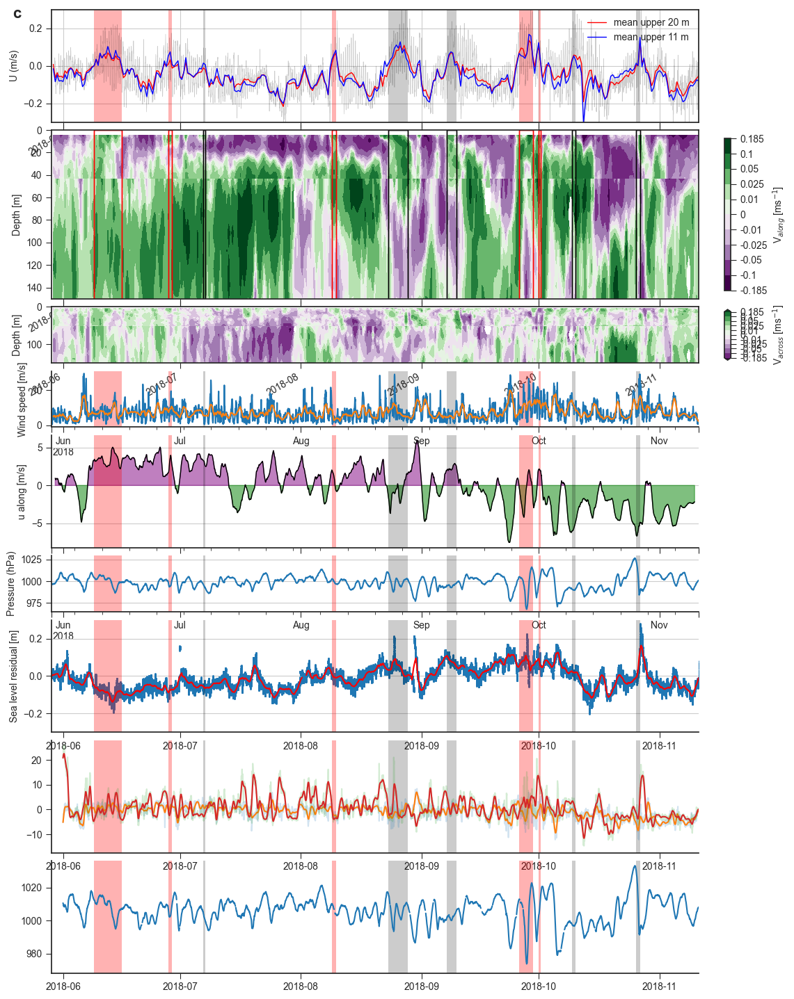

In [135]:
import cmocean as cmo
from datetime import datetime, timedelta

plt.style.use('seaborn-ticks')
plt.rcParams.update({'font.size': 10})
John=False
pd.options.plotting.backend = "matplotlib"

levels = [-185, -100, -50, -25, -10, 0,10, 25, 50, 100, 185]
levels = np.array(levels)/1000.
cmap = 'PRGn'
zlim = [150, 0]
datelim = [datetime(2018, 5,29), datetime(2018, 11, 11)]
# datelim = [datetime(2018, 6,1), datetime(2018, 6, 17)]
# datelim = [datetime(2018, 8,18), datetime(2018, 9, 3)]
# datelim = [datetime(2018, 9,20), datetime(2018, 10, 6)]
# datelim = [datetime(2019, 5,10), datetime(2019, 5, 26)]


cdepth =['cyan','royalblue',  'red','black', 'green'][::-1]

cm = 1/2.54  # centimeters in inches
mm = cm/10.  # millimeters in inches
fig, ax = plt.subplots(9,1,  figsize = (12, 18), sharex=False, sharey=False, gridspec_kw={'height_ratios': [2, 3,1,1,2,1, 2, 2,2]})

resample_time = '12h'

ax20 = ax[0]
axALONG = ax[1]
axACROSS = ax[2]

upper20m =  (ds_velo_300.Alongmmpersec.sel(z=slice(20,None)).mean(dim='z')/1000)
upper20m.plot(ax=ax20, color='black', linewidth=0.5, alpha=0.2)
upper20m_res = upper20m.resample(time=resample_time).mean()
upper20m_res.plot(ax=ax20, color='red', linewidth=1, label="mean upper 20 m")
# ax20.fill_between(upper20m_res.time.values, upper20m_res.where(upper20m_res > 0), color='red', alpha=0.3)
upper11m_res = (ds_velo_300.Alongmmpersec.sel(z=slice(11,None)).mean(dim='z')/1000).resample(time=resample_time).mean()
upper11m_res.plot(ax=ax20, color='blue', linewidth=1, label="mean upper 11 m")
# ax20.fill_between(upper11m_res.time.values, upper11m_res.where(upper11m_res > 0), color='blue', alpha=0.3)
ax20.legend()

(ds_velo_300/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
contour_velo = (ds_velo_75/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels, extend=None, add_colorbar=False)
(ds_velo_75/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = (ds_velo_300/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels,  add_colorbar=False,extend=None)
cax = axALONG.inset_axes( [1.04, 0.05, 0.01, 0.9] )    
cax2 = axACROSS.inset_axes( [1.04, 0.05, 0.01, 0.9] )
# colorbar ticks = levels

cbar0 = fig.colorbar(contour_velo, orientation='vertical', label=r'V$_{along}$ (ms$^{-1}$)', ticks=levels, ax =axALONG, cax=cax)
cbar1 = fig.colorbar(cvelo_cross, orientation='vertical', label=r'V$_{across}$ (ms$^{-1}$)', ticks=levels, ax =axACROSS, cax=cax2)
for cbar in [cbar0, cbar1]: cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))

for i in range(1,3): 
    ax[i].set_ylabel('Depth [m]')
    # ax[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    # ax[i].xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
    # ax[i].xaxis.set_major_formatter(mdates.DateFormatter('%b')) 
    # add ticks on top
    ax[i].set_xlabel("")
    ax[i].xaxis.set_ticks_position('both')  # Add this line to add ticks on the top and bottom
    ax[i].set_ylim(zlim)


    ax[i].set_xlim(datelim)
ax20.set_xlim(datelim)
ax20.set_ylabel("U (m/s)")


ax20.set_ylim([-.3, .3])
ax20.grid()
# ===== add reversal triangles ====
start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23), ]
end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3),]
colors_rev = ['red', 'black', 'red']
top = -15
bottom = 80
# for i in range(len(start)):
#     rect = mpatches.Rectangle((start[i], top), end[i]-start[i], bottom-top, linewidth=1, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False)
#     axALONG.add_patch(rect)

# give them letters c d
axALONG.text(-0.06, 0.9, 'c', transform=ax[0].transAxes, fontsize=16, fontweight='bold', va='bottom')


axWS = ax[3]
axU = ax[4]
axP = ax[5]
axSL = ax[6]

df_sea_level = pd.read_csv('intermediate/sea_level.csv', index_col=0, parse_dates=True)
axSL.scatter(df_sea_level.index, df_sea_level.residual, s=1)
axSL.plot(df_sea_level.index, df_sea_level.residual.rolling(12*25, center=True).mean(), color='red')
# add grid to sea level
axSL.grid(axis='y')
axSL.set_ylabel("Sea level residual [m]")
axSL.set_ylim([-0.3, 0.3])

ds_nia_select = xr.open_dataset('intermediate/nia_select2.nc')
ds_nia_select = ds_nia_select.sel(time=slice(datelim[0], datelim[1]))
# ds_nia_select['WS_200cm_rolling'] = ds_nia_select['WS_200cm'].dropna(dim='time').rolling(time=6*24,center=True).mean()
ds_nia_select['WS_200cm'].dropna('time').resample(time='h').mean().to_dataframe().plot(ax=axWS, label='Hourly')
ds_nia_select['WS_200cm_rolling'].resample(time='h').mean().to_dataframe().plot(ax=axWS)


ds_nia_select = xr.open_dataset('intermediate/nia_select2.nc')
ds_nia_select = ds_nia_select.sel(time=slice(datelim[0], datelim[1]))


# 24 hour rolling mean
wind_rolling = ds_nia_select['V_200cm_rotated'].dropna(dim='time').rolling(time=6*48,center=True).mean().to_dataframe()
wind_rolling.plot(ax=axU, color='black', linewidth=1)
axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']>=0, color='purple', interpolate=True, alpha=0.5)
axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']<0, color='green', interpolate=True, alpha=0.5)


# add prssure
ds_nia_select['QFE'].dropna('time').resample(time='h').mean().to_dataframe().plot(ax=axP)
axWS.set_ylabel("Wind speed [m/s]")
axU.set_ylabel("u along [m/s]")
axU.grid(axis='y')
axP.grid(axis='y')
axP.set_ylabel("Pressure (hPa)")
axU.set_xticklabels([])

df_sea_level = pd.read_csv('intermediate/sea_level.csv')



start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23)]
end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3),]


# for i in range(len(start)):
#     rect = mpatches.Rectangle((start[i], -37), end[i]-start[i], 52,  linewidth=1, edgecolor='r', facecolor='none', alpha=1, clip_on=False)
#     if end[i]<datelim[1]:
#         if start[i] > datelim[0]:
#             axWS.add_patch(rect)

for axx in [axWS, axU,axP, axSL]:
    axx.legend().remove()
    axx.spines['right'].set_visible(False)
    axx.spines['top'].set_visible(False)
    axx.set_xlim(datelim)
    axx.set_xlabel('')
    axx.patch.set_alpha(0)
for i in range(len(reversals_start_black)):
    for axx in [axWS, axU,axP, ax20, axSL]:
        axx.axvspan(reversals_start_black[i], reversals_end_black[i], color='black', alpha=0.2, lw=0)
    axALONG.axvspan(reversals_start_black[i], reversals_end_black[i], fill=False, edgecolor='black',  lw=1)
    # for axx in [axALONG, axACROSS]:
    #     axx.axvspan(reversals_start_black[i], reversals_end_black[i], color='black', lw=1, fill=False)
for i in range(len(reversals_red_start)):
    for axx in [axWS, axU,axP, ax20, axSL]:
        axx.axvspan(reversals_red_start[i], reversals_red_end[i], color='red', alpha=0.3, lw=0)
    axALONG.axvspan(reversals_red_start[i], reversals_red_end[i], fill=False, edgecolor='red',  lw=1)
    # for axx in [axALONG, axACROSS]:
    #     axx.axvspan(reversals_red_start[i], reversals_red_end[i], color='red', lw=1.5, fill=False)


axU = ax[7]
axV = ax[7]
axPDMI = ax[8]

N, Wn = 2, 0.04  # Example values, adjust based on your data
b, a = butter(N, Wn, btype='low', fs=1)  # fs=1.0 assumes your data's sampling frequency is 1 Hz, hourly

timecol = pd.to_datetime(w_select.index)
axU.plot(timecol, w_select['u'], alpha=0.2)
w_select_interpolated = w_select.interpolate()
axU.plot(timecol, filtfilt(b, a, w_select_interpolated['u']))
# # same for V
axV.plot(timecol, w_select['v'], alpha=0.2)
axV.plot(timecol, filtfilt(b, a, w_select_interpolated['v']))
axU.set_xlim(datelim)
axV.set_xlim(datelim)
axU.grid()
axV.grid()

axPDMI.plot(timecol, w_select['pressure']) 

for axx in [ax[7], ax[8]]:
    axx.legend().remove()
    axx.spines['right'].set_visible(False)
    axx.spines['top'].set_visible(False)
    axx.set_xlim(datelim)
    axx.set_xlabel('')
    axx.patch.set_alpha(0)
for i in range(len(reversals_start_black)):
    for axx in [ax[7], ax[8]]:
        axx.axvspan(reversals_start_black[i], reversals_end_black[i], color='black', alpha=0.2, lw=0)
    axALONG.axvspan(reversals_start_black[i], reversals_end_black[i], fill=False, edgecolor='black',  lw=1)
    # for axx in [axALONG, axACROSS]:
    #     axx.axvspan(reversals_start_black[i], reversals_end_black[i], color='black', lw=1, fill=False)
for i in range(len(reversals_red_start)):
    for axx in [ax[7], ax[8]]:
        axx.axvspan(reversals_red_start[i], reversals_red_end[i], color='red', alpha=0.3, lw=0)
    axALONG.axvspan(reversals_red_start[i], reversals_red_end[i], fill=False, edgecolor='red',  lw=1)
    # for axx in [axALONG, axACROSS]:
    #     axx.axvspan(reversals_red_start[i], reversals_red_end[i], color='red', lw=1.5, fill=False)

fig.subplots_adjust(hspace=0.08)
# fig.savefig(f"{figpath}/Surfer plot/reversals_7_in_1_{datelim[0]}_{datelim[-1]}.jpg",  dpi=300, bbox_inches='tight')
# reduce 



Text(0.5, 0, '')

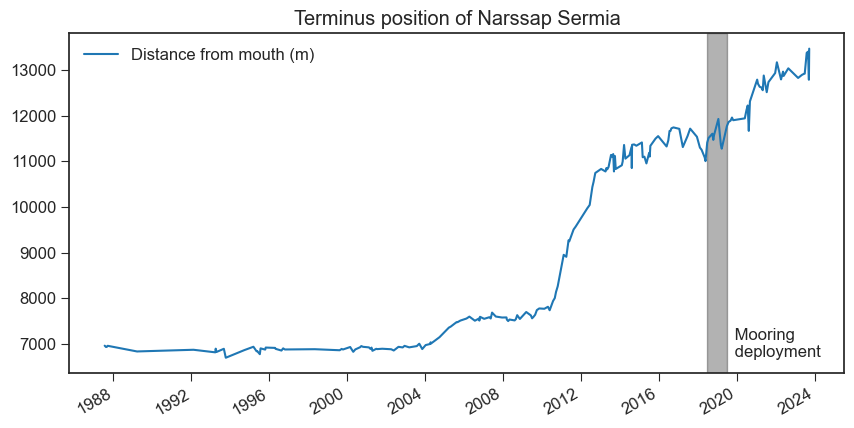

In [150]:
df_terminus = pd.read_csv("/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Data/Terminus_combined.csv")
df_terminus.Date  = pd.to_datetime(df_terminus.Date)

fig, ax = plt.subplots(1,1, figsize=(10,5))
df_terminus.set_index('Date').plot(ax=ax)
ax.axvspan(xmin=datetime(2018, 6, 6), xmax=datetime(2019, 6, 16), color='black', alpha=0.3)
# add in text to axvspan: mooring time frame
ax.text(datetime(2019, 8, 16), 7e3, " Mooring \n deployment", va='center', ha='left',)
ax.set_title("Terminus position of Narssap Sermia")
ax.set_xlabel("")

## 5 in one

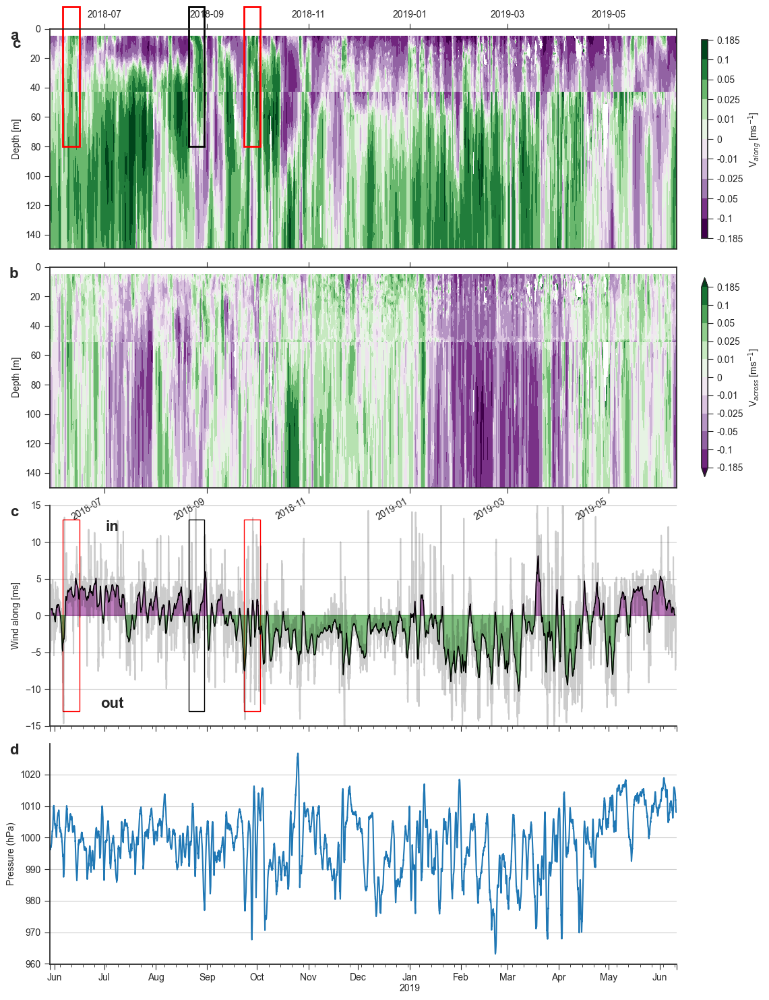

In [59]:
import cmocean as cmo
from datetime import datetime, timedelta

plt.style.use('seaborn-ticks')
plt.rcParams.update({'font.size': 10})
John=False

levels = [-185, -100, -50, -25, -10, 0,10, 25, 50, 100, 185]
levels = np.array(levels)/1000.
cmap = 'PRGn'
zlim = [150, 0]
# datelim = [datetime(2018, 5,29), datetime(2018, 11, 11)]
# datelim = [datetime(2018, 6,1), datetime(2018, 6, 17)]
# datelim = [datetime(2018, 8,18), datetime(2018, 9, 3)]
# datelim = [datetime(2018, 9,20), datetime(2018, 10, 6)]
# datelim = [datetime(2019, 5,10), datetime(2019, 5, 26)]
datelim = [datetime(2018, 5,29), datetime(2019, 6, 11)]



cdepth =['cyan','royalblue',  'red','black', 'green'][::-1]

cm = 1/2.54  # centimeters in inches
mm = cm/10.  # millimeters in inches
fig, ax = plt.subplots(5,1,  figsize = (12, 18), sharex=False, sharey=False, gridspec_kw={'height_ratios': [2, 1, 2, 2, 2]})

resample_time = '12h'

axALONG = ax[0]
axACROSS = ax[1]



start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23)]
end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3),]

start = [datetime(2018, 6, 9), datetime(2018, 8, 22),  datetime(2018, 9, 25)]
end = [datetime(2018, 6, 17),  datetime(2018, 9, 1),  datetime(2018, 10 , 2),]



(ds_velo_300/1000).resample(time=resample_time).mean().sel(tim=sel(start,end)).Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels,  add_colorbar=False, extend=None)
contour_velo = (ds_velo_75/1000).resample(time=resample_time).mean().Along_res.plot.contourf(y='z', robust=True, ax=axALONG, cmap=cmap, levels=levels, extend=None, add_colorbar=False)
(ds_velo_75/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels ,extend=None, add_colorbar=False)
cvelo_cross = (ds_velo_300/1000).resample(time=resample_time).mean().Across_res.plot.contourf(y='z', robust=True, ax=axACROSS, cmap=cmap, levels=levels,  add_colorbar=False,extend=None)
cax = axALONG.inset_axes( [1.04, 0.05, 0.01, 0.9] )    
cax2 = axACROSS.inset_axes( [1.04, 0.05, 0.01, 0.9] )
# colorbar ticks = levels

cbar0 = fig.colorbar(contour_velo, orientation='vertical', label=r'V$_{along}$ (ms$^{-1}$)', ticks=levels, ax =axALONG, cax=cax)
cbar1 = fig.colorbar(cvelo_cross, orientation='vertical', label=r'V$_{across}$ (ms$^{-1}$)', ticks=levels, ax =axACROSS, cax=cax2)
for cbar in [cbar0, cbar1]: cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(format_colorbar_tick))

for i in range(0,2): 
    ax[i].set_ylabel('Depth [m]')
    # ax[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    # ax[i].xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
    # ax[i].xaxis.set_major_formatter(mdates.DateFormatter('%b')) 
    # add ticks on top
    ax[i].set_xlabel("")
    ax[i].xaxis.set_ticks_position('both')  # Add this line to add ticks on the top and bottom
    ax[i].set_ylim(zlim)


    ax[i].set_xlim(datelim)




# give them letters c d
axALONG.text(-0.06, 0.9, 'c', transform=ax[0].transAxes, fontsize=16, fontweight='bold', va='bottom')
axALONG.xaxis.tick_top()

axU = ax[2]
axP = ax[3]
axupper = ax[4]



# ===== add reversal triangles ====
start = [datetime(2018, 6, 6), datetime(2018, 8, 21),  datetime(2018, 9, 23), ]
end = [datetime(2018, 6, 16),  datetime(2018, 8, 30),  datetime(2018, 10 , 3),]
colors_rev = ['red', 'black', 'red']
top = -15
bottom = 80
for i in range(len(start)):
    rect = mpatches.Rectangle((start[i], top), end[i]-start[i], bottom-top, linewidth=2, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False)
    axALONG.add_patch(rect)
    # axU.axvspan(start[i], end[i], color=colors_rev[i], alpha=0.3, lw=1)
    axU.add_patch( mpatches.Rectangle((start[i], -13), end[i]-start[i], 26, linewidth=1, edgecolor=colors_rev[i], facecolor='none', alpha=1, clip_on=False))

ds_nia_select = xr.open_dataset('intermediate/nia_select2.nc')
ds_nia_select = ds_nia_select.sel(time=slice(datelim[0], datelim[1]))


# 24 hour rolling mean
wind_rolling = ds_nia_select['V_200cm_rotated'].dropna(dim='time').rolling(time=6*48,center=True).mean().to_dataframe()
wind_rolling.plot(ax=axU, color='black', linewidth=1)
axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']>=0, color='purple', interpolate=True, alpha=0.5)
axU.fill_between(wind_rolling.index, wind_rolling['V_200cm_rotated'], where=wind_rolling['V_200cm_rotated']<0, color='green', interpolate=True, alpha=0.5)
ds_nia_select['V_200cm_rotated'].resample(time='h').mean().dropna('time').to_dataframe().plot(ax=axU, color='black', alpha=0.2)
# add prssure
ds_nia_select['QFE'].dropna('time').resample(time='h').mean().to_dataframe().plot(ax=axP)
axU.set_ylabel(r"Wind along [ms]")
axU.text(0.1, 0.9, "in", transform=axU.transAxes, fontsize=16, fontweight='bold', va='center', ha='center')
axU.text(0.1, 0.1, "out", transform=axU.transAxes, fontsize=16, fontweight='bold', va='center', ha='center')
axU.set_ylim([-15,15])


axU.grid(axis='y')
axP.grid(axis='y')
axP.set_ylabel("Pressure (hPa)")
axU.set_xticklabels([])





for axx in [ axU,axP]:
    axx.legend().remove()
    axx.spines['right'].set_visible(False)
    axx.spines['top'].set_visible(False)
    axx.set_xlim(datelim)
    axx.set_xlabel('')
    axx.patch.set_alpha(0)



fig.subplots_adjust(hspace=0.08)


alphabet = ['a', 'b', 'c', 'd', 'e', 'f']
for i, letter in enumerate(alphabet):
    if i < len(ax):
        ax[i].text(-0.05, 1., letter, transform=ax[i].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')


# add
# fig.savefig(f"{figpath}/Surfer plot/reversals_5_in_1_{datelim[0]}_{datelim[-1]}.jpg",  dpi=300, bbox_inches='tight')
# reduce 



In [111]:
upper11m_res.where(upper11m_res > 0)# Create a boolean mask where upper11m_res > 0
# Get the times where upper11m_res > 0
times = upper11m_res.where(upper11m_res > 0).dropna(dim='time', how='all').time

start_list = []
end_list = []
start = times[0]
for i in range(len(times)):
    if times[i] == start:
        interval_list = []
        interval_list.append(start)
    elif pd.to_timedelta(times[i].values-times[i-1].values) == pd.Timedelta(hours=12):
        interval_list.append(times[i].values)
    else: 
        start_list.append(np.datetime_as_string(interval_list[0], unit='s'))
        end_list.append(np.datetime_as_string(interval_list[-1], unit='s'))

        start = times[i]
        interval_list = []
        interval_list.append(start)

print(start_list)
print(end_list)

reversals_start = start_list
reversals_end = end_list
# save both in intermediate as csv
start



['2018-06-09T00:00:00', '2018-06-27T00:00:00', '2018-06-28T00:00:00', '2018-06-30T00:00:00', '2018-07-02T12:00:00', '2018-07-07T00:00:00', '2018-08-02T00:00:00', '2018-08-09T00:00:00', '2018-08-22T12:00:00', '2018-08-23T12:00:00', '2018-08-31T00:00:00', '2018-09-07T12:00:00', '2018-09-25T12:00:00', '2018-09-30T12:00:00', '2018-10-03T12:00:00', '2018-10-09T12:00:00', '2018-10-11T12:00:00', '2018-10-26T00:00:00', '2018-10-28T00:00:00', '2018-11-19T12:00:00', '2018-11-21T12:00:00', '2019-01-08T12:00:00', '2019-01-27T00:00:00', '2019-02-11T12:00:00', '2019-02-17T12:00:00', '2019-02-19T12:00:00', '2019-04-05T00:00:00', '2019-04-16T12:00:00', '2019-05-10T12:00:00', '2019-05-15T00:00:00', '2019-05-18T00:00:00', '2019-05-23T12:00:00']
['2018-06-16T00:00:00', '2018-06-27T00:00:00', '2018-06-29T00:00:00', '2018-06-30T12:00:00', '2018-07-02T12:00:00', '2018-07-07T12:00:00', '2018-08-02T00:00:00', '2018-08-10T00:00:00', '2018-08-22T12:00:00', '2018-08-28T12:00:00', '2018-08-31T12:00:00', '2018-09-

<xarray.DataArray 'time' ()>
array('2019-06-02T00:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 2019-06-02

In [108]:
import numpy as np

# Create a np.datetime64 object
date = np.datetime64('2018-06-13T12:00')

# Format the np.datetime64 object as a string
date_str = np.datetime_as_string(date, unit='s')

print(date_str)

2018-06-13T12:00:00


In [122]:
# get a color array form cmcrameri
import cmcrameri
cmap = cmcrameri.cm.hawaii
# make 7 discrete colors from cmap
colors = cmap(np.linspace(0, 1, 7))


# TS plot

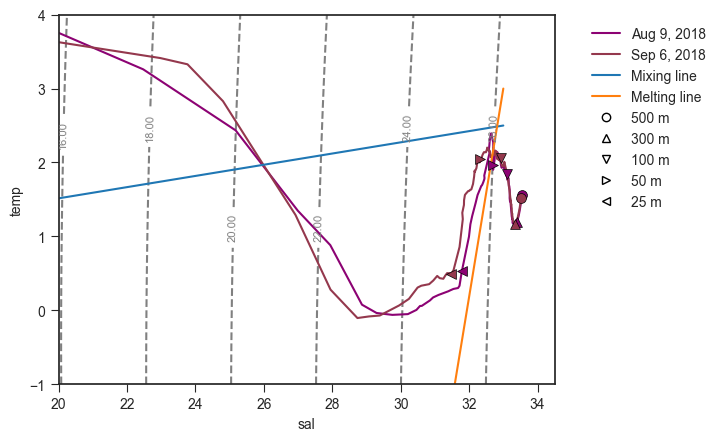

In [205]:
DatesPhases = ['20180809',
 '20180906',
#  '20181031',
#  '20181211',
#  '20190305',
#  '20190410',
#  '20190506'
]
def FormatYYYYMMDD(YYYYMMDD):
    date =  datetime.strptime(str(YYYYMMDD), '%Y%m%d')
    return date.strftime('%b %-d, %Y')

mask =( df_monthly['St.']=="GF10")#& (df_monthly.YYYYMMDD.isin(DatesPhases))



fig, ax = plt.subplots()
for i, date in enumerate(DatesPhases):
    dfPhase = df_monthly[mask][df_monthly.YYYYMMDD == int(date)]
    if date == '20180809':
        dfPhase = dfPhase.iloc[0:-1]
    dfPhase.plot(x='sal', y='temp', ax=ax, label=FormatYYYYMMDD(date), c=colors[i])
    # select pressure 500 and plot with a round, 
    dfPhase[dfPhase['Pressure [dbar]']==500].plot.scatter(x='sal', y='temp', ax=ax,zorder=10, color=colors[i], s=50, edgecolor='black', linewidth=0.5)
    dfPhase[dfPhase['Pressure [dbar]']==300].plot.scatter(x='sal', y='temp', ax=ax,zorder=10, color=colors[i], s=50, edgecolor='black', linewidth=0.5, marker='^')
    dfPhase[dfPhase['Pressure [dbar]']==100].plot.scatter(x='sal', y='temp', ax=ax,zorder=10, color=colors[i], s=50, edgecolor='black', linewidth=0.5, marker='v')
    dfPhase[dfPhase['Pressure [dbar]']==50].plot.scatter(x='sal', y='temp', ax=ax,zorder=10, color=colors[i], s=50, edgecolor='black', linewidth=0.5, marker='>')
    dfPhase[dfPhase['Pressure [dbar]']==25].plot.scatter(x='sal', y='temp', ax=ax,zorder=10, color=colors[i], s=50, edgecolor='black', linewidth=0.5, marker='<')

Smin, Smax = 20,34.5
Tmin, Tmax = -1, 4
TSdiagram(ax, Svals=np.linspace(Smin,Smax,100), Tvals=np.linspace(Tmin,Tmax,100), levels=5)

ax.set_xlim([Smin, Smax])
ax.set_ylim([Tmin, Tmax])


def mixing_line(S, T):
    '''Temperature and Salinity for mass mixing of one water mass with meltwater'''
    Smeltwater =0, 
    Tmeltwater = 0
    return np.linspace(S, Smeltwater, 100), np.linspace(T, Tmeltwater, 100)

S_mix, T_mix = mixing_line(33, 2.5)
ax.plot(S_mix, T_mix, label='Mixing line')
Tmelt, Smelt = np.linspace(-90, 3, 100), np.linspace(0, 33, 100)
ax.plot(Smelt, Tmelt, label='Melting line')


# make a legend entry for a round marker with label  500m 
ax.plot([], [], 'o', color='white', label='500 m', markeredgecolor='black')
ax.plot([], [], '^', color='white', label='300 m', markeredgecolor='black')
ax.plot([], [], 'v', color='white', label='100 m', markeredgecolor='black')
ax.plot([], [], '>', color='white', label='50 m', markeredgecolor='black')
ax.plot([], [], '<', color='white', label='25 m', markeredgecolor='black')

ax.legend(facecolor='white', bbox_to_anchor = (1.05, 1), loc='upper left')

In [303]:
import plotly.graph_objects as go
import numpy as np

# Generate some data for the contour plot
salmin, salmax = 20, 34.5
tempmin, tempmax = -1, 4

def TS_plotly(salmin, salmax, tempmin, tempmax, Nlevels=10):
    x = np.linspace(salmin, salmax, 100)
    y = np.linspace(tempmin, tempmax, 100)
    SA = gsw.SA_from_SP(x,100, -50,64)
    CT = gsw.CT_from_pt(SA, y)
    X, Y = np.meshgrid(SA, CT)
    Z = gsw.density.sigma0(X, Y)

    fig = go.Figure(data =
    go.Contour(
        x=x,
        y=y,
        z=Z,
        contours_coloring='fill',
        colorscale=['rgba(255, 255, 255, 0)', 'rgba(255, 255, 255, 0)'],  # all levels the same color (white) and fully transparent
        hoverinfo='none',
        line=dict(width=1, color='rgba(0, 0, 0, 0.5)'), # contour line color    
        showscale=False, # don't show a color scale for this trace
        contours=dict(
            showlabels = True, 
        ),
    )
)
    
    return fig

fig = TS_plotly(salmin, salmax, tempmin, tempmax)



fig.show()

In [327]:
fpathname = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/project-data-conversion/data/temp/netcdf/single_profiles/CTD_GF19010_2019-02-27_64.22N_-51.68E.nc"
# fpathname = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/project-data-conversion/data/processed/ADCP300.nc"

dataset = xr.open_dataset(fpathname)
dataset = dataset.load()
dataset.close()


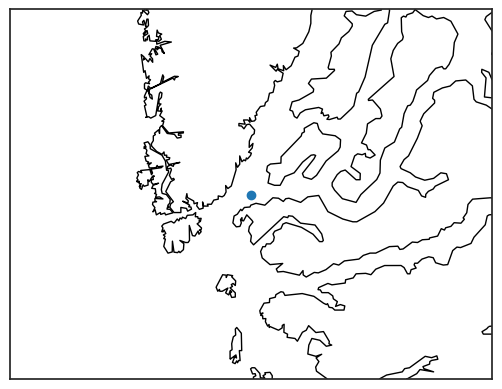

In [340]:
from mpl_toolkits.basemap import Basemap
# immport basemap


# get lon and lat from dataset
def draw_map(dataset):
    lon = dataset.longitude
    lat = dataset.latitude
    fig, ax = plt.subplots()
    m = Basemap(projection='merc', llcrnrlon=lon-1, llcrnrlat=lat-1/3, urcrnrlon=lon+1, urcrnrlat=lat+1/3, resolution='h', ax=ax)
    m.drawcoastlines()
    m.plot(lon, lat, 'o', latlon=True)

draw_map(dataset)
df19010 = dataset.to_dataframe()

In [364]:
import plotly.graph_objects as go

fig = TS_plotly(20, 34.5, -2, 5, Nlevels=20)

AllDatesPhases = ['20180809','20180906','20181031','20181211','20190305','20190410','20190506']
DatesPhases = [
    '20180809',
 '20180906',
 '20181031',
 '20181211',
 '20190305',
 '20190410',
 '20190506'
]

# Define the depths, marker symbols, and colors
depths = [20, 50, 300, 500]
symbols = ['circle', 'square', 'diamond', 'cross']
colors = cmcrameri.cm.hawaii(np.linspace(0, 1, len(AllDatesPhases)))
DateColor = dict(zip(AllDatesPhases, colors))

# Plot the data
for i, date in enumerate(DatesPhases):
    color = 'rgba' + str(tuple(color*255 for color in DateColor[date]))
    dfPhase = df_monthly[mask][df_monthly.YYYYMMDD == int(date)]
    if date == '20180809':
        dfPhase = dfPhase.iloc[0:-1]
    # set markersize
    fig.add_trace(go.Scatter(x=dfPhase['sal'], y=dfPhase['temp'], mode='lines+markers', name=FormatYYYYMMDD(date), customdata=dfPhase['Pressure [dbar]'], hovertemplate='Pressure: %{customdata} dbar', marker_color=color, marker_size=2, line=dict(color=color)))

    # Add markers for specific depths
    for depth, symbol in zip(depths, symbols):
        dfDepth = dfPhase[dfPhase['Pressure [dbar]'] == depth]
        fig.add_trace(go.Scatter(x=dfDepth['sal'], y=dfDepth['temp'], mode='markers', marker_symbol=symbol, name=f'{depth} m', customdata=dfDepth['Pressure [dbar]'], hovertemplate='Pressure: %{customdata} dbar', marker_color=color, marker_size=10, marker_line_width=2))


# fig.add_trace(go.Scatter(x=df19010['Salinity'], y=df19010['Potential temperature'], mode='lines+markers', name='GF19010', marker_color='black', marker_size=3, line=dict(color='black'), customdata=df19010.index, hovertemplate='Pressure: %{customdata} dbar'))

# Add the melting line
Tmelt, Smelt = np.linspace(-90, 3, 100), np.linspace(0, 33, 100)
fig.add_trace(go.Scatter(x=Smelt, y=Tmelt, mode='lines', name='Melting line', line=dict(width=4)))

# Set the plot layout
fig.update_layout(
    xaxis_title='Salinity',
    yaxis_title='Temperature',
    width=900,
    height=600,   
    template = 'plotly_white',
)

# Add empty scatter plots
for i in range(len(depths)):
    fig.add_trace(
        go.Scatter(
            x=[],
            y=[],
            mode='markers',
            name = f'{depths[i]} m',
            marker_symbol=symbols[i],
            marker=dict(size=10, color='rgba(0, 0, 0, 1)')  # invisible markers
        )
    )

# first zoom into 24 to 34.5 salinity and -1 to 4 temperature
fig.update_layout(xaxis_range=[30, 34.01], yaxis_range=[-1, 3.5])
# make at least 5 xtick marks

# export to jpg
fig.write_image(f"{figpath}/TS_diagram_phases.jpg", width=1200, height=900, scale=1)
fig.show()

In [346]:
dataset

<xarray.Dataset>
Dimensions:                (Pressure [dbar]: 382)
Coordinates:
  * Pressure [dbar]        (Pressure [dbar]) float64 1.0 2.0 3.0 ... 381.0 382.0
Data variables:
    Potential temperature  (Pressure [dbar]) float64 0.8903 0.8881 ... 0.9332
    Salinity               (Pressure [dbar]) float64 33.15 33.15 ... 33.49 33.49
    Density                (Pressure [dbar]) float64 1.027e+03 ... 1.029e+03
    Temperature            (Pressure [dbar]) float64 0.8903 0.8882 ... 0.9502
    Conductivity           (Pressure [dbar]) float64 2.837 2.837 ... 2.886 2.886
Attributes: (12/30)
    user_name:              Anneke Vries
    data_type:              CTD
    featureType:            profile
    keywords:               EARTH SCIENCE>OCEANS>OCEAN TEMPERATURE>WATER TEMP...
    Conventions:            ACDD-1.3
    history:                2023-12-06T17:20:41Z converted to netcdf with xar...
    ...                     ...
    geospatial_lon_min:     -51.68195
    geospatial_lon_max:     -51.68195
    source:                 CTD #GF19010
    title:                  CTD profile GF19010 on 2019-02-27, in Nuup Kanger...
    summary:                The file contains potential temperature, practica...
    GCRC_standard_station:  nan

In [239]:
color

array([0.550541, 0.006842, 0.45198 , 1.      ])

In [ ]:
# Define the depths, marker symbols, and colors
depths = [20, 50, 250, 500]
symbols = ['circle', 'square', 'diamond', 'cross']
colors = ['blue', 'green', 'red', 'purple']

# Plot the data
for i, date in enumerate(DatesPhases):
    color = colors[i % len(colors)]  # Cycle through the colors
    dfPhase = df_monthly[mask][df_monthly.YYYYMMDD == int(date)]
    if date == '20180809':
        dfPhase = dfPhase.iloc[0:-1]
    fig.add_trace(go.Scatter(x=dfPhase['sal'], y=dfPhase['temp'], mode='lines+markers', name=FormatYYYYMMDD(date), customdata=dfPhase['Pressure [dbar]'], hovertemplate='Pressure: %{customdata} dbar', marker_color=color))

    # Add markers for specific depths
    for depth, symbol in zip(depths, symbols):
        dfDepth = dfPhase[dfPhase['Pressure [dbar]'] == depth]
        fig.add_trace(go.Scatter(x=dfDepth['sal'], y=dfDepth['temp'], mode='markers', marker_symbol=symbol, name=f'{depth} m', customdata=dfDepth['Pressure [dbar]'], hovertemplate='Pressure: %{customdata} dbar', marker_color=color))

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_12201/1260791866.py:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_12201/1260791866.py:100: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



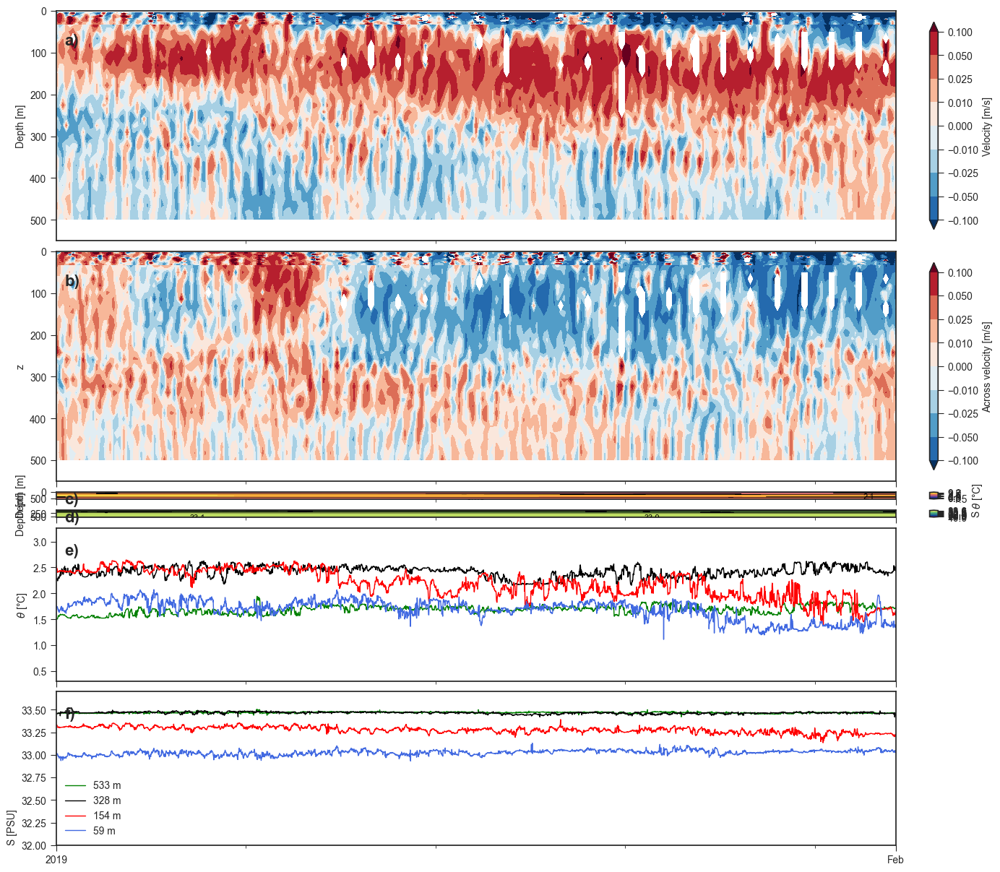

In [ ]:
# stylesheet to seaborn-ticks
plt.style.use('seaborn-ticks')

cax_bounds = [1.04, 0.05, 0.01, 0.9]  # x, y, width, height

levels = [-100, -50, -25, -10,0, 10, 25, 50, 100]
levels = np.array(levels)/1000.
cmap = 'RdBu_r'
zlim = [500, 0]

fig, ax = plt.subplots(figsize=(15, 15), nrows=6, ncols=1, sharey=False, sharex=True,  gridspec_kw={'height_ratios': [3,3,0.1,0.1,2,2]})

ax_across = ax[1]
#surfer 
ax_surfer = [2,3]

# mooring
axT = ax[4]
axS = ax[5]

resampling_time = '3H'

cvelo = (ds_velo_300/1000).resample(time=resampling_time).mean().Along_res.plot.contourf(y='z', ax=ax[0], cmap=cmap, levels=levels,  add_colorbar=False,extend='both')
(ds_velo_75/1000).resample(time=resampling_time).mean().Along_res.plot.contourf(y='z', ax=ax[0], cmap=cmap, levels=levels, extend='both', add_colorbar=False)
cax = ax[0].inset_axes(cax_bounds)
fig.colorbar(cvelo, orientation='vertical', label= 'Velocity [m/s]',  ax=ax[i], cax=cax)
ax[0].scatter(x=pd.to_datetime('2018-06-01'), y=34.5, edgecolor='white', marker=">", color='black')


cvelo = (ds_velo_300/1000).resample(time=resampling_time).mean().Across_res.plot.contourf(y='z', ax=ax_across, cmap=cmap, levels=levels,  add_colorbar=False,extend='both')
(ds_velo_75/1000).resample(time=resampling_time).mean().Across_res.plot.contourf(y='z', ax=ax_across, cmap=cmap, levels=levels, extend='both', add_colorbar=False)
cax = ax_across.inset_axes(cax_bounds)
fig.colorbar(cvelo, orientation='vertical', label= 'Across velocity [m/s]',  ax=ax_across, cax=cax)


for i in range(1): 
    ax[i].set_ylabel('Depth [m]')
plt.gca().invert_yaxis()
plt.ylim(zlim)
# ax[0].set_title('Along fjord')
# ax[1].set_title('Across fjord')


# remove all ticks and labels from top plot
ax[0].tick_params(labelbottom=False, bottom=False, top=False, labeltop=False)
ax[0].set_xlabel('')
# remove hspace
plt.subplots_adjust(hspace=0.15)
# for axpatch in ax: axpatch.add_patch(get_background_patch(axpatch))


#==================================================================================================
# Surfer plot Temperature and salinity
#==================================================================================================
variable = 'Potential temperature [°C]'
for variable, i in zip(['Potential temperature [°C]', 'Salinity [PSU]'], ax_surfer):
    levels_f, cmap, var, levels_l, norm, short_label= set_cbar(variable)
    df_ctd_moor = pd.concat([
        df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
        df_moor_daily.set_index(['Pressure [dbar]', 'date'])[var]])
    df_ctd_moor = df_ctd_moor.reset_index().dropna()
    df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)

    xi = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 1)
    yi = np.arange(df_ctd_moor['Pressure [dbar]'].min(), df_ctd_moor['Pressure [dbar]'].max()+1, 1)

    # convert xi to datetime
    xi_date = decimal_day_to_datetime(xi)
    # Filter out NaN values from var column
    valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
    points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices])
    values = df_ctd_moor[var].to_numpy()[valid_indices]
    # Perform interpolation using 'linear' method
    zi = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')

    # Plot the results
    contourf = ax[i].contourf(xi_date, yi, zi, levels=levels_f, norm=norm, cmap=cmap, extend='both')
    if var == 'temp':
        levels_l = [1.2, 2.1, 3.0]
    elif var == 'sal':
        levels_l = np.arange(32.8, 33.6, 0.1)
    contourl = ax[i].contour(xi_date, yi, zi, colors= 'k', levels=levels_l, linewidths= 0.5)
    ax[i].scatter(np.repeat(pd.to_datetime('2018-06-01'),5), mean_pres, marker='>', color='black', clip_on=True, s=20, edgecolor='white')
    ax[i].scatter(df_monthly.date.unique(), 3*np.ones(len(df_monthly.date.unique())), marker='v', color='black', clip_on=True, s=20, edgecolor='white')
    ax[i].set_xlim([datetime(2018, 5,29), datetime(2019, 6, 5)])
    cax = ax[i].inset_axes(cax_bounds)
    fig.colorbar(contourf, orientation='vertical', label=short_label, ticks=levels_f[::2], ax=ax[i], cax=cax)
    



    format_surfer(short_label, levels_f, fig, ax[i], contourf, contourl)
    ax[i].set_ylabel('Depth [m]')

for i in range(3): ax[i].set_ylim([550, 0])


# #====== Mooring lines

plt.style.use("seaborn-ticks")
linewidth = 1

# axS2 = ax[5]

mean_5_depth = df_mooring[df_mooring.depth==5]["depSM"].mean()*-1
depths= [  5,  60, 150, 330, 540]
colors = ['cyan','royalblue',  'red','black', 'green']
cdepth = dict(zip(depths, colors))

# df_mooring[df_mooring.depth==5].plot.line(x="date", y="temp", ax=axT, linewidth=linewidth, label=f"{mean_5_depth:.0f} m", color=cdepth[5], legend=False)
# df_mooring[df_mooring.depth==5].plot.line(x="date", y="sal", ax=axS2, linewidth=linewidth, label=f"{mean_5_depth:.0f} m", legend=False, color=cdepth[5])
for d in df_mooring["depth"].sort_values(ascending=False).unique()[:-1]:
    df_depth = df_mooring[df_mooring["depth"]==d]
    mean_real_depth = df_depth["depSM"].mean()*-1
    # df_depth.plot.line(x="date", y="temp", ax=axT, label=f"{mean_real_depth:.0f} m", linewidth=linewidth, color=cdepth[d], legend=False)
    axT.plot(df_depth.date, df_depth.temp, linewidth=linewidth, label=f"{mean_real_depth:.0f} m", color=cdepth[d])

for d in df_mooring["depth"].sort_values(ascending=False).unique()[:-1]:
    df_depth = df_mooring[df_mooring["depth"]==d]
    mean_real_depth = df_depth["depSM"].mean()*-1
    axS.plot(df_depth.date, df_depth.sal, linewidth=linewidth, label=f"{mean_real_depth:.0f} m", color=cdepth[d])
    
# df_mooring[df_mooring.depth==5][:1].plot.line(x="date", y="sal", ax=axS, linewidth=linewidth, label="", legend=True, color="white")

axS.set_ylabel("S [PSU]", loc='bottom')
axT.set_ylabel(r"$\theta$ (°C)", )

axS.set_ylim(32, 33.7)
xlims = [pd.to_datetime('2019-01-01'), pd.to_datetime('2019-02-01')]
for i in range(len(ax)):
    ax[i].set_xlim(xlims)


axS.legend()#loc='lower left', bbox_to_anchor=(1.01, 0), fontsize=10)

plt.subplots_adjust(hspace=0.08)
# # add a), b), c) etc. to subplots
for i, label in enumerate(('a)', 'b)', 'c)', 'd)', 'e)', 'f)')):
    ax[i].text(0.01, 0.9, label, transform=ax[i].transAxes, fontsize=16, fontweight='bold', va='top')
plt.gca().xaxis.set_minor_locator(mdates.WeekdayLocator())
axS.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
axS.xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
if xlims[1] - xlims[0] < pd.to_timedelta('30 days'):
    axS.xaxis.set_minor_locator(mdates.DayLocator(interval=1))
axS.set_xlabel('')


fig.savefig(f"{figpath}/Surfer plot/All_in_one_v_every_{resampling_time}.png", dpi=300, bbox_inches='tight')

## only mooring

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_54342/690869414.py:4: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



NameError: name 'df_mooring' is not defined

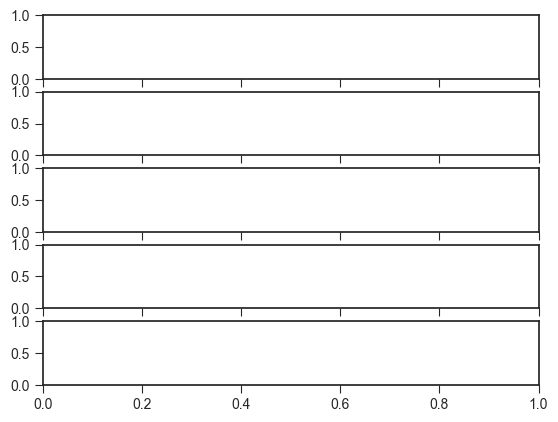

In [ ]:

# #====== Mooring lines
fig, (axT, axS, axRHO, axTIDE, axALONG) = plt.subplots(5,1,  sharex=True,)# figsize=(15,14),

plt.style.use("seaborn-ticks")
linewidth = 0.5


mean_5_depth = df_mooring[df_mooring.depth==5]["depSM"].mean()*-1
depths= [  5,  60, 150, 330, 540]
colors = ['cyan','royalblue',  'red','black', 'green']
cdepth = dict(zip(depths, colors))
rolling_mean_interval = 50 # hours

print("Time between two measurements:", df_mooring.date[1]-df_mooring.date[0])


# for d in df_mooring["depth"].sort_values(ascending=True).unique():
for d in [330]:
    if d == 5: continue
    df_depth = df_mooring[df_mooring["depth"]==d]
    mean_real_depth = df_depth["depSM"].mean()*-1

    axS.plot(df_depth.date, df_depth.sal, linewidth=linewidth,  color=cdepth[d], alpha=0.2, zorder=1)
    axT.plot(df_depth.date, df_depth.temp, linewidth=linewidth,  color=cdepth[d], alpha=0.2, zorder=1)
    axRHO.plot(df_depth.date, df_depth.dens-  df_depth.dens.mean(), linewidth=linewidth,  color=cdepth[d], alpha=0.2, zorder=1)

    df_depth_rolling_mean = df_depth.rolling(6*rolling_mean_interval, center=True).mean()
    df_depth_rolling_mean["date"] = df_depth.date
    axS.plot(df_depth_rolling_mean.date, df_depth_rolling_mean.sal, linewidth=linewidth*3, label=f"{mean_real_depth:.0f} m", color=cdepth[d], zorder=2)
    axT.plot(df_depth_rolling_mean.date, df_depth_rolling_mean.temp, linewidth=linewidth*3, label=f"{mean_real_depth:.0f} m", color=cdepth[d], zorder=2)
    axRHO.plot(df_depth_rolling_mean.date, df_depth_rolling_mean.dens-  (df_depth.dens.mean()), linewidth=linewidth*3, label=f"+{(df_depth.dens.mean()):.1f}"+r" kg m$^{-3}$", color=cdepth[d], zorder=2)
    # axRHO.plot(df_depth_rolling_mean.date, df_depth_rolling_mean.dens, linewidth=linewidth*3,  color=cdepth[d], zorder=2)

(ds_velo_75/1000).Tidal_along.sel( z=300, method='nearest').plot(ax= axTIDE,color='grey', alpha=1)

axS.set_ylabel("S")
axT.set_ylabel(r"$\theta$ (°C)", )
# axS.set_ylim(32, 33.7)
axRHO.set_ylabel(r"$\Delta \rho$ [kg m$^{-3}$]", )
for ax in [axT, axS]:
    ax.set_xlim(pd.to_datetime('2018-09-30'), pd.to_datetime('2018-12-05'))


plt.subplots_adjust(hspace=0.08)
# # add a), b), c) etc. to subplots
axT.text(0.01, 0.1, "a)", transform=axT.transAxes, fontsize=16, fontweight='bold', va='bottom')
axS.text(0.01, 0.1, "b)", transform=axS.transAxes, fontsize=16, fontweight='bold', va='bottom')
axRHO.text(0.01, 0.1, "c)", transform=axRHO.transAxes, fontsize=16, fontweight='bold', va='bottom')
axS.legend(loc='lower right')#bbox_to_anchor=(1.01, 0), fontsize=10)
axRHO.legend(loc='lower right')

# plt.gca().xaxis.set_minor_locator(mdates.WeekdayLocator())
axS.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
axS.xaxis.set_minor_locator(mdates.DayLocator(interval=1))
# format every month
axALONG.xaxis.set_major_formatter(mdates.DateFormatter('%b'))
axS.set_xlabel('')
axTIDE.set_title('')
axALONG.set_title('')
(ds_velo_75/1000).Along_res.sel( z=300, method='nearest').plot(ax= axALONG,color='black', alpha=0.2,linewidth=linewidth)
(ds_velo_75/1000).Along_res.sel( z=300, method='nearest').rolling(time=12, center=True, min_periods=6).mean().plot(ax= axALONG,color='black', alpha=1, linewidth=linewidth*3)

axALONG.set_ylim(-0.12, 0.12)

# fig.savefig(f"{figpath}/Only_mooring_tides_{d}.png", dpi=600, bbox_inches='tight')

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_91452/3549515742.py:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-ticks')
/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_91452/3549515742.py:88: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn-ticks")


Text(0.5, 0, '')

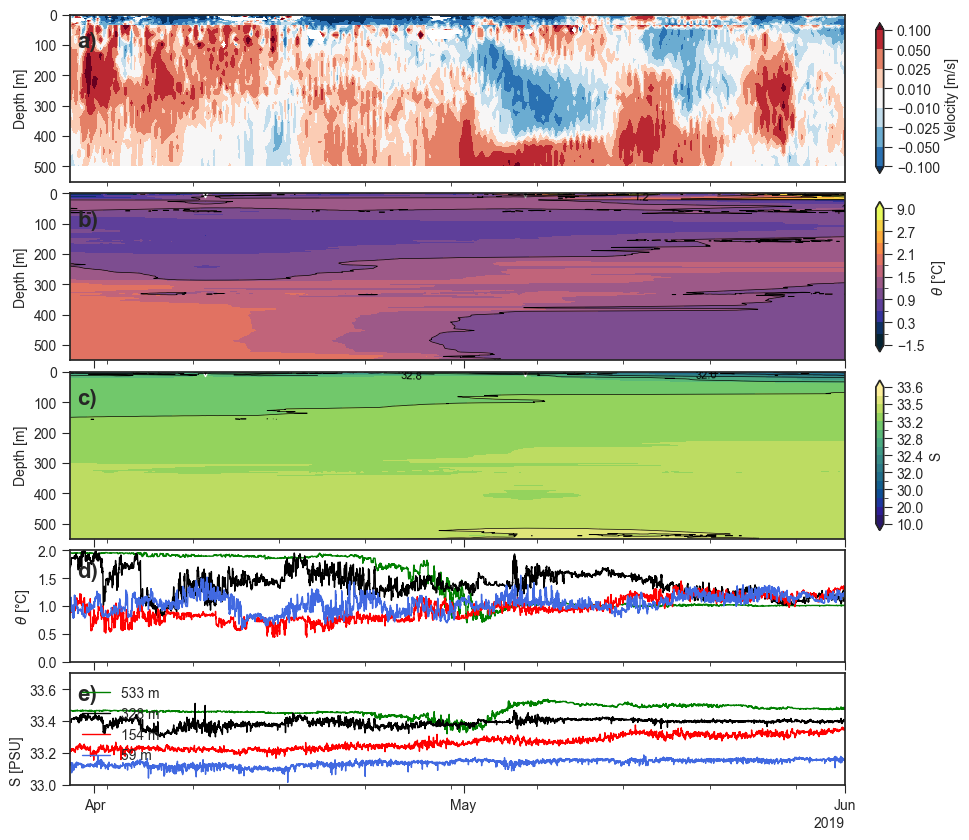

In [ ]:
# All panels but zoom
# 6 hourly mean 

ax# stylesheet to seaborn-ticks
plt.style.use('seaborn-ticks')

cax_bounds = [1.04, 0.05, 0.01, 0.9]  # x, y, width, height

levels = [-100, -50, -25, -10, 10, 25, 50, 100]
levels = np.array(levels)/1000.
cmap = 'RdBu_r'
zlim = [500, 0]

fig, ax = plt.subplots(figsize=(10, 10), nrows=5, ncols=1, sharey=False, sharex=True,  gridspec_kw={'height_ratios': [3,3,3, 2,2]})
# for i in range(len(ax)):
#     ax[i].set_aspect(1/6)
# if min(zlim) <60:
cvelo = (ds_velo_300/1000).resample(time='6H').mean().Along_res.plot.contourf(y='z', ax=ax[0], cmap=cmap, levels=levels,  add_colorbar=False,extend='both')
(ds_velo_75/1000).resample(time='6H').mean().Along_res.plot.contourf(y='z', ax=ax[0], cmap=cmap, levels=levels, extend='both', add_colorbar=False)
cax = ax[0].inset_axes(cax_bounds)
fig.colorbar(cvelo, orientation='vertical', label= 'Velocity [m/s]',  ax=ax[i], cax=cax)
# make a triangle
ax[0].scatter(x=pd.to_datetime('2018-06-01'), y=34.5, edgecolor='white', marker=">", color='black')

for i in range(1): 
    ax[i].set_ylabel('Depth [m]')
plt.gca().invert_yaxis()
plt.ylim(zlim)
# ax[0].set_title('Along fjord')
# ax[1].set_title('Across fjord')


# remove all ticks and labels from top plot
ax[0].tick_params(labelbottom=False, bottom=False, top=False, labeltop=False)
ax[0].set_xlabel('')
# remove hspace
plt.subplots_adjust(hspace=0.15)
# for axpatch in ax: axpatch.add_patch(get_background_patch(axpatch))


#==================================================================================================
# Surfer plot Temperature and salinity
#==================================================================================================
variable = 'Potential temperature [°C]'
for variable, i in zip(['Potential temperature [°C]', 'Salinity [PSU]'], [1,2]):
    levels_f, cmap, var, levels_l, norm, short_label= set_cbar(variable)
    df_ctd_moor = pd.concat([
        df_monthly.set_index(['Pressure [dbar]', 'date'])[var], 
        df_mooring.set_index(['Pressure [dbar]', 'date'])[var]])
    df_ctd_moor = df_ctd_moor.reset_index().dropna()
    df_ctd_moor['days_decimal'] = datetime_to_decimal_days(df_ctd_moor.date)

    xi = np.arange(df_ctd_moor['days_decimal'].min(), df_ctd_moor['days_decimal'].max(), 1/4)   # choose interval on which to project grid
    yi = np.arange(df_ctd_moor['Pressure [dbar]'].min(), df_ctd_moor['Pressure [dbar]'].max()+1, 1)

    # convert xi to datetime
    xi_date = decimal_day_to_datetime(xi)
    # Filter out NaN values from var column
    valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
    points = (df_ctd_moor['days_decimal'].to_numpy()[valid_indices], df_ctd_moor['Pressure [dbar]'].to_numpy()[valid_indices])
    values = df_ctd_moor[var].to_numpy()[valid_indices]
    # Perform interpolation using 'linear' method
    zi = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')

    # Plot the results
    contourf = ax[i].contourf(xi_date, yi, zi, levels=levels_f, norm=norm, cmap=cmap, extend='both')
    # if var == 'temp':
    #     contourl = False
    # else:
    contourl = ax[i].contour(xi_date, yi, zi, colors= 'k', levels=levels_l, linewidths= 0.5)
    ax[i].scatter(np.repeat(pd.to_datetime('2018-06-01'),5), mean_pres, marker='>', color='black', clip_on=True, s=20, edgecolor='white')
    ax[i].scatter(df_monthly.date.unique(), 3*np.ones(len(df_monthly.date.unique())), marker='v', color='black', clip_on=True, s=20, edgecolor='white')
    ax[i].set_xlim([datetime(2018, 5,29), datetime(2019, 6, 5)])
    cax = ax[i].inset_axes(cax_bounds)
    fig.colorbar(contourf, orientation='vertical', label=short_label, ticks=levels_f[::2], ax=ax[i], cax=cax)
    



    format_surfer(short_label, levels_f, fig, ax[i], contourf, contourl)
    ax[i].set_ylabel('Depth [m]')

for i in range(3): ax[i].set_ylim([550, 0])


# #====== Mooring lines

plt.style.use("seaborn-ticks")
linewidth = 1
axT = ax[3]
axS = ax[4]
# axS2 = ax[5]

mean_5_depth = df_mooring[df_mooring.depth==5]["depSM"].mean()*-1
depths= [  5,  60, 150, 330, 540]
colors = ['cyan','royalblue',  'red','black', 'green']
cdepth = dict(zip(depths, colors))

# df_mooring[df_mooring.depth==5].plot.line(x="date", y="temp", ax=axT, linewidth=linewidth, label=f"{mean_5_depth:.0f} m", color=cdepth[5], legend=False)
# df_mooring[df_mooring.depth==5].plot.line(x="date", y="sal", ax=axS2, linewidth=linewidth, label=f"{mean_5_depth:.0f} m", legend=False, color=cdepth[5])
for d in df_mooring["depth"].sort_values(ascending=False).unique()[:-1]:
    df_depth = df_mooring[df_mooring["depth"]==d]
    mean_real_depth = df_depth["depSM"].mean()*-1
    # df_depth.plot.line(x="date", y="temp", ax=axT, label=f"{mean_real_depth:.0f} m", linewidth=linewidth, color=cdepth[d], legend=False)
    axT.plot(df_depth.date, df_depth.temp, linewidth=linewidth, label=f"{mean_real_depth:.0f} m", color=cdepth[d])

for d in df_mooring["depth"].sort_values(ascending=False).unique()[:-1]:
    df_depth = df_mooring[df_mooring["depth"]==d]
    mean_real_depth = df_depth["depSM"].mean()*-1
    axS.plot(df_depth.date, df_depth.sal, linewidth=linewidth, label=f"{mean_real_depth:.0f} m", color=cdepth[d])
    
# df_mooring[df_mooring.depth==5][:1].plot.line(x="date", y="sal", ax=axS, linewidth=linewidth, label="", legend=True, color="white")

axS.set_ylabel("S [PSU]", loc='bottom')
axT.set_ylabel(r"$\theta$ (°C)", )
# axS.set_xlim(pd.to_datetime('2018-05-25'), pd.to_datetime('2019-06-05'))
axT.set_ylim(0, 2)
axS.set_ylim(33, 33.7)
# axS2.set_ylim(0,35)
for i in range(len(ax)):
    ax[i].set_xlim(pd.to_datetime('2019-03-30'), pd.to_datetime('2019-06-01'))

# axS2.spines['top'].set_visible(False)
# axS.spines['bottom'].set_visible(False)
# axS.tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# # set legend location 
axS.legend()#loc='lower left', bbox_to_anchor=(1.01, 0), fontsize=10)

plt.subplots_adjust(hspace=0.08)
# # add a), b), c) etc. to subplots
for i, label in enumerate(('a)', 'b)', 'c)', 'd)', 'e)')):
    ax[i].text(0.01, 0.9, label, transform=ax[i].transAxes, fontsize=16, fontweight='bold', va='top')
plt.gca().xaxis.set_minor_locator(mdates.WeekdayLocator())
axS.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
axS.xaxis.set_minor_locator(mdates.WeekdayLocator(interval=1))
axS.set_xlabel('')

# fig.savefig(f"{figpath}/Surfer plot/All_timeseries_with_mooring_ts_zoom.png", dpi=600, bbox_inches='tight')

# Direction and velocity vectors

In [ ]:
df_velo_both

<xarray.Dataset>
Dimensions:         (time: 27281, z: 54)
Coordinates:
  * time            (time) datetime64[ns] 2018-05-29T14:26:00 ... 2019-06-12T...
  * z               (z) float64 3.79 5.79 7.79 9.79 ... 450.3 466.3 482.3 498.3
Data variables:
    SerEmmpersec    (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerNmmpersec    (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerVmmpersec    (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerErmmpersec   (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerMagmmpersec  (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerDir10thDeg   (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    SerPG4          (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    Alongmmpersec   (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    Acrossmmpersec  (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    Along_res       (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    Across_res      (time, z) float64 nan nan nan nan nan ... nan nan nan nan
    Tidal_along     (time, z) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    units:    mm/s

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/3256976239.py:15: DeprecationWarning:

self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/3256976239.py:21: DeprecationWarning:

self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/3256976239.py:23: DeprecationWarning:

self.axes is deprecated since 2022.11 in order to align with matplotlibs plt.subplots, use self.axs instead.



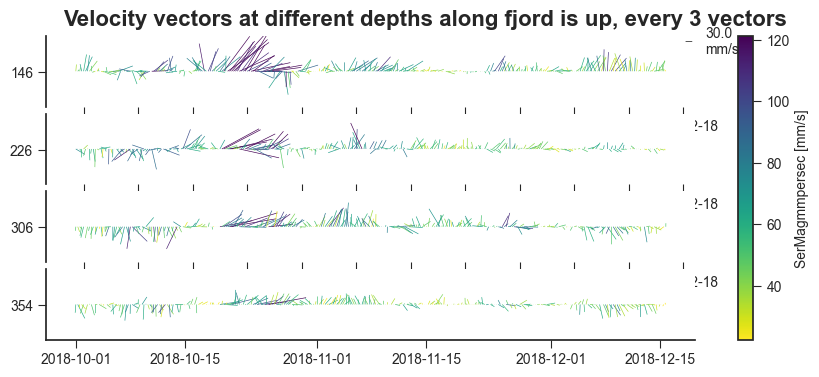

In [ ]:
depths = [350, 300, 225,  150,]
depths = np.sort(depths)
time_interval = 3  #nr vector * time between resampling

ds_select = df_velo_both.resample(time='6H').mean().sel(time=slice('2018-10-01','2018-12-15')).sel(z=depths, method= 'nearest')
q = ds_select.plot.quiver(x='time', y='z', v='Along_res', u='Across_res',  hue ='SerMagmmpersec',
                        #   hue ="Acrossmmpersec",  
                          cmap="viridis_r", 
                            headwidth=0, pivot='tail', row='z', scale=2000, 
                            sharey=False, sharex=False, robust=True, size=1, aspect=8 , width=1e-3,)
q.set_xlabels('')
q.set_ylabels('')
q.set_titles('')

for ax, ytick in zip(q.axes.flat,ds_select.z.values):
    ax.set_yticks([round(ytick,0)])
    ax.set_xticks([])
    for side in ['bottom', 'top', 'right']:
        ax.spines[side].set_visible(False)
    ax.xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
q.axes.flat[-1].spines['bottom'].set_visible(True)
# auto date formatter
q.axes.flat[-1].xaxis.set_major_locator(mdates.AutoDateLocator())

q.fig.subplots_adjust(hspace=0.1, right=0.8)
# suptitle 
q.fig.suptitle(f'Velocity vectors at different depths along fjord is up, every {time_interval} vectors', fontsize=16, fontweight='bold')
# transparent background
# minor ticks

q.fig.patch.set_alpha(0)

# q.fig.savefig(f"{figpath}/velocity_surfer/velocity_vectors.png", dpi=300, bbox_inches='tight')


## Progressive velocity sum

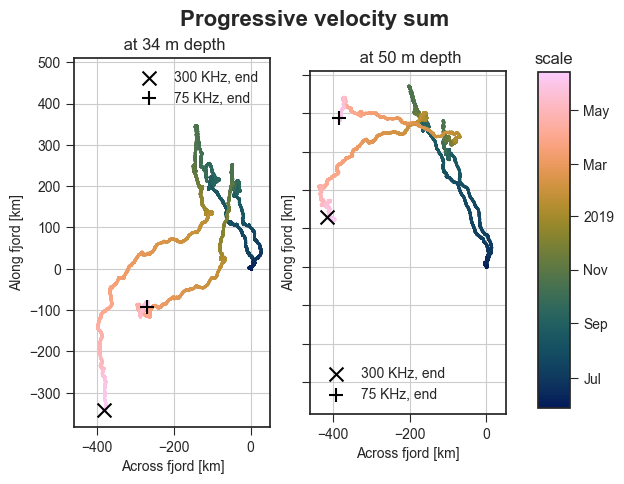

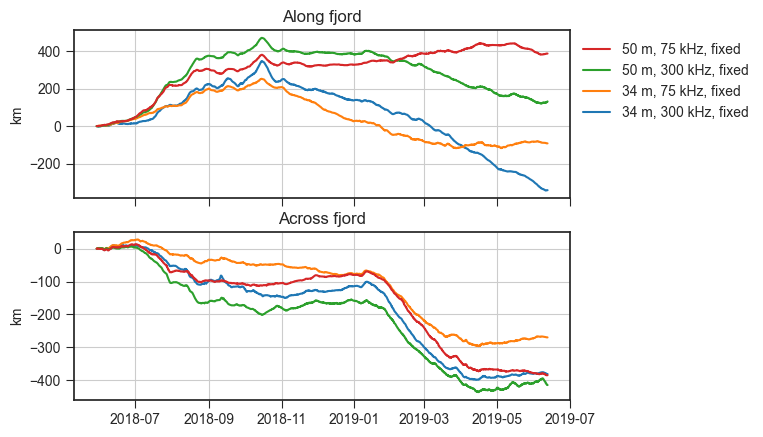

In [ ]:
figpathjohn = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Figures/for john june 13"

nseconds300 = (ds_velo_300.time[1]-ds_velo_300.time[0]).values/np.timedelta64(1, 's') # number of seconds between each measurement
nseconds75 = (ds_velo_75.time[1]-ds_velo_75.time[0]).values/np.timedelta64(1, 's')

fig, axes_dir = plt.subplots(1,2, sharey=True, sharex=True)
figtime, axes = plt.subplots(2,1, sharex=True) 
norm = mpl.colors.Normalize(vmin=mdates.date2num(["2018-05-28"]), vmax=mdates.date2num(["2019-06-13"]))

for depths in [34, 50]:
    x300ave = (ds_velo_300.sel(z=slice(depths+8, depths-8))*nseconds300).mean(dim="z").cumsum(dim='time') /1e6
    x300fix =(ds_velo_300.sel(z=depths, method='nearest')*nseconds300).cumsum(dim='time')/1e6
    x75fix = (ds_velo_75.sel(z=depths, method='nearest')*nseconds75).cumsum(dim='time')/1e6

    x75fix["date"] = ds_velo_75.time
    x300fix["date"] = ds_velo_300.time
    

    if depths == 34:
        ax = axes_dir[0]
    else:
        ax = axes_dir[1]

    # ax.plot(x300ave.Acrossmmpersec, x300ave.Alongmmpersec, label=f"300 kHz, averaged, between {depths-8} and {depths+8} m ")
    # ax.plot(x300fix.Acrossmmpersec, x300fix.Alongmmpersec, label=f"300 kHz, {depths} m bin", linewidth=0.5)
    # ax.plot(x75fix.Acrossmmpersec, x75fix.Alongmmpersec, label=f"75 kHz, {depths} m bin", linewidth=0.5, linestyle='--', color='k')
    ax.scatter(x300fix.Acrossmmpersec, x300fix.Alongmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=ccm.cm.batlow, norm=norm, s=1)
    sc = ax.scatter(x75fix.Acrossmmpersec, x75fix.Alongmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=ccm.cm.batlow, norm=norm, s=1)
    ax.scatter(x300fix.Acrossmmpersec[-1], x300fix.Alongmmpersec[-1], marker='x', c='k', s=100, label="300 KHz, end")
    ax.scatter(x75fix.Acrossmmpersec[-1], x75fix.Alongmmpersec[-1], marker='+', c='k', s=100, label="75 KHz, end")

    fig.gca().set_aspect('equal', adjustable='box')
    ax.set_xlabel("Across fjord [km]")
    ax.set_ylabel("Along fjord [km]")
    ax.set_title(f" at {depths} m depth")
    ax.legend()
    ax.grid(True)
    fig.suptitle("Progressive velocity sum", fontsize=16, fontweight='bold')


    # plt.show()
    # fig.savefig(f"{figpathjohn}/progressive_velocity_sum_{depths}m.png", dpi=300, bbox_inches='tight')
    



    # axes[0].plot(ds_velo_300.time, x300ave.Alongmmpersec, label="300 kHz, averaged")
    axes[0].plot(ds_velo_300.time, x300fix.Alongmmpersec, label=f"{depths} m, 300 kHz, fixed")
    axes[0].plot(ds_velo_75.time, x75fix.Alongmmpersec, label=f"{depths} m, 75 kHz, fixed")
    axes[0].set_title("Along fjord")

    axes[1].plot(ds_velo_300.time, x300fix.Acrossmmpersec, label=f"{depths}, 300 kHz, fixed")
    axes[1].plot(ds_velo_75.time, x75fix.Acrossmmpersec, label=f"{depths}, 75 kHz, fixed")
    axes[1].set_title("Across fjord")

#colorbar for prog velocity sum
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
cbar = fig.colorbar(sc,cax=cbar_ax)
cbar.ax.set_title("scale")
loc = mdates.AutoDateLocator()
cbar.ax.yaxis.set_major_locator(loc)
cbar.ax.yaxis.set_major_formatter(mdates.ConciseDateFormatter(loc))


for ax in axes: 
    ax.grid(True)
    ax.set_ylabel("km")
# set legend for axes and reverse order of legend entries

handles, labels = axes[0].get_legend_handles_labels()
axes[0].legend(handles[::-1], labels[::-1], ncol=1, bbox_to_anchor=(1.0, 1), loc='upper left')
fig.savefig(f"{figpathjohn}/PVD_34_50.png", dpi=300, bbox_inches='tight')
figtime.savefig(f"{figpathjohn}/direction_34_50_time.png", dpi=300, bbox_inches='tight')
# plt.show()


0 5
1 10
2 20
3 34
4 50
5 100
6 200
7 300
8 400


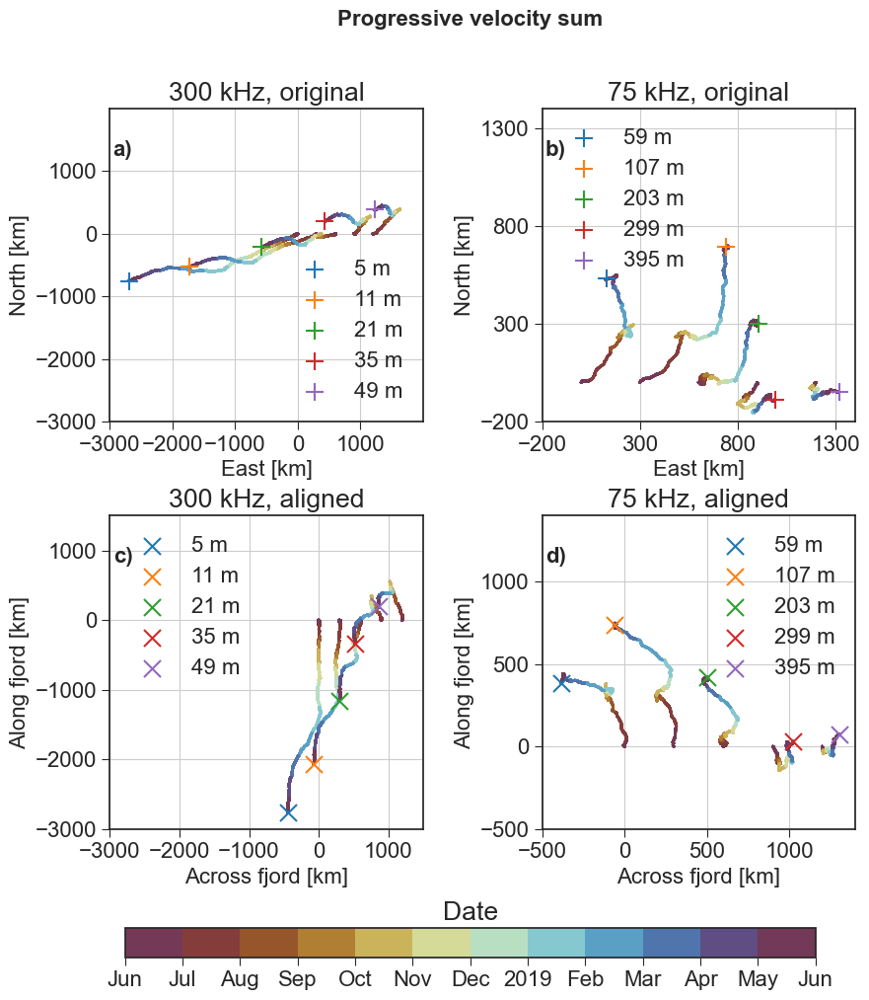

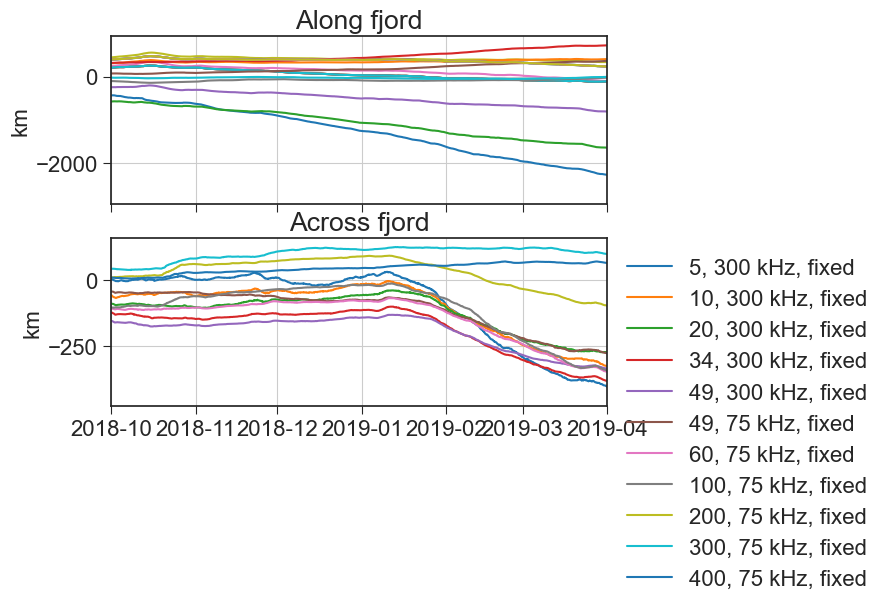

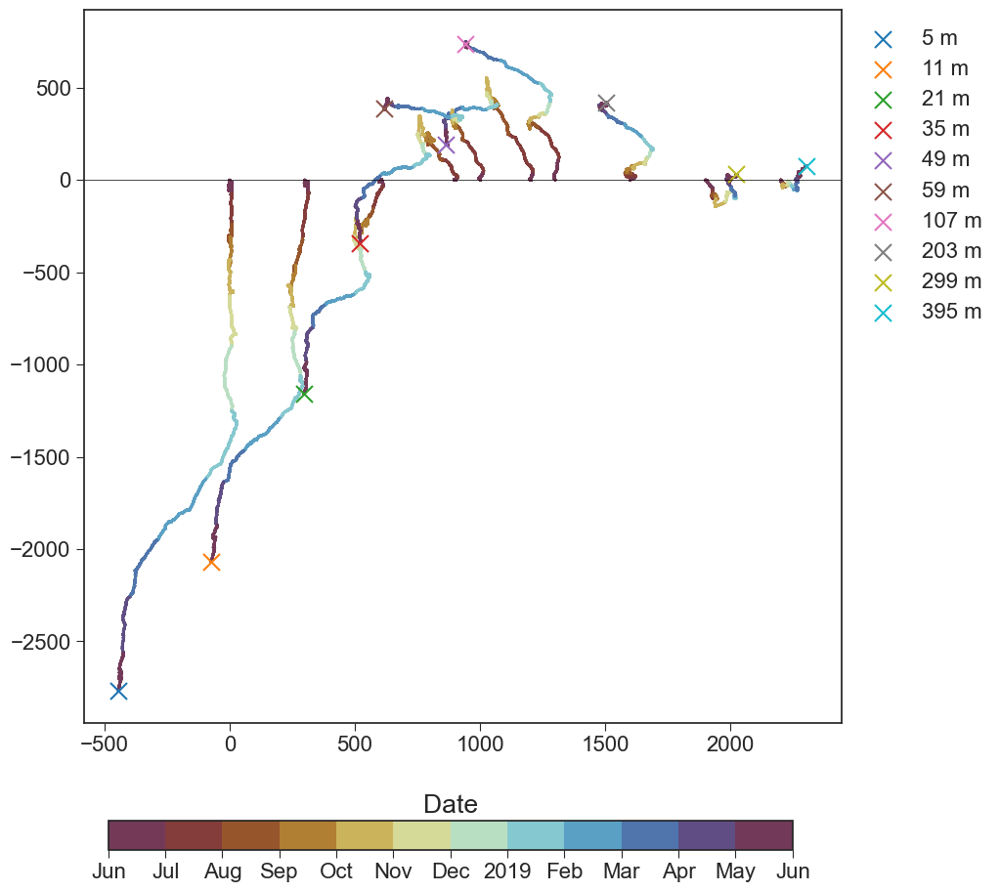

In [ ]:
figpathjohn = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Figures/for john june 13"

nseconds300 = (ds_velo_300.time[1]-ds_velo_300.time[0]).values/np.timedelta64(1, 's') # number of seconds between each measurement
nseconds75 = (ds_velo_75.time[1]-ds_velo_75.time[0]).values/np.timedelta64(1, 's')

# make all text fonts larger
plt.rcParams.update({'font.size': 16})



# make an array of every month in the dataset, one month in between
boundsdatetime = pd.date_range('2018-05-28','2019-06-13', freq='MS').strftime("%Y-%m-%d").tolist()
boundsdatenum = mdates.date2num(boundsdatetime)
for n,depths in enumerate([5, 10, 20, 34, 50,100, 200, 300, 400]):
    print(n, depths)

fig, ax = plt.subplots(2,2,  figsize=(10,10))
figtime, axes = plt.subplots(2,1, sharex=True) 
fig_together, ax_together = plt.subplots(1,1,  figsize=(10,10))
norm = mpl.colors.Normalize(vmin=mdates.date2num(["2018-05-28"]), vmax=mdates.date2num(["2019-06-13"]))
cmap = ccm.cm.romaO
norm = mpl.colors.BoundaryNorm(boundsdatenum, cmap.N)
minz_75 = np.round(float(ds_velo_75.z.min()),1)
maxz_300 = np.round(float(ds_velo_300.z.max()),1)

for i,depths in enumerate([5, 10, 20, 34, 49, 60, 100, 200, 300, 400]):
    x300ave = (ds_velo_300.sel(z=slice(depths+8, depths-8))*nseconds300).mean(dim="z").cumsum(dim='time') /1e6
    x300fix =(ds_velo_300.sel(z=depths, method='nearest')*nseconds300).cumsum(dim='time')/1e6
    x75fix = (ds_velo_75.sel(z=depths, method='nearest')*nseconds75).cumsum(dim='time')/1e6
    actual_depth_300 =  np.round(float(x300fix.z),1)
    actual_depth_75 =  np.round(float(x75fix.z),1)
    x75fix["date"] = ds_velo_75.time
    x300fix["date"] = ds_velo_300.time

    shift_fact = 300   
    if depths <50:
        sc = ax[1,0].scatter(x300fix.Acrossmmpersec+i*shift_fact, x300fix.Alongmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=cmap, norm=norm, s=1)
        ax[1,0].scatter(x300fix.Acrossmmpersec[-1]+i*shift_fact, x300fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_300:.0f} m")
        #east-north
        ax[0,0].scatter(x300fix.SerEmmpersec+i*shift_fact, x300fix.SerNmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=cmap, norm=norm, s=1)
        ax[0,0].scatter(x300fix.SerEmmpersec[-1]+i*shift_fact, x300fix.SerNmmpersec[-1], marker='+', s=150, label=f"{actual_depth_300:.0f} m")

        sc_tog = ax_together.scatter(x300fix.Acrossmmpersec+i*shift_fact, x300fix.Alongmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=cmap, norm=norm, s=1)
        ax_together.scatter(x300fix.Acrossmmpersec[-1]+i*shift_fact, x300fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_300:.0f} m")


    else:
        i-=5
        sc = ax[1,1].scatter(x75fix.Acrossmmpersec+i*shift_fact, x75fix.Alongmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=cmap, norm=norm, s=1)
        ax[1,1].scatter(x75fix.Acrossmmpersec[-1]+i*shift_fact, x75fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_75:.0f} m")
        #east-north
        ax[0,1].scatter(x75fix.SerEmmpersec+i*shift_fact, x75fix.SerNmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=cmap, norm=norm, s=1)
        ax[0,1].scatter(x75fix.SerEmmpersec[-1]+i*shift_fact, x75fix.SerNmmpersec[-1], marker='+', s=150, label=f"{actual_depth_75:.0f} m")

        ax_together.scatter(x75fix.Acrossmmpersec+i*shift_fact+1000, x75fix.Alongmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=cmap, norm=norm, s=1)
        ax_together.scatter(x75fix.Acrossmmpersec[-1]+i*shift_fact+1000, x75fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_75:.0f} m")

    axes[0].plot(ds_velo_300.time, x300fix.Alongmmpersec, label=f"{depths} m, 300 kHz, fixed")
    axes[0].plot(ds_velo_75.time, x75fix.Alongmmpersec, label=f"{depths} m, 75 kHz, fixed")
    axes[0].set_title("Along fjord")

    if depths < maxz_300+1:
        axes[1].plot(ds_velo_300.time, x300fix.Acrossmmpersec, label=f"{depths}, 300 kHz, fixed")
    if depths > minz_75-8:
        axes[1].plot(ds_velo_75.time, x75fix.Acrossmmpersec, label=f"{depths}, 75 kHz, fixed")
    axes[1].set_title("Across fjord")

titles=["300 kHz, original", "75 kHz, original","300 kHz, aligned", "75 kHz, aligned"]
for i,ax_pvd in enumerate(ax.flatten()):
    ax_pvd.set_aspect(1, 'box') # ratio yaxis over xaxis
    ax_pvd.legend(loc = "best")
    ax_pvd.grid(True)
    ax_pvd.set_title(titles[i])
# label a b c d
for i, letter in enumerate(('a)', 'b)', 'c)', 'd)')):
    ax.flatten()[i].text(0.01, 0.9, letter, transform=ax.flatten()[i].transAxes, fontsize=16, fontweight='bold', va='top')

for i in range(2):
    ax[1,i].set_xlabel("Across fjord [km]")
    ax[1,i].set_ylabel("Along fjord [km]")
    ax[0,i].set_xlabel("East [km]")
    ax[0,i].set_ylabel("North [km]")
fig.suptitle("Progressive velocity sum", fontsize=16, fontweight='bold')
lim = 2800
axlims = [[-3000,2000], [-200, 1400], [-3000,1500], [-500, 1400]]
axtickint = [1000, 500, 1000, 500]
for k,single_ax in enumerate(ax.flatten()):
    single_ax.set_xlim(axlims[k])
    single_ax.set_ylim(axlims[k])
    # single_ax.set_aspect(1, 'box') # ratio yaxis over xaxis
    # single_ax.legend(loc = "best")
    # single_ax.grid(True)
    single_ax.set_xticks(np.arange(axlims[k][0], axlims[k][1], axtickint[k]))
    single_ax.set_yticks(np.arange(axlims[k][0], axlims[k][1], axtickint[k]))

#colorbar for prog velocity sum
def colorbar_PVD(fig, sc):
    fig.subplots_adjust(bottom=0.15)
    cbar_ax = fig.add_axes([ 0.15, 0.02, 0.7, 0.03, ])
    cbar = fig.colorbar(sc,cax=cbar_ax, orientation='horizontal')
    cbar.ax.set_title("Date")
    loc = mdates.AutoDateLocator()
    loc = mdates.MonthLocator(interval=1)
    cbar.ax.xaxis.set_major_locator(loc)
    cbar.ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(loc))

colorbar_PVD(fig, sc)
colorbar_PVD(fig_together, sc_tog)  

# add horizontal line at 0 
ax_together.axhline(0, color='k', linewidth=0.5)
ax_together.legend(bbox_to_anchor=(1.0, 1), loc='upper left')


for ax in axes: 
    ax.grid(True)
    ax.set_ylabel("km")
handles, labels = axes[0].get_legend_handles_labels()
axes[1].legend(bbox_to_anchor=(1.0, 1), loc='upper left')
axes[1].set_xlim([datetime.datetime(2018, 10, 1), datetime.datetime(2019, 4, 1)])
fig.subplots_adjust(hspace=0.3, wspace=0.3)
# plt.show()
fig.savefig(f"{figpathjohn}/PVD_4_original_direction_aligned_direction_300_75_seperate_square_big_letters.jpg", dpi=150)
fig_together.savefig(f"{figpathjohn}/PVD_4_original_direction_aligned_direction_300_75_together_square_big_letters.jpg", dpi=150, bbox_inches='tight')


In [ ]:
len(ds_velo_75.z)

30

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


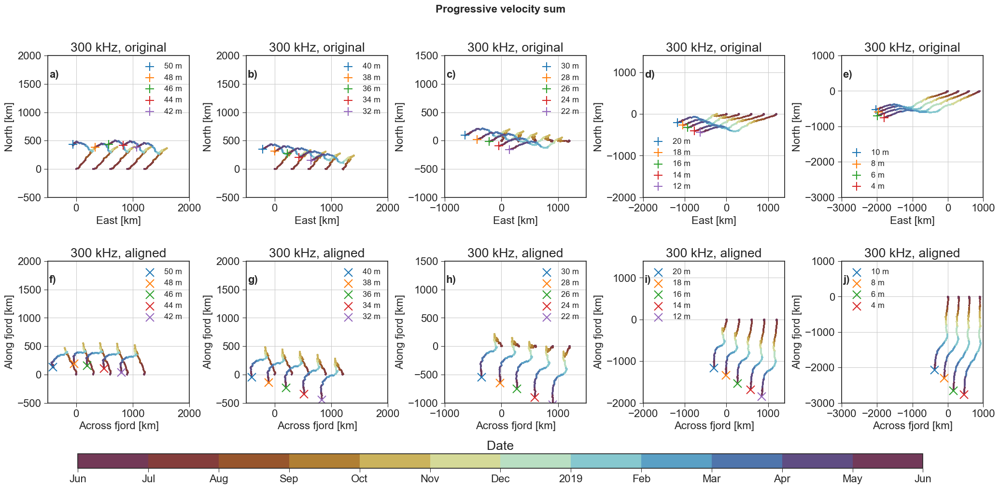

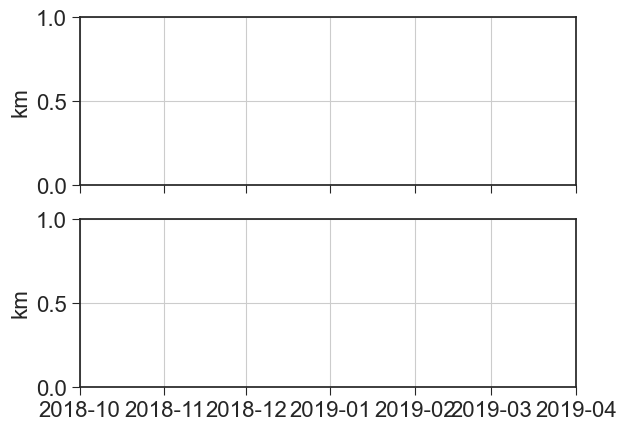

In [ ]:
figpathjohn = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Figures/for john june 13"

nseconds300 = (ds_velo_300.time[1]-ds_velo_300.time[0]).values/np.timedelta64(1, 's') # number of seconds between each measurement
nseconds75 = (ds_velo_75.time[1]-ds_velo_75.time[0]).values/np.timedelta64(1, 's')

# make all text fonts larger
plt.rcParams.update({'font.size': 16})



# make an array of every month in the dataset, one month in between
boundsdatetime = pd.date_range('2018-05-28','2019-06-13', freq='MS').strftime("%Y-%m-%d").tolist()
boundsdatenum = mdates.date2num(boundsdatetime)

plot_lower_or_upper = 300
if plot_lower_or_upper == 300:
    nrows, ncols = 2, 5
else:
    nrows, ncols = 2, 6
fig, ax = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))
figtime, axes = plt.subplots(2,1, sharex=True) 
norm = mpl.colors.Normalize(vmin=mdates.date2num(["2018-05-28"]), vmax=mdates.date2num(["2019-06-13"]))
cmap = ccm.cm.romaO
norm = mpl.colors.BoundaryNorm(boundsdatenum, cmap.N)
minz_75 = np.round(float(ds_velo_75.z.min()),1)
maxz_300 = np.round(float(ds_velo_300.z.max()),1)
ax_lims = []

counter =0

if plot_lower_or_upper == 300:
    ds_plot_z = ds_velo_300.z.values
else:
    ds_plot_z = ds_velo_75.z.values
for i,depths in enumerate(ds_plot_z):
    x300ave = (ds_velo_300.sel(z=slice(depths+8, depths-8))*nseconds300).mean(dim="z").cumsum(dim='time') /1e6
    x300fix =(ds_velo_300.sel(z=depths, method='nearest')*nseconds300).cumsum(dim='time')/1e6
    x75fix = (ds_velo_75.sel(z=depths, method='nearest')*nseconds75).cumsum(dim='time')/1e6
    actual_depth_300 =  np.round(float(x300fix.z),1)
    actual_depth_75 =  np.round(float(x75fix.z),1)
    x75fix["date"] = ds_velo_75.time
    x300fix["date"] = ds_velo_300.time



    shift_fact = 300   
    #east-north
    col_ind = int(np.floor(i/5))

    if plot_lower_or_upper == 300:
        ax[0,col_ind].scatter(x300fix.SerEmmpersec+i%5*shift_fact, x300fix.SerNmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=cmap, norm=norm, s=1)
        ax[0,col_ind].scatter(x300fix.SerEmmpersec[-1]+i%5*shift_fact, x300fix.SerNmmpersec[-1], marker='+', s=150, label=f"{actual_depth_300:.0f} m")
        # aligned
        sc = ax[1,col_ind].scatter(x300fix.Acrossmmpersec+i%5*shift_fact, x300fix.Alongmmpersec, c=mdates.date2num(ds_velo_300.time), cmap=cmap, norm=norm, s=1)
        ax[1,col_ind].scatter(x300fix.Acrossmmpersec[-1]+i%5*shift_fact, x300fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_300:.0f} m")


    else:  
        shift_fact = 200
        ax[0,col_ind].scatter(x75fix.SerEmmpersec+i%5*shift_fact, x75fix.SerNmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=cmap, norm=norm, s=1)
        ax[0,col_ind].scatter(x75fix.SerEmmpersec[-1]+i%5*shift_fact, x75fix.SerNmmpersec[-1], marker='+', s=150, label=f"{actual_depth_75:.0f} m")
        # aligned
        sc = ax[1,col_ind].scatter(x75fix.Acrossmmpersec+i%5*shift_fact, x75fix.Alongmmpersec, c=mdates.date2num(ds_velo_75.time), cmap=cmap, norm=norm, s=1)
        ax[1,col_ind].scatter(x75fix.Acrossmmpersec[-1]+i%5*shift_fact, x75fix.Alongmmpersec[-1], marker='x', s=150, label=f"{actual_depth_75:.0f} m")


    
    counter+=1

titles=["300 kHz, original", "75 kHz, original","300 kHz, aligned", "75 kHz, aligned"]
for i,ax_pvd in enumerate(ax.flatten()):
    ax_pvd.set_aspect(1, 'box') # ratio yaxis over xaxis
    ax_pvd.legend(loc = "best", fontsize=12)
    ax_pvd.grid(True)

for i in range(ncols):
    if plot_lower_or_upper == 300:
        ax[0,i].set_title(titles[0])
        ax[1,i].set_title(titles[2])
    else:
        ax[0,i].set_title(titles[1])
        ax[1,i].set_title(titles[3])       

letters = ['a)', 'b)', 'c)', 'd)', 'e)', 'f)', 'g)', 'h)', 'i)', 'j)', 'k)', 'l)', 'm)']
for i in range(nrows*ncols):
    ax.flatten()[i].text(0.01, 0.9, letters[i], transform=ax.flatten()[i].transAxes, fontsize=16, fontweight='bold', va='top')

for i in range(ncols):
    ax[1,i].set_xlabel("Across fjord [km]")
    ax[1,i].set_ylabel("Along fjord [km]")
    ax[0,i].set_xlabel("East [km]")
    ax[0,i].set_ylabel("North [km]")
fig.suptitle("Progressive velocity sum", fontsize=16, fontweight='bold')
lim = 2800
if plot_lower_or_upper == 300:
    axlims = [[-500,2000], [-500,2000], [-1000, 1500], [-2000, 1400], [-3000,1000]]
    axtickint = [500, 500, 500, 1000, 1000]
else:
    axlims = [[-200, 1100], [-200, 1100], [-200,1100], [-500, 1000], [-500, 1000], [-500, 1000]]
    axtickint = [500, 500, 500, 500, 500, 500]
for i in range(nrows):
    for k in range(ncols):
        single_ax = ax[i,k]
        single_ax.set_xlim(axlims[k])
        single_ax.set_ylim(axlims[k])
        # single_ax.set_xticks(np.arange(axlims[k][0], axlims[k][1], axtickint[k]))
        # single_ax.set_yticks(np.arange(axlims[k][0], axlims[k][1], axtickint[k]))

#colorbar for prog velocity sum
fig.subplots_adjust(bottom=0.15)
cbar_ax = fig.add_axes([ 0.15, 0.02, 0.7, 0.03, ])
cbar = fig.colorbar(sc,cax=cbar_ax, orientation='horizontal')
cbar.ax.set_title("Date")
loc = mdates.AutoDateLocator()
loc = mdates.MonthLocator(interval=1)
cbar.ax.xaxis.set_major_locator(loc)
cbar.ax.xaxis.set_major_formatter(mdates.ConciseDateFormatter(loc))
for ax in axes: 
    ax.grid(True)
    ax.set_ylabel("km")
handles, labels = axes[0].get_legend_handles_labels()
axes[1].legend(bbox_to_anchor=(1.0, 1), loc='upper left')
axes[1].set_xlim([datetime(2018, 10, 1), datetime(2019, 4, 1)])
fig.subplots_adjust(hspace=0.4, wspace=0.4)


fig.savefig(f"{figpathjohn}/PVD_{plot_lower_or_upper}.png", dpi=300, bbox_inches='tight')
# plt.show()


In [ ]:
xlims

(0.0, 1.0)

In [ ]:
# df_velo_both = xr.merge([ds_velo_300, ds_velo_75], join='outer')
figpathjohn = "/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Figures/for john june 13"
 
cumsum300 = (ds_velo_300*(ds_velo_300.time[1]-ds_velo_300.time[0]).values/np.timedelta64(1, 's')).cumsum(dim='time')/1e6  # in km
cumsum75 = (ds_velo_75*(ds_velo_75.time[1]-ds_velo_75.time[0]).values/np.timedelta64(1, 's')).cumsum(dim='time')/1e6  # in km
depths = 50
for depths in [34, 50,]:
    fig = plt.figure()
    plt.plot(cumsum300.Alongmmpersec.sel(z=depths, method='nearest') , cumsum300.Acrossmmpersec.sel(z=depths, method='nearest') , label=f"{ cumsum300.SerNmmpersec.sel(z=depths, method='nearest').z:.1f} m")
    plt.plot(cumsum75.Alongmmpersec.sel(z=depths, method='nearest') , cumsum75.Acrossmmpersec.sel(z=depths, method='nearest') , label=f"{ cumsum75.SerNmmpersec.sel(z=depths, method='nearest').z:.1f} m")

    plt.gca().set_aspect('equal', adjustable='box')
    plt.legend()
    plt.grid()
    plt.xlabel('East [km]')
    plt.ylabel('North [km]')
    fig.savefig(f"{figpathjohn}/velocity_vectors_{depths}m_along_across.png", dpi=300, bbox_inches='tight')

for depths in [34, 50,]:
    fig, (ax, ax2) = plt.subplots(2,1)
    ax.plot(ds_velo_300.time , cumsum300.Acrossmmpersec.sel(z=depths, method='nearest') , label="300 m")
    ax.plot(ds_velo_75.time , cumsum75.Acrossmmpersec.sel(z=depths, method='nearest') , label="75 m")
    ax.set_title(f'North at {depths} m')
    ax.legend()
    ax.set_ylabel('North [km]')
    ax2.plot(ds_velo_300.time , cumsum300.Alongmmpersec.sel(z=depths, method='nearest') , label="300 m")
    ax2.plot(ds_velo_75.time , cumsum75.Alongmmpersec.sel(z=depths, method='nearest') , label="75 m")
    ax2.set_ylabel('East [km]')
    ax2.set_title(f'East at {depths} m')
    plt.tight_layout()
    # fig.savefig(f"{figpathjohn}/velocity_vectors_{depths}m_timeseries.png", dpi=300, bbox_inches='tight')

NameError: name 'ds_velo_300' is not defined

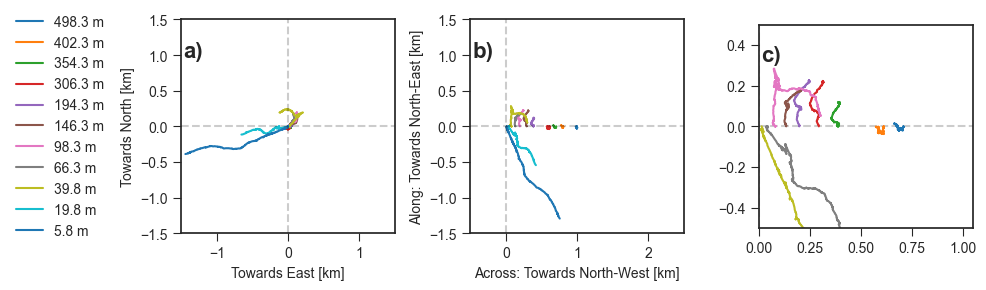

In [ ]:
# Cumulative sum of velocity vectors
# find mean per hour
depths = [500, 400,350, 300, 200, 150,100, 60, 40, 20, 5]

ds_cum_sum =  df_velo_both.sel(z=depths, method= 'nearest')/1e6 # mm/s to km/s
ds_cum_sum["time"] = ds_cum_sum.time.dt.round('H')
ds_cum_sum = ds_cum_sum.cumsum(dim='time')
fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(10,5), sharex=False, sharey=False)
for zlevel in ds_cum_sum.z:
    ax1.plot(ds_cum_sum.sel(z=zlevel).Alongmmpersec, ds_cum_sum.sel(z=zlevel).SerNmmpersec , label=f"{zlevel.values:.1f} m")
# ax1.legend()
for zlevel in ds_cum_sum.z:
    ax2.plot(ds_cum_sum.sel(z=zlevel).Acrossmmpersec+ zlevel.values/500 , ds_cum_sum.sel(z=zlevel).Alongmmpersec, label=f"{zlevel.values:.1f} m")
ax1.set_aspect('equal')
ax2.set_aspect('equal')
ax3.set_aspect('equal')
ax1.set_xlabel('Towards East [km]')
ax1.set_ylabel('Towards North [km]')
ax2.set_ylabel('Along: Towards North-East [km]')
ax2.set_xlabel('Across: Towards North-West [km]')
# add dashed line for 0
ax1.axhline(0, linestyle='--', color='k', alpha=0.2)
ax1.axvline(0, linestyle='--', color='k', alpha=0.2)
ax2.axhline(0, linestyle='--', color='k', alpha=0.2)
ax2.axvline(0, linestyle='--', color='k', alpha=0.2)
ax3.axhline(0, linestyle='--', color='k', alpha=0.2)
ax3.axvline(0, linestyle='--', color='k', alpha=0.2)
ax1.set_xlim(-1.5, 1.5)
ax2.set_ylim(-1.5, 1.5)
ax2.set_xlim(-.5, 2.5)
ax1.set_ylim(-1.5, 1.5)
ax3.set_xlim(0,1.05)
ax3.set_ylim(-0.5, 0.5)
for zlevel in ds_cum_sum.z[2:]:
    ax3.plot(ds_cum_sum.sel(z=zlevel).Acrossmmpersec+ zlevel.values/500 , ds_cum_sum.sel(z=zlevel).Alongmmpersec, label=f"{zlevel.values:.1f} m")
ax1.legend(bbox_to_anchor=(-0.3, .5), loc='center right')
plt.tight_layout()
# add a), b), c) etc. to subplots
axes = [ax1, ax2, ax3]
for i, label in enumerate(('a)', 'b)', 'c)')):

    axes[i].text(0.01, 0.9, label, transform=axes[i].transAxes, fontsize=16, fontweight='bold', va='top')

fig.savefig(f"{figpath}/velocity_surfer/Cumulative_sum_of_velo_vectors.png", dpi=300, bbox_inches='tight')

## Velocity vector animation

In [ ]:
import matplotlib.animation as animation
import ipywidgets as widgets


In [ ]:
dates

DatetimeIndex(['2019-01-01 00:00:00', '2019-01-01 03:00:00',
               '2019-01-01 06:00:00', '2019-01-01 09:00:00',
               '2019-01-01 12:00:00', '2019-01-01 15:00:00',
               '2019-01-01 18:00:00', '2019-01-01 21:00:00',
               '2019-01-02 00:00:00', '2019-01-02 03:00:00',
               ...
               '2019-01-28 21:00:00', '2019-01-29 00:00:00',
               '2019-01-29 03:00:00', '2019-01-29 06:00:00',
               '2019-01-29 09:00:00', '2019-01-29 12:00:00',
               '2019-01-29 15:00:00', '2019-01-29 18:00:00',
               '2019-01-29 21:00:00', '2019-01-30 00:00:00'],
              dtype='datetime64[ns]', length=233, freq='3H')

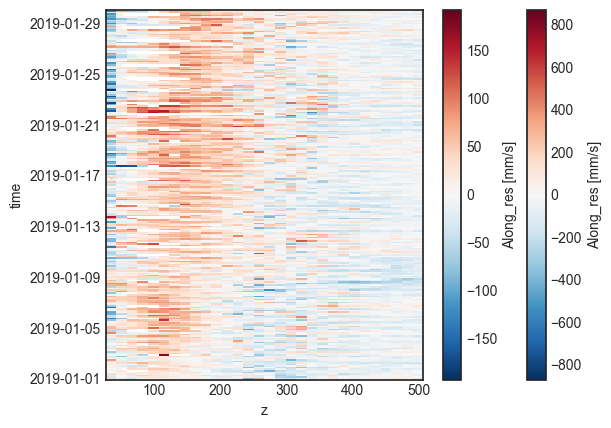

In [ ]:
dates = pd.date_range(start='2019-01-01', end='2019-01-30', freq='3H')
ds_velo_selected_dates = ds_velo_300.sel(time=dates, method='nearest')

fig, ax = plt.subplots(1,1)
ds_velo_300.sel(time=dates, method='nearest').Along_res.plot(ax =ax)
ds_velo_75.sel(time=dates, method='nearest').Along_res.plot(ax =ax)


In [ ]:
ds_velo_300.sel(time=slice('2019-01-01', '2019-01-30')).quantile(0.99)/1000

<xarray.Dataset>
Dimensions:         ()
Coordinates:
    quantile        float64 0.99
Data variables:
    SerEmmpersec    float64 0.1594
    SerNmmpersec    float64 0.224
    SerVmmpersec    float64 0.154
    SerErmmpersec   float64 0.226
    SerMagmmpersec  float64 0.473
    SerDir10thDeg   float64 3.543
    SerPG4          float64 0.1
    Alongmmpersec   float64 0.1611
    Acrossmmpersec  float64 0.2123
    Along_res       float64 0.1715
    Across_res      float64 0.2035

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/1669292039.py:14: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/1669292039.py:28: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/1669292039.py:69: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

MovieWriter Pillow unavailable; u

Image(value=b"GIF89a\x80\x02\xe0\x01\x87\x00\x00\xfd\xfd\xfd\xe8\xe8\xe9\xd7\xd7\xd7o\x01\xa7\xcb\xcb\xcc*'+1\…

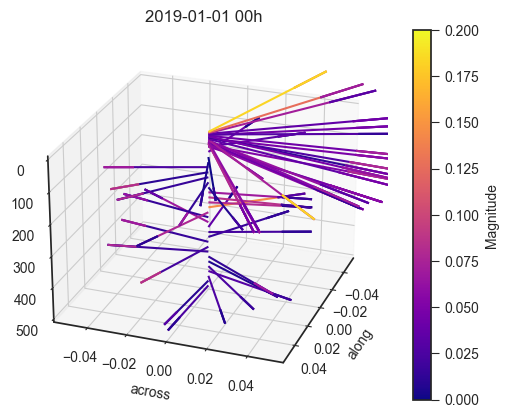

In [ ]:
import matplotlib.animation as animation
import ipywidgets as widgets
dates = pd.date_range(start='2019-01-01', end='2019-01-30', freq='1H')

# select 10 times in january 2019 with linspa
ds_velo_selected_dates = ds_velo_75.sel(time=dates, method='nearest') /1000
u = ds_velo_selected_dates.Along_res
v = ds_velo_selected_dates.Across_res
u300=ds_velo_300.Along_res.sel(time=d, method='nearest', tolerance='1H') /1000
v300=ds_velo_300.Across_res.sel(time=d, method='nearest', tolerance='1H') /1000
w = np.zeros_like(u.isel(time=0))
# Calculate the magnitude of the 3D vector
mag300 = np.sqrt(u300**2 + v300**2 + w300**2)
cmap = mpl.cm.get_cmap('plasma')
# Make color of arrows dependent on magnitude using the colormap

speed = ds_velo_selected_dates.SerMagmmpersec
x = np.zeros_like(z)
y = np.zeros_like(z)
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.axes.set_xlim3d(left=0.2, right=9.8) 
ax.axes.set_ylim3d(bottom=0.2, top=9.8) 
# ax.axes.set_zlim3d(bottom=0.2, top=9.8) 

# Define the range for the color bar (vmin and vmax)
cmap = mpl.cm.get_cmap('plasma')
vmin = 0  # Replace with your desired minimum value
vmax = 0.2 #m/s # Replace with your desired maximum value
# Normalize the magnitude data to the specified range (vmin to vmax)
norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)


def animate(i):
    ax.clear()
    ax.set_xlabel('along')
    ax.set_ylabel('across')
    ax.set_zlabel('z')
    d = dates[i]
    ax.set_title(d.strftime('%Y-%m-%d %Hh'))
    u300=ds_velo_300.Along_res.sel(time=d, method='nearest', tolerance='1H') /1000
    v300=ds_velo_300.Across_res.sel(time=d, method='nearest', tolerance='1H') /1000
    u=ds_velo_75.Along_res.sel(time=d, method='nearest', tolerance='1H') /1000
    v=ds_velo_75.Across_res.sel(time=d, method='nearest', tolerance='1H') /1000



    # Calculate the magnitude of the 3D vector
    mag300 = np.sqrt(u300**2 + v300**2)
    mag75 = np.sqrt(u**2 + v**2)
    # Normalize the magnitude data to the [0, 1] range for the colormap
    normalized_magnitude = norm(mag300)
    norm_mag75 = norm(mag75)
    colors_mag300 = cmap(normalized_magnitude)
    colors_mag75 = cmap(norm_mag75)


    ax.view_init(25, azim=20)
    ax.quiver(X=0, Y=0,Z=u300.z, U=u300, V=v300, W=0,  length=0.1, color=colors_mag300, norm=norm, normalize=True)
    ax.quiver(X=0, Y=0,Z=u.z, U=u, V=v, W=0,  length=0.05, color=colors_mag75, norm=norm, normalize=True)
    ax.set_zlim(500,0)

    return ax

# Add a color bar
sm = mpl.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array(mag300)
cbar = plt.colorbar(sm)
cbar.set_label('Magnitude')


anim = animation.FuncAnimation(fig, animate, frames=len(dates), interval=500, blit=False)

filename_gif= f'{figpath}/velocity animation/velocity_field_{dates[0].strftime("%Y-%m-%d %Hh")}_{dates[-1].strftime("%Y-%m-%d %Hh")}_n{len(dates)}_across_dir_view_normed.gif'
anim.save(filename_gif, writer='Pillow')


with open(filename_gif, "rb") as file:
    # read file as string into `image` 
    image = file.read()

widgets.Image(
    value=image,
    format='gif'
)


In [ ]:
mag300

<xarray.DataArray (z: 24)>
array([0.0530146 , 0.03295232, 0.00290028, 0.04372346, 0.02616479,
       0.02607588, 0.03675851, 0.03925935, 0.03691465, 0.05751225,
       0.03683767, 0.0437272 , 0.03230271, 0.08261226, 0.05962059,
       0.22734684, 0.14751622, 0.0137195 , 0.173297  , 0.09014996,
       0.05397845, 0.03294678, 0.28660973, 0.33668316])
Coordinates:
    time     datetime64[ns] 2019-01-01T11:56:00
  * z        (z) float64 49.79 47.79 45.79 43.79 41.79 ... 9.79 7.79 5.79 3.79

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/1960402535.py:7: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_57060/1960402535.py:37: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



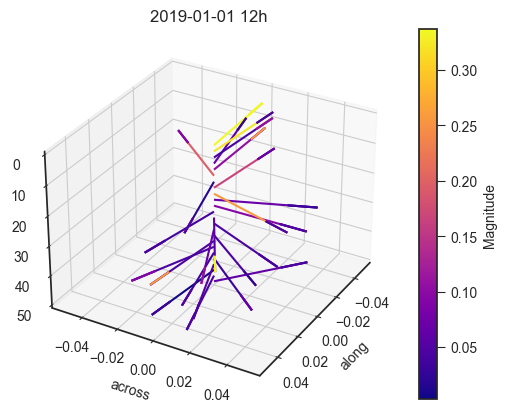

In [ ]:
d = pd.to_datetime('2019-01-01 12:00:00')
u300=ds_velo_300.Along_res.sel(time=d, method='nearest', tolerance='1H') /1000
v300=ds_velo_300.Across_res.sel(time=d, method='nearest', tolerance='1H') /1000
w300 = 0  # Assuming w300 is the Z-component of the vector and set to 0 based on your previous code


cmap = mpl.cm.get_cmap('plasma')
# Define the range for the color bar (vmin and vmax)
vmin = 0  # Replace with your desired minimum value
vmax = 0.3  # Replace with your desired maximum value
# Normalize the magnitude data to the specified range (vmin to vmax)
norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
# Calculate the magnitude of the 3D vector
mag300 = np.sqrt(u300**2 + v300**2 + w300**2)
# Normalize the magnitude data to the [0, 1] range for the colormap
normalized_magnitude = norm(mag300)
colors_mag = cmap(normalized_magnitude)


fig = plt.figure()
ax = fig.add_subplot(projection='3d')
# make color of arrows dependent on magnitude
ax.quiver(X=0, Y=0, Z=u300.z, U=u300, V=v300, W=0,  length=0.05, normalize=True, color=colors_mag, cmap='viridis_r', norm=norm)

ax.set_zlim(50, 0)
# ax.set_xlim(-0.2, 0.2)
# ax.set_ylim(-0.2, 0.2)
# add text 
ax.set_xlabel('along')
ax.set_ylabel('across')
ax.set_title(f"{d.strftime('%Y-%m-%d %Hh')}")
ax.view_init(elev=30, azim=30, roll=0)

# Add a color bar
sm = mpl.cm.ScalarMappable(cmap=cmap)
sm.set_array(mag300)
cbar = plt.colorbar(sm)
cbar.set_label('Magnitude')


# Heat flux

First plot resample it per day and plot on a gridm

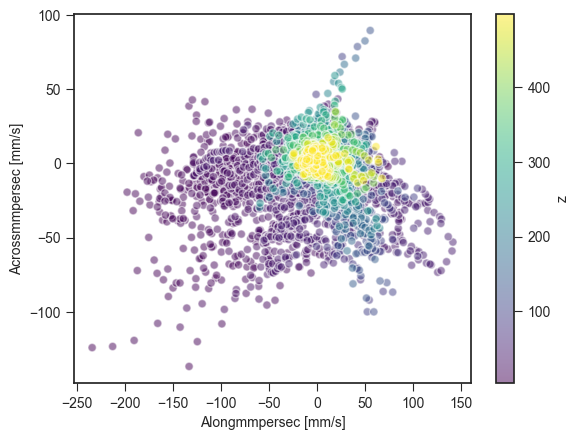

In [ ]:
df_velo_both.resample(time='5D').mean().plot.scatter(x='Alongmmpersec', y='Acrossmmpersec', hue='z', cmap='viridis', alpha=0.5)

In [ ]:
# calculate mean pressure per depth for df_mooring
df_mooring['Mean_pressure'] = df_mooring.groupby('depth').transform('mean')['Pressure [dbar]'].round(2)
df_gf10['datetime_first'] = df_gf10.groupby('Name').transform('first')['datetime']


/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_73725/2165534734.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df_mooring['Mean_pressure'] = df_mooring.groupby('depth').transform('mean')['Pressure [dbar]'].round(2)


In [ ]:
                                                             
df_ctd_moor = pd.concat([
    df_gf10.rename(columns={"date":"actual_date","datetime_first":"date",}).set_index(['Pressure [dbar]', 'date']), 
    df_mooring.rename(columns={"Mean_pressure":'Pressure [dbar]', 'Pressure [dbar]': 'Pres_ori'}).set_index(['Pressure [dbar]', 'date'])
    ])

# rename index in df_ctd_moor
df_ctd_moor = df_ctd_moor.rename_axis(index={'Pressure [dbar]': 'z', 'date': 'time'})
ds_ctd_moor = xr.DataArray.from_series(df_ctd_moor['temp'])
df_ctd_moor = df_ctd_moor.rename(columns={'time':'timetime'}).reset_index()


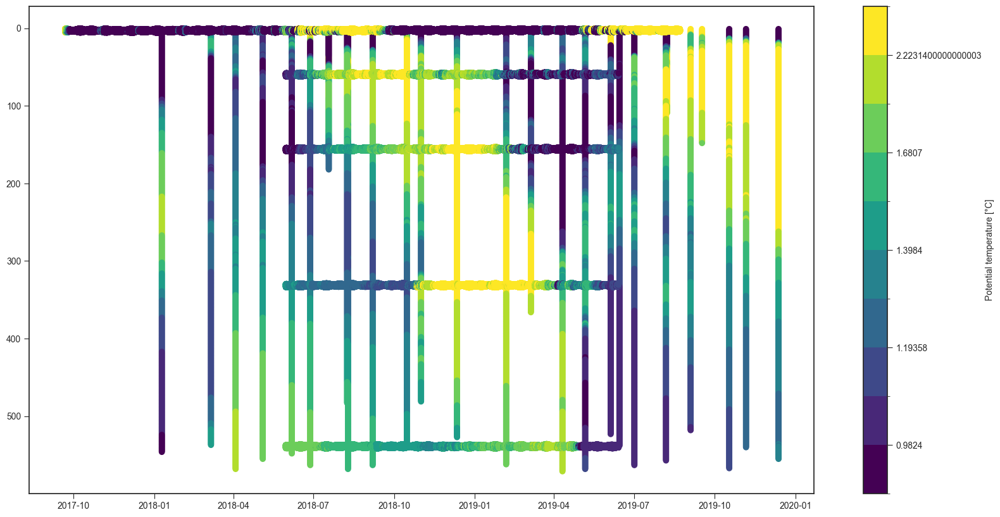

In [ ]:
fig, ax = plt.subplots(1,1, figsize=(20,10))
# create bounds for every tenth percentile
bounds = df_gf10['temp'].quantile(np.arange(0,1.1,0.1)).to_numpy()
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

cmap = mpl.cm.viridis
m = mpl.cm.ScalarMappable(norm=norm, cmap=cmap)
ax.scatter(df_gf10.date, df_gf10['Pressure [dbar]'], c=df_gf10['temp'], cmap=cmap, norm=norm)
ax.scatter(df_mooring.date, df_mooring['Pressure [dbar]'], c=df_mooring['temp'], cmap=cmap, norm=norm)
# add colorbar
cbar = fig.colorbar(m, ax=ax)
# add labels for every step
cbar.ax.set_yticklabels(bounds)
cbar.ax.set_ylabel('Potential temperature [°C]')
ax.invert_yaxis()
fig.savefig(f"{figpath}/temp/temp_timeseries_casts.png", dpi=600, bbox_inches='tight')

In [ ]:
# make a grid of all depths of velocity and all times of mooring and ctd
# multiply for heat flux
# compare that to mean per day and mean per 10 m 

zvals = df_velo_both.z.to_numpy()
# zvals
timevals = df_mooring[df_mooring.depth == 540].date.to_numpy()

In [ ]:
# ds_ctd_moor time dimesion in seconds 
time_seconds = pd.to_timedelta(ds_ctd_moor.time - ds_ctd_moor.time[0], unit='s').total_seconds().to_numpy()
time_hours =  time_seconds/3600
time_days = time_hours/24
time_datetime  = ds_ctd_moor.time.values



Text(0.5, 1.0, 'Interpolated - seconds as a unit')

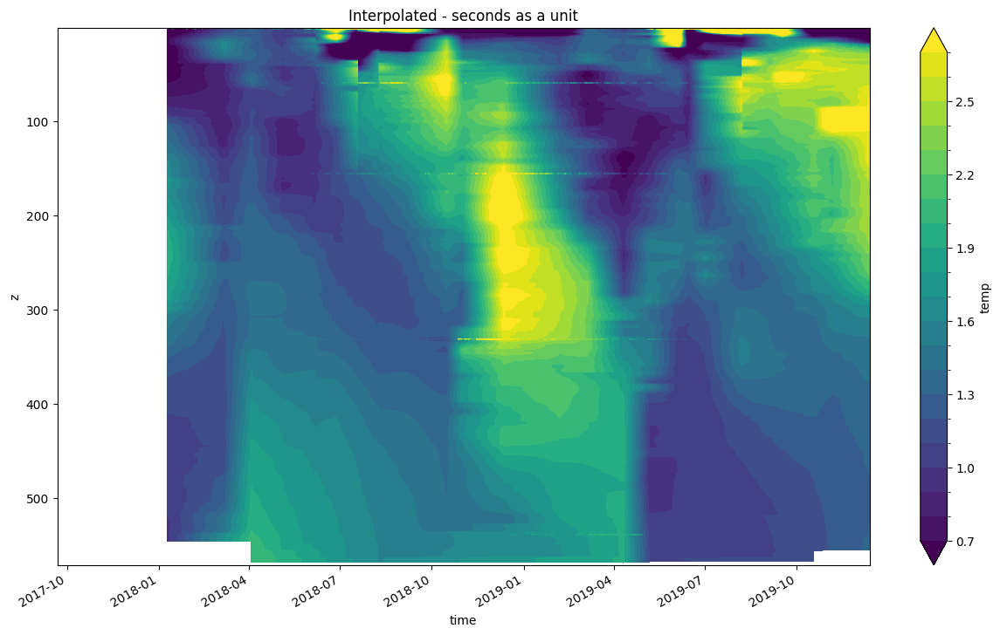

In [ ]:
ds_ctd_moor['time'] = time_seconds
ds_ctd_moor_no_na = ds_ctd_moor.interpolate_na(dim='time', method='linear')
ds_ctd_moor['time'] = time_datetime
ds_ctd_moor_no_na['time'] = time_datetime
fig, ax = plt.subplots(1,1, figsize=(15,8))
cf = ds_ctd_moor_no_na.plot.contourf(robust=True, ax=ax, levels=20)
# ax.scatter(df_gf10.date, df_gf10['Pressure [dbar]'])
# ax.scatter(df_mooring.date, df_mooring['Pressure [dbar]'])
ax.invert_yaxis()
# set title 
ax.set_title('Interpolated - seconds as a unit')

Text(0.5, 1.0, 'Interpolated - 10 day as a unit')

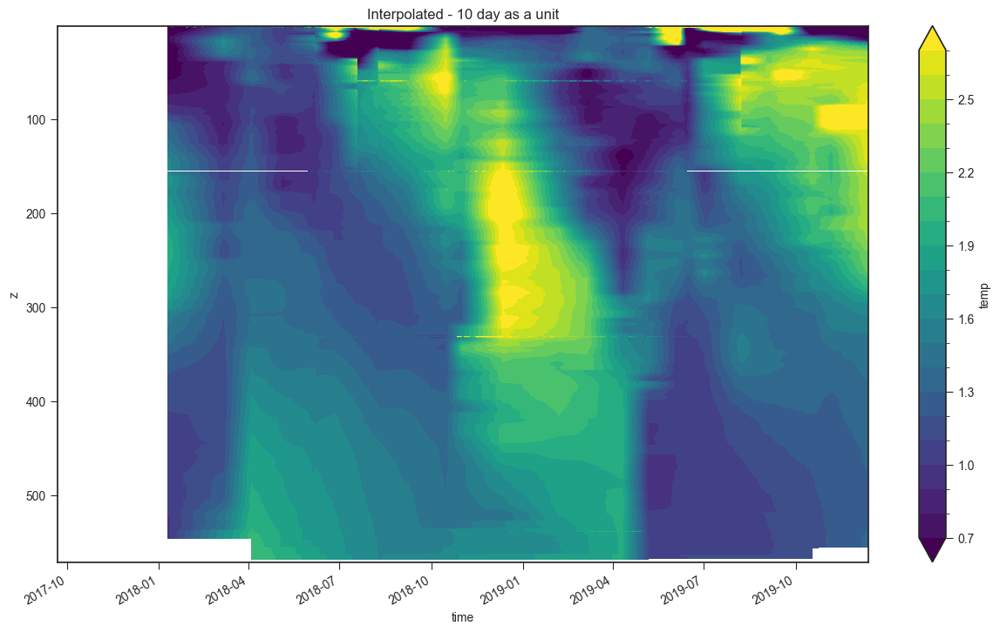

In [ ]:
ds_ctd_moor['time'] = time_days/10
# Perform interpolation using 'linear' method
ds_ctd_moor_no_na_10 = ds_ctd_moor.interpolate_na(dim='time', method='linear')
ds_ctd_moor['time'] = time_datetime
ds_ctd_moor_no_na_10['time'] = time_datetime
fig, ax = plt.subplots(1,1, figsize=(15,8))
cf = ds_ctd_moor_no_na_10.plot.contourf(robust=True, ax=ax, levels=20)
# ax.scatter(df_gf10.date, df_gf10['Pressure [dbar]'])
# ax.scatter(df_mooring.date, df_mooring['Pressure [dbar]'])
ax.invert_yaxis()
# set title 
ax.set_title('Interpolated - 10 day as a unit')


In [ ]:
import scipy.interpolate as interp
zvals_ctd = ds_ctd_moor.z.to_numpy()
interp = interp.RegularGridInterpolator((zvals_ctd, time_seconds), ds_ctd_moor.values, method='linear', bounds_error=False, fill_value=None)
xg, yg = np.meshgrid(time_seconds, zvals_ctd)
data_interp_seconds = interp((xg, yg))

NameError: name 'ds_ctd_moor' is not defined

In [ ]:
# zi = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')
df_ctd_moor = df_ctd_moor.set_index('time', 'z').sort_index().reset_index()
print(var)
df_ctd_moor['sal'].sort_index(inplace=True)
xi = time_seconds
yi = zvals_ctd
# convert xi to datetime
# xi_date = decimal_day_to_datetime(xi)
# Filter out NaN values from var column
valid_indices = ~np.isnan(df_ctd_moor[var].to_numpy())
points = (pd.to_timedelta(df_ctd_moor.time - df_ctd_moor.time[0], unit='s').dt.total_seconds().to_numpy()[valid_indices]
    , df_ctd_moor['z'].to_numpy()[valid_indices])
points_hours = (pd.to_timedelta(df_ctd_moor.time - df_ctd_moor.time[0], unit='s').dt.total_seconds().to_numpy()[valid_indices]/3600., 
    df_ctd_moor['z'].to_numpy()[valid_indices])
values = df_ctd_moor[var].to_numpy()[valid_indices]
zi_seconds = griddata(points, values, (xi[None, :], yi[:, None]), method='linear')
# zi_hours = griddata(points_hours, values, (xi[None, :], yi[:, None]), method='linear')
# griddata((zvals_ctd, time_seconds), ds_ctd_moor.values, (xg, yg), method='linear')



/var/folders/cv/s_h5gzxd0h71t_d875wqxgzh0000gn/T/ipykernel_73725/605192560.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.set_index except for the argument 'keys' will be keyword-only.
  df_ctd_moor = df_ctd_moor.set_index('time', 'z').sort_index().reset_index()


temp


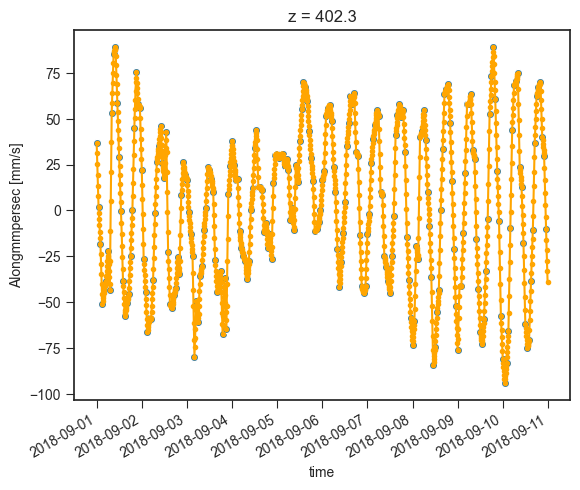

In [ ]:
# df_velo_both_high_freq = df_velo_both.interp(time=timevals, method='linear')

df_velo_both_high_freq = xr.merge([
    ds_velo_75.interp(time=timevals, method='linear'),
    ds_velo_300.interp(time=timevals, method='linear'),
      ], join='outer')

# plot df_velo_both and df_velo_both_high_freq for several depths

df_velo_both_high_freq.Alongmmpersec.sel(z=400, method='nearest').sel( time=slice('2018-09-01', '2018-09-10'),).dropna('time').plot(color='orange', marker='.', linestyle='-')
df_velo_both.Alongmmpersec.sel(z=400, method='nearest').sel( time=slice('2018-09-01', '2018-09-10'),).dropna('time').plot.scatter()



In [ ]:
ds_ctd_like_velo = ds_ctd_moor_no_na_10.interp_like(df_velo_both_high_freq, method='linear')
ds_ctd_like_velo = ds_ctd_like_velo-ds_ctd_like_velo.min().values  # relative temperature
ds_heat_flux = ds_ctd_like_velo*df_velo_both_high_freq.Alongmmpersec

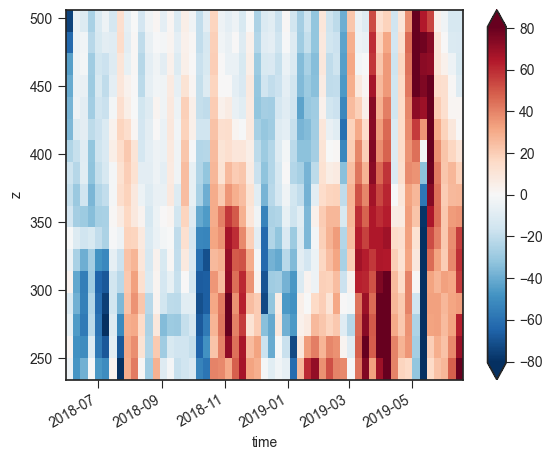

In [ ]:
ds_heat_flux.sel(z=slice(230,500)).resample(time='1W').mean().plot(robust=True)

In [ ]:
# ds_heat_flux.sel(z=slice(300,500)).sum('z').plot()
# group by week
# ds_heat_flux.sel(z=slice(230,500)).sum('z').resample(time='1W').mean().plot()

In [ ]:

data = ds_ctd_moor.values
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection='3d')
ax.scatter(xg.ravel(), yg.ravel(), data.ravel(),
            c='k', label='data')
# interpolator
# ax.plot_wireframe(xg, yg, interp((xg, yg)), rstride=3, cstride=3,
#                   alpha=0.4, color='m', label='linear interp')

NameError: name 'ds_ctd_moor' is not defined

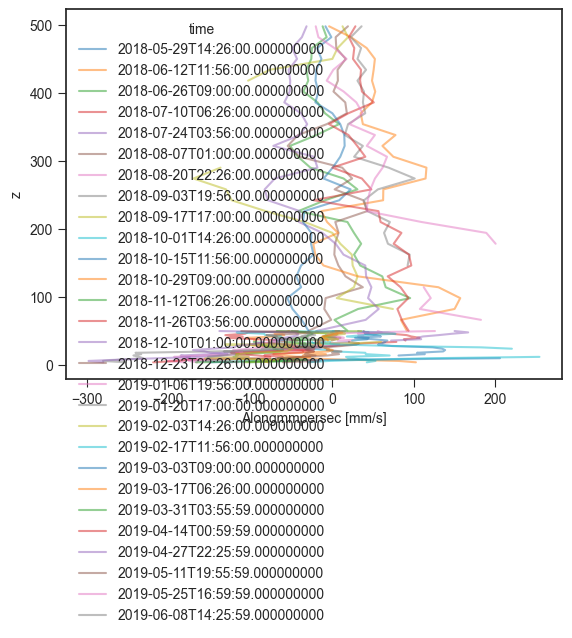

In [ ]:
df_velo_both.sel(time=df_velo_both.time[::1000])['Alongmmpersec'].plot.line( y='z', hue='time', alpha=0.5)


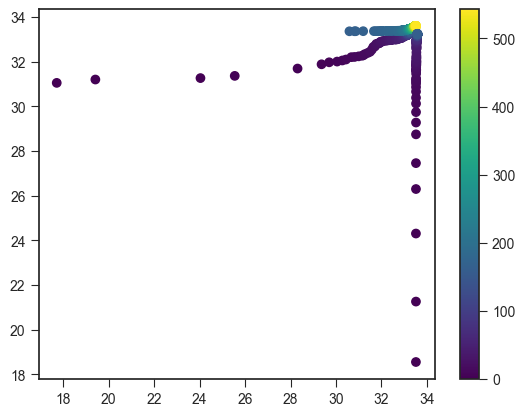

In [ ]:
plt.scatter( df_ctd_moor[df_ctd_moor.index.duplicated(keep='first')]['sal'], df_ctd_moor[df_ctd_moor.index.duplicated(keep='last')]['sal'], c=df_ctd_moor[df_ctd_moor.index.duplicated(keep='last')]['index'], cmap='viridis')
plt.colorbar()

ModuleNotFoundError: No module named 'mpl_toolkits.axes_grid'

In [ ]:
ds_nia1819 = xr.open_dataset("/Users/annek/Library/CloudStorage/OneDrive-SharedLibraries-NIOZ/PhD Anneke Vries - General/Data/Weather data/Nia/nia_arno/nia1819.nc", engine="netcdf4")
from metpy.calc import wind_components
from metpy.units import units

u, v = wind_components(ds_nia1819['WS_200cm'] * units('m/s'), ds_nia1819['WD_200cm'] * units('deg'))
ds_nia1819['U_200cm'] = u
ds_nia1819['V_200cm'] = v


In [ ]:
u_upper_10 = (ds_velo_300['Alongmmpersec'].sel(z=slice(10,0)).mean('z')/1000).dropna('time')

In [ ]:
u200 = ds_nia1819['U_200cm'].sel(time=slice('2018-07-01', '2019-07-01')).dropna('time').interp_like(u_upper_10, method='linear')

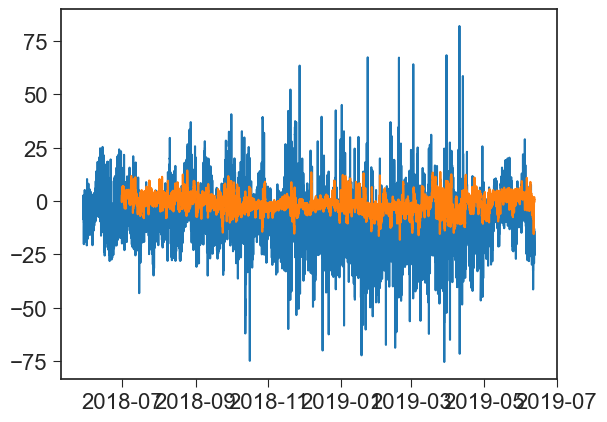

In [ ]:
plt.plot(u_upper_10.time, u_upper_10*100, label = 'u_ocean_upper_10[cm/s]')
plt.plot(u200.time, u200, label = 'u_air_200cm [m/s]')

In [ ]:
import xarray as xr
import numpy as np
from scipy.stats import pearsonr

def correlate_and_get_pvalue(dataset, var1_name, var2_name):
    """
    Compute the correlation coefficient and p-value between two variables in an xarray dataset.

    Parameters:
        dataset (xarray.Dataset): The xarray dataset containing the variables of interest.
        var1_name (str): Name of the first variable.
        var2_name (str): Name of the second variable.

    Returns:
        corr_coef (float): Pearson correlation coefficient.
        p_value (float): Two-tailed p-value.
    """
    # Extract the variables from the dataset
    var1 = dataset[var1_name]
    var2 = dataset[var2_name]

    # Ensure that the variables have the same dimensions
    if var1.shape != var2.shape:
        raise ValueError("Variables must have the same dimensions for correlation.")

    # Flatten the variables into 1D arrays
    var1_flat = var1.values.flatten()
    var2_flat = var2.values.flatten()

    # Compute the correlation coefficient and p-value
    corr_coef, p_value = pearsonr(var1_flat, var2_flat)

    return corr_coef, p_value


In [ ]:
ds_both = xr.merge([u_upper_10, u200]).dropna('time', how='any')
xr.corr(ds_both['Alongmmpersec'], ds_both['U_200cm'])

correlate_and_get_pvalue(ds_both, 'Alongmmpersec', 'U_200cm')


(0.15292729315608983, 3.075208422188873e-84)

(-0.10987018531397458, 1.632934292907371e-05)

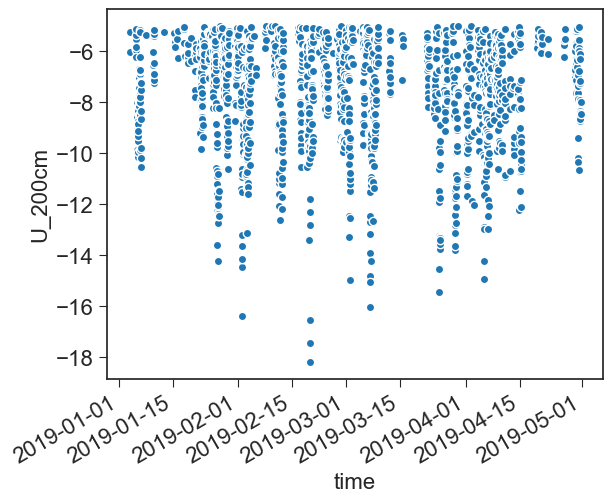

In [ ]:
mask = (ds_both['U_200cm']<-5 )& ds_both.time.dt.month.isin([1,2,3,4,])
ds_both['U_200cm'].where(mask).plot.scatter()
len(ds_both['U_200cm'].where(mask).dropna('time'))
correlate_and_get_pvalue(ds_both.where(mask).dropna('time', how='any'), 'Alongmmpersec', 'U_200cm')

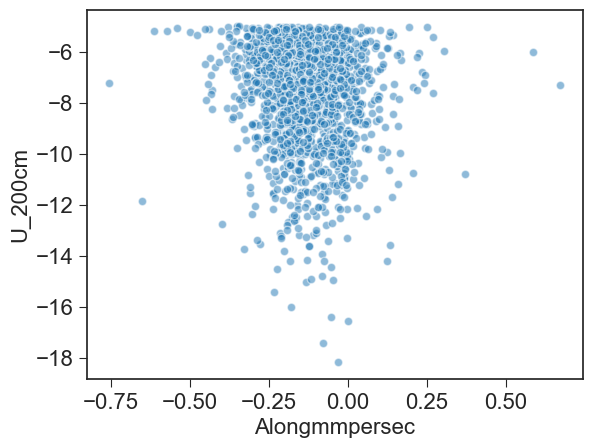

In [ ]:
ds_both.where(mask).plot.scatter(x='Alongmmpersec', y='U_200cm', alpha=0.5)